In [70]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import Voronoi, voronoi_plot_2d

En primera instancia se genera el código con el que se simulará la ciudad multinúcleo. Para ello, se utilizará una región determinada por el cuadrado: $[-100,100]^2$. En dicha zona se tendrán "comunas" centradas en las esquinas del cuadrado $[-40,40]^2$, en las que cada punto representa una casa, además habrá una distribución uniforme de casas esparcida en el cuadrado inicial, de forma de tener una especie de "casas de ruido" que no tienen porque pertenecer estrictamente a las comunas. Como el modelo de ciudad ocupado es el multinúcleo, se debe tener que cada "comuna" tenga en su centro puntos de interés (servicios o trabajos) y al mismo tiempo, en el centro de todo el esquema se acumulen aún más puntos de interés.

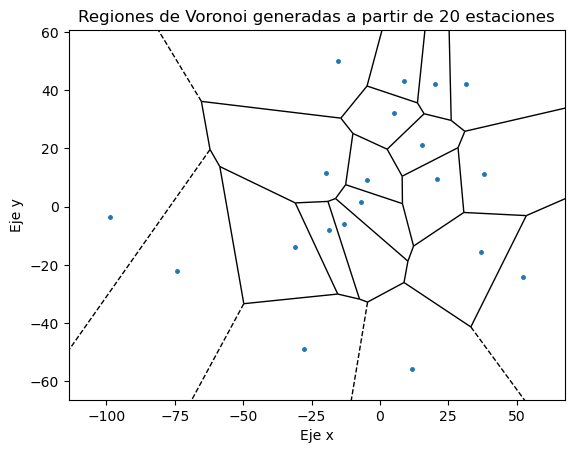

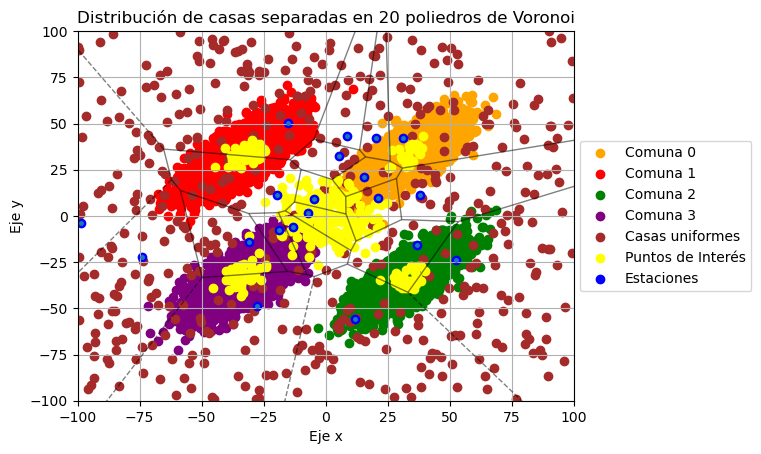

In [71]:
def inicializar_estaciones(N, xlim=100, ylim=100): #Esta función se diseña para distribuir las estaciones iniciales y
    #generar las regiones voronoi correspondientes
    angulo = 2 * np.pi / N
    coordenadas_x = [np.cos(i * angulo) for i in range(N)]
    coordenadas_y = [np.sin(i * angulo) for i in range(N)] #Se inician a partir de un polígono de N lados
    p = np.random.normal(0, 40, 2 * N) #Y luego se desplazarán siguiendo una normal(0,40).

    points = []
    
    for i in range(N):
        x_coord = coordenadas_x[i] + p[i] #Desplazamos la primera coordenada según dicha normal,
        y_coord = coordenadas_y[i] + p[N + i] #Y la segunda.

        # Ajustamos las coordenadas para que estén dentro del cuadrado:
        x_coord = max(min(x_coord, xlim), -xlim)
        y_coord = max(min(y_coord, ylim), -ylim)

        points.append([x_coord, y_coord]) #Se agregan los puntos.

    points = np.array(points)
    return points



N = 20

def inicializar_personas(mu,sig,n): #Cada comuna (conjunto de casas) se genera mediante una normal
  ciud = np.random.multivariate_normal(mu,sig,n) #multivariada.
  return ciud

def generar_comunas(xlim = 100,ylim = 100): #Esta función generará las comunas y sus respectivos puntos de interes.
    
  ciud_tot = []
  mus = [[xlim/3,ylim/3],[-xlim/3,ylim/3],[xlim/3,-ylim/3],[-xlim/3,-ylim/3]] #Los mus son de forma que las ciudades
  sig = [[xlim,3/4 * xlim],[3/4 * ylim, ylim]] #estén centradas en las esquinas de un cuadrado contenido en el inicial.
  sig_interes = [[xlim*0.2,xlim*0.1],[ylim*0.1,ylim*0.2]] #Parámetros para los puntos de interés.
  puntos_de_interes = []

  for j in range(4):
    numero = np.random.randint(100,10000) #El número de casas que tendrá cada comuna es aleatorio.
    numero = int(numero)
    numerointeres = int(np.floor(numero/100)) #El número de puntos de interés fue creado de forma de ser menor a las casas.
    ciud = inicializar_personas(mus[j],sig,numero)
    ciud_tot.append(ciud)
    interes = inicializar_personas(mus[j],sig_interes,numerointeres)
    puntos_de_interes.append(interes)
    
  interes = inicializar_personas([0,0],[[xlim,xlim*0.1],[ylim*0.1,ylim]],200) #Los puntos de interés centrales.
  puntos_de_interes.append(interes)
  x_5 = np.random.uniform(-100,100,500)
  y_5 = np.random.uniform(-100,100,500)
  ciud_5_ruido = np.array([[x_5[i],y_5[i]] for i in range(len(x_5))]) #Las casas distribuidas uniformemente.
  ciud_tot.append(ciud_5_ruido)
    
  return ciud_tot,puntos_de_interes


ciud_tot,puntos_de_interes = generar_comunas()

est = inicializar_estaciones(N)

vor = Voronoi(est) #Esto generará los diagramas de Voronoi.
fig = voronoi_plot_2d(vor,show_vertices=False,point_size=5)
plt.title(f'Regiones de Voronoi generadas a partir de {N} estaciones')
plt.xlabel('Eje x')
plt.ylabel('Eje y')

def graficar_todo(vor, ciud_tot, puntos_de_interes):
    est = vor.points
    fig, ax = plt.subplots()

    colores_ciudades = ['orange', 'red', 'green', 'purple', 'brown'] #Se busca que las comunas sean de estos colores.

    for i in range(len(ciud_tot)):
        ciud = ciud_tot[i]
        if i == len(ciud_tot) - 1:
            ax.scatter(ciud[:, 0], ciud[:, 1], color='brown', label='Casas uniformes')
        else:
            ax.scatter(ciud[:, 0], ciud[:, 1], color=colores_ciudades[i], label=f'Comuna {i}') #Se grafican las comunas.

    for j in range(len(puntos_de_interes)): #Se grafican los puntos de interés.
        interes = puntos_de_interes[j]
        if j == len(puntos_de_interes) - 1:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow', label='Puntos de Interés')
        else:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow')

    ax.scatter(est[:, 0], est[:, 1], color='blue', label='Estaciones') #Se grafican las estaciones.

    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='black', line_width=1, line_alpha=0.5, point_size=5) 
    #Se grafican las regiones de voronoi.

    plt.xlim(-100, 100)
    plt.ylim(-100, 100)
    plt.grid(True)

    lgd = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.title(f'Distribución de casas separadas en {N} poliedros de Voronoi')
    plt.xlabel('Eje x')
    plt.ylabel('Eje y')
    plt.show()

graficar_todo(vor, ciud_tot, puntos_de_interes)

Tras esto, se crea una función que calcule las áreas de las regiones de voronoi, lo que será importante para calcular la función objetivo. Aca es importante tener en cuenta que una región de voronoi debe estar determinada por al menos 3 "esquinas" para tener un área distinta de 0.

In [72]:
def areaf(vor, index): #Tomaremos el conjunto de voronois y un índice en particular que representa la región
    #a la cual le calcularemos el área.

    region_vertices = vor.regions[index]

    region_vertices = [idx for idx in region_vertices if idx >= 0 and idx < len(vor.vertices)] #Filtramos los índices
    #para que estén dentro del rango de los vértices del voronoi.
    region_vertices = list(set(region_vertices))  #eliminamos los duplicados.

    region_coordinates = vor.vertices[region_vertices] #Obtenemos las coordenadas de los vértices.

    if len(region_coordinates) < 3: #Si los vértices son menores a 3 el área es 0.
        return 0

    area = 0.5 * np.abs(np.dot(region_coordinates[:, 0], np.roll(region_coordinates[:, 1], 1)) -
                       np.dot(region_coordinates[:, 1], np.roll(region_coordinates[:, 0], 1))) #Si no, calculamos el área

    return area


Se definen las funciones anteobjetivo1 y anteobjetivo2, además de la función objetivo:


$$\sum_{i=1}^{n} \frac{10 \cdot n_{\text{casas}i}+50\cdot n_{\text{interes}i}}{A_i}$$

Donde el índice representa la región de Voronoi $i$, $n_{\text{casas}}$ y $n_{\text{interés}}$ representan el número de casas y de puntos de interés respectivamente.

In [73]:
def anteobjetivo(voronois,ciudades):
  contadores_por_region=[]

  for point_set in ciud_tot: #Exploramos todas las comunas.
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set] #Esto determina
      index=0 #qué puntos pertenecen a alguna región en particular, no se especifíca cuál es cada punto 
        #(sin embargo se hace en orden), pero cada región se repetirá por cada casa que haya en ella.
        
      for region_index in regions: #Explorando regions el region_index indica una casa en dicha región.
          index=region_index
          dato=[10,index] #Utilizamos que cada casa vale 10.
          contadores_por_region.append(dato)
            
  return contadores_por_region

def anteobjetivo2(voronois,puntos_de_interes):
  contadores_por_region=[]

  for  point_set in puntos_de_interes:
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set]
      index=0
        
      for region_index in regions:
          index=region_index
          dato=[50,index] #Es ánalogo al anterior, pero los puntos de interés valen 50.
          contadores_por_region.append(dato)
            
  return contadores_por_region


def objetivo(voronoi, ciudades, puntos_de_interes): #función objetivo.
    
    cont = anteobjetivo(voronoi, ciudades)
    cont_interes = anteobjetivo2(voronoi,puntos_de_interes) #Se obtienen los datos de las funciones anteriores.
    valores = []
    
    for i, region in enumerate(voronoi.regions):
        area = areaf(voronoi, i) #Calculamos el área de cada región

        if area > 0:  #Verificamos si el área es mayor que cero para evitar divisiones por cero
            valores_k = [dato[0] for dato in cont if i == dato[1]] #Por cada región hacemos listas con los respectivos valores
            valores_interes = [dato[0] for dato in cont_interes if i == dato[1]] #que tendrá en su interior.
            valor_final = sum(valores_k) / (area)**2 + sum(valores_interes) / (area)**2 #La fórmula de la función objetivo
            #el 10 y el 50 que multiplican fueron considerados antes.
            valores.append(valor_final)

    total = sum(valores) #Se entrega la sumatoria de los valores calculados.
    return total


Ahora, una prueba con la distribución inicial:

In [74]:
print(objetivo(vor,ciud_tot,puntos_de_interes))

409.30375399813903


Se fija la semilla:

In [75]:
#para testear
semilla = 42

Y se procede a utilizar el método de Metropolis-Hastings para obtener la mejor distribución, para ello es importante notar que debemos maximizar la función objetivo y que un nuevo estado se generará de la siguiente forma: consideraremos un punto aleatorio de los que determinan las regiones de Voronoi, luego perturbaremos dicho punto mediante una variable normal de media 0 y varianza 10, teniendo cuidado con que el punto se salga del cuadrado $[-100,100]^2$ o con que dos estaciones queden muy cerca, en ambos casos se deja el punto original sin modificar.

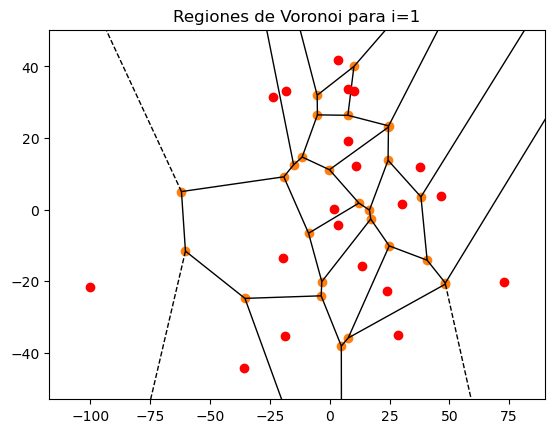

1 0
826.4325168836345 0


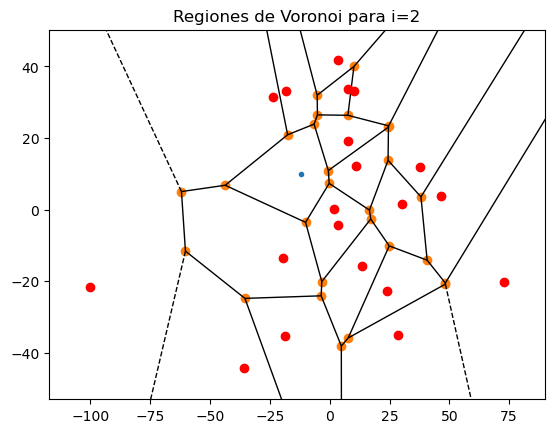

0.031210069744195382 1


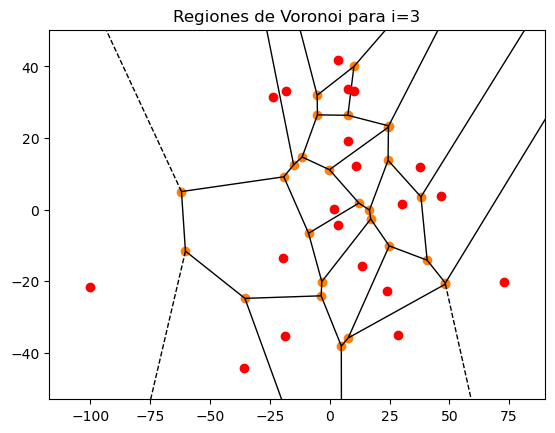

1 2
826.4325168836345 1


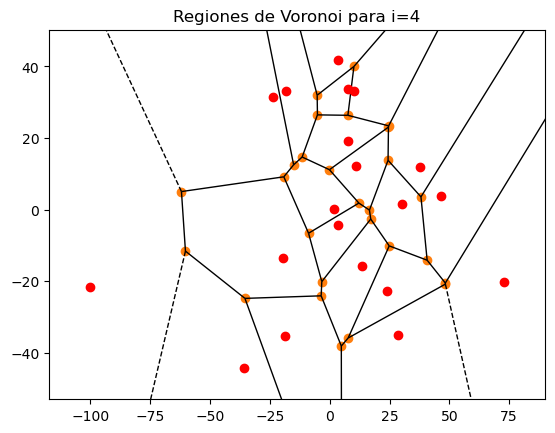

1 3
826.4325168836345 2


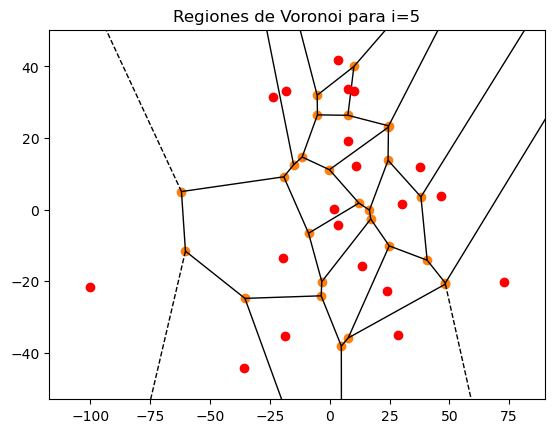

1 4
826.4325168836345 3


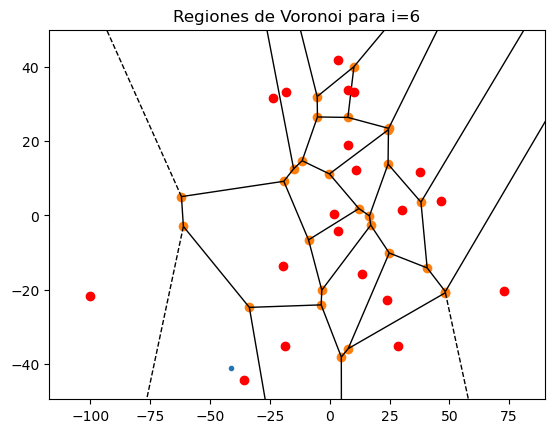

0.9719096880971204 5
803.2177697176915 4


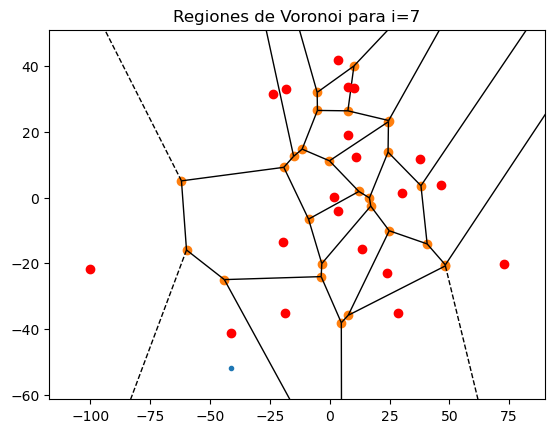

0.019109228152575163 6


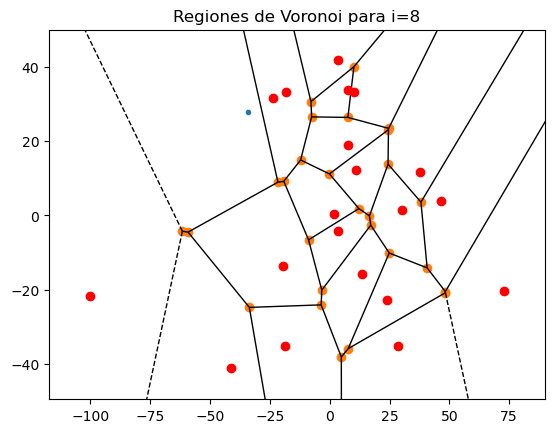

0.0020201470979164735 7


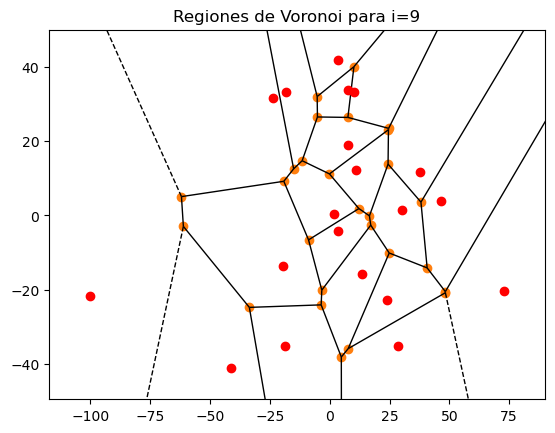

1 8
803.2179725218983 5


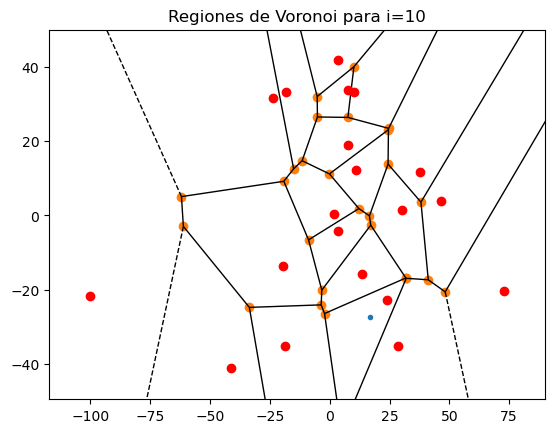

0.9997840971280146 9
803.0445554548006 6


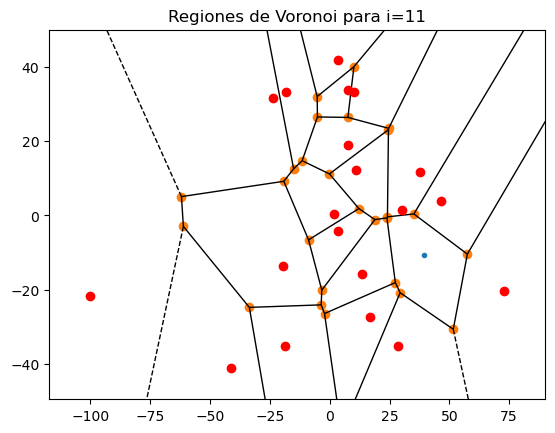

0.16737974757787374 10


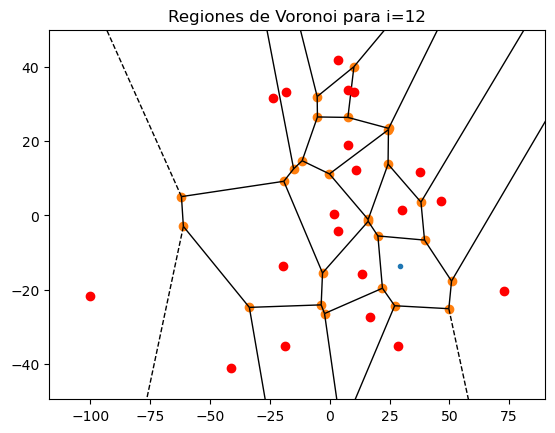

0.004066080486536635 11


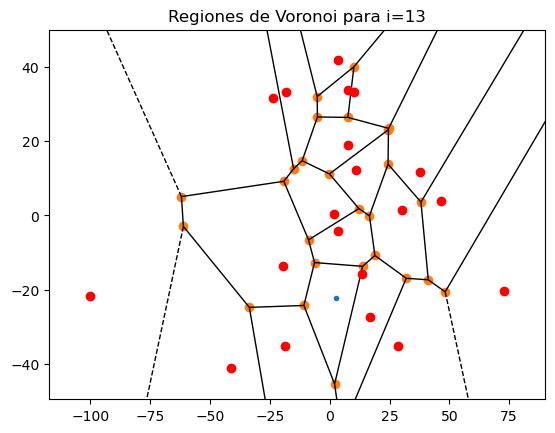

0.40217676891611714 12
322.96586460849136 7


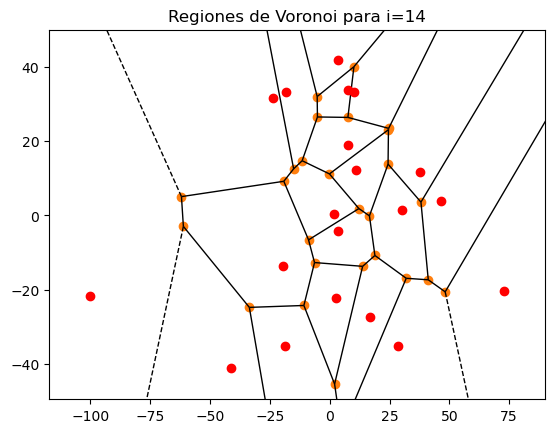

0.43106610925085176 13
139.21963867761974 8


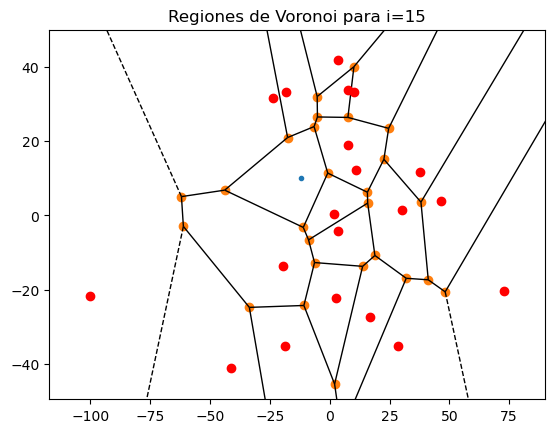

0.01839516160186287 14


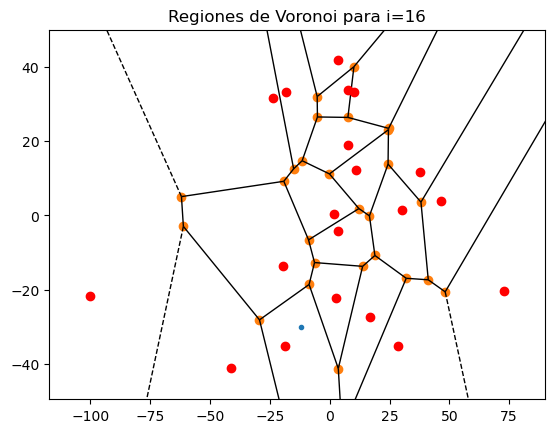

0.012393373425264162 15


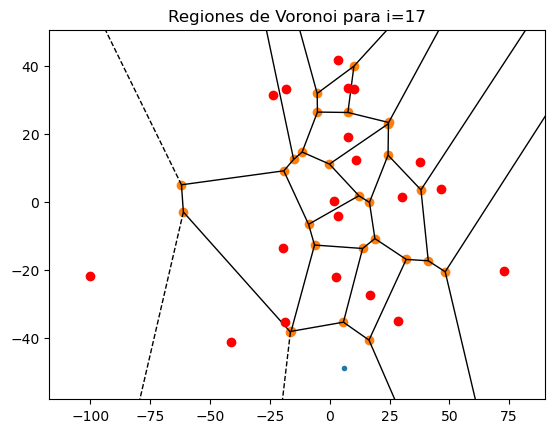

0.758649115545621 16
105.61885574935714 9


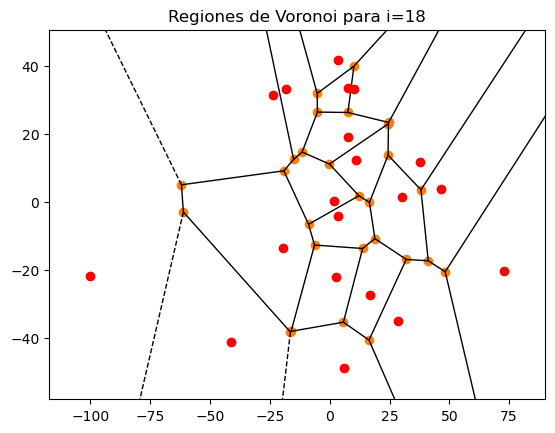

0.6291849826700101 17


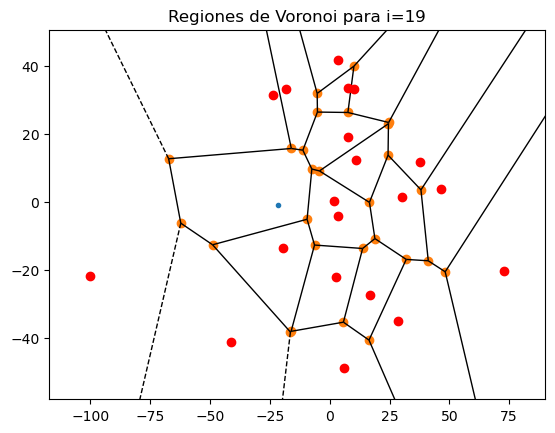

1 18
175695.04218404548 10


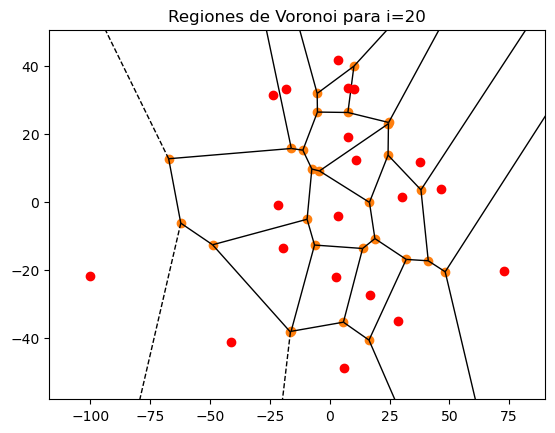

0.032801601252751444 19


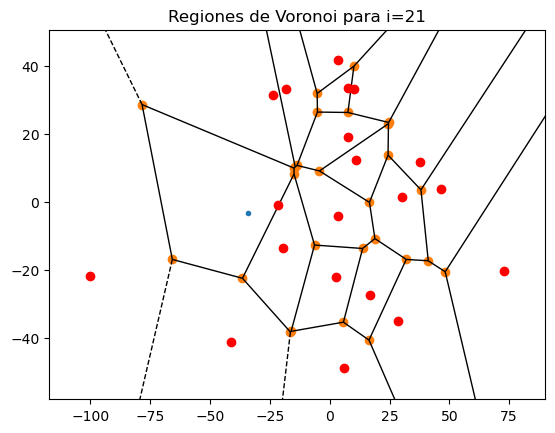

0.0003288558358583172 20


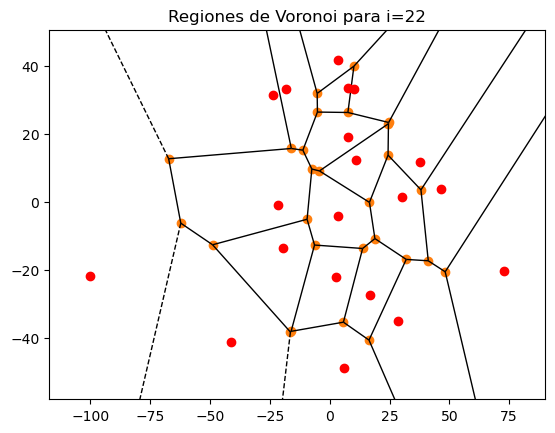

0.032801601252751444 21


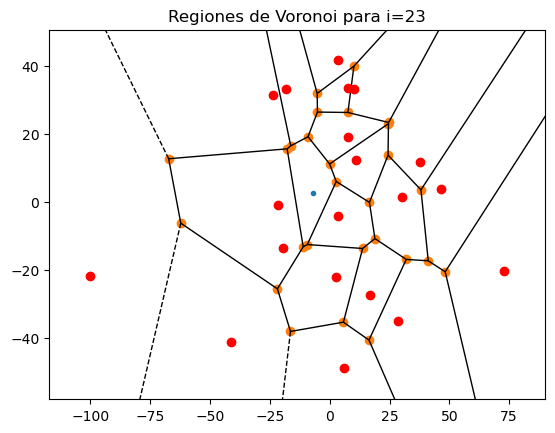

0.006949506280376556 22


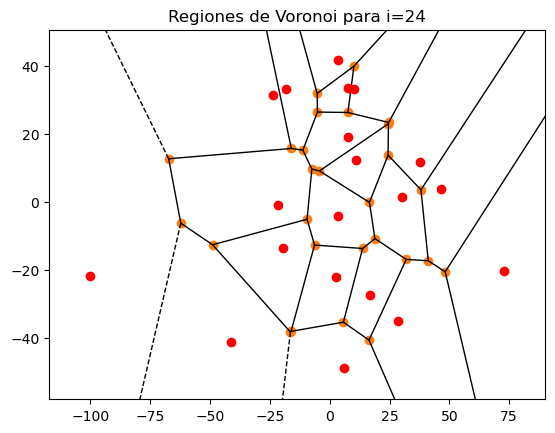

0.032801601252751444 23


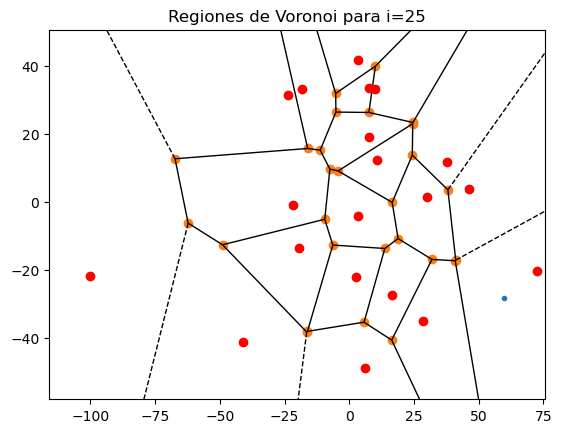

0.0018434903021924025 24


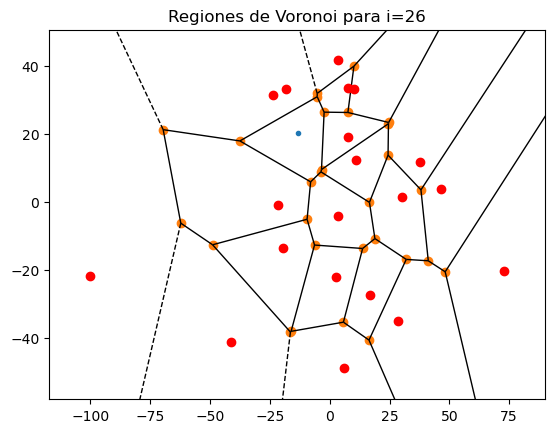

0.03238421979817689 25


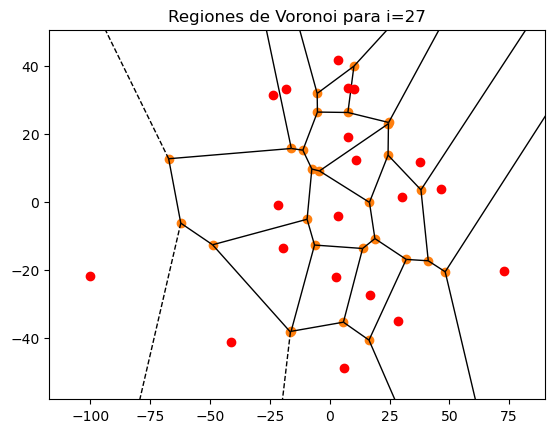

0.032801601252751444 26


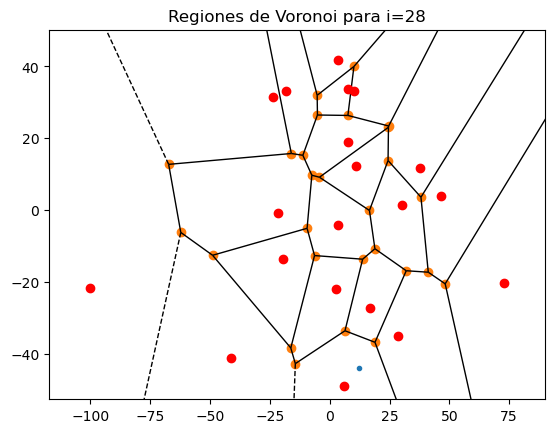

0.00021149136166840436 27


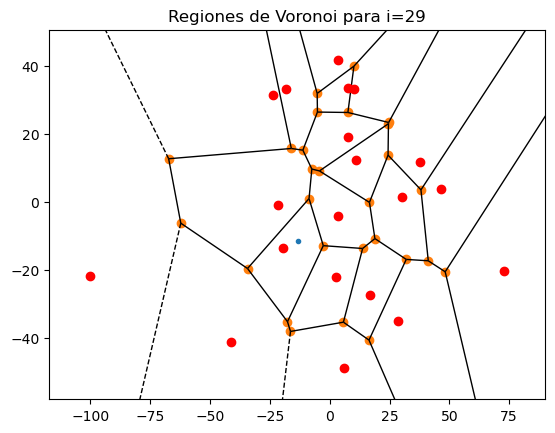

0.0024373214188057745 28


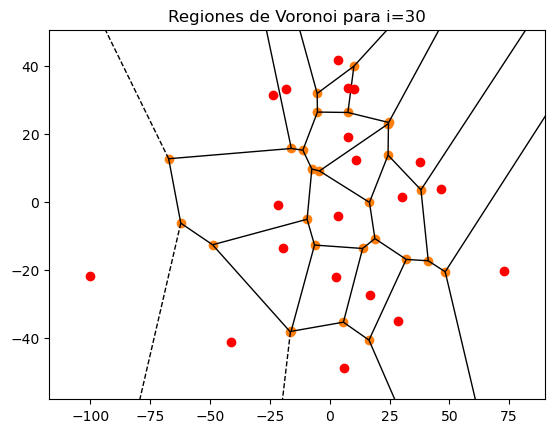

0.032801601252751444 29


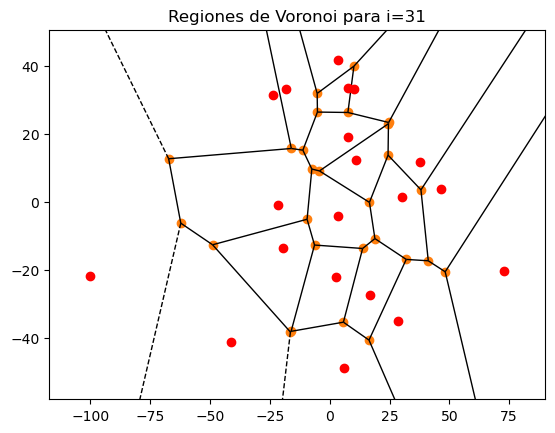

0.032801601252751444 30


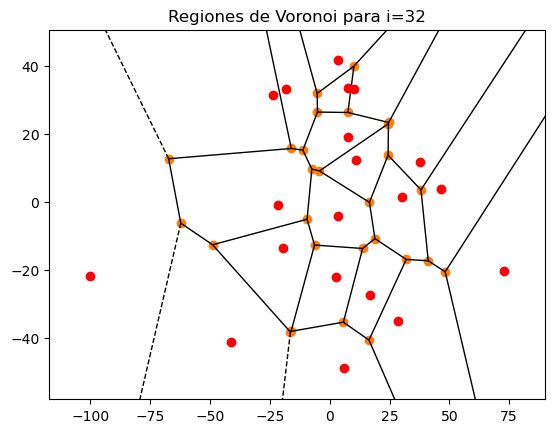

0.032801601252751444 31


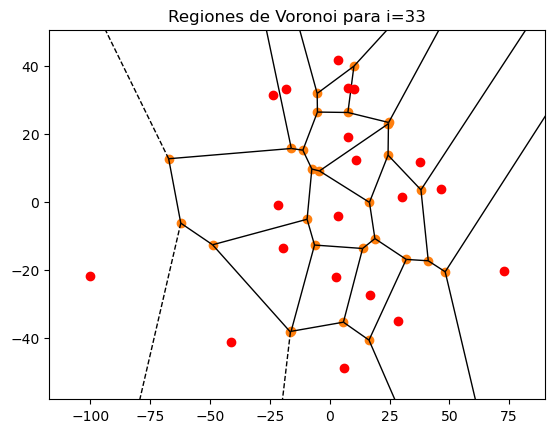

0.032801601252751444 32


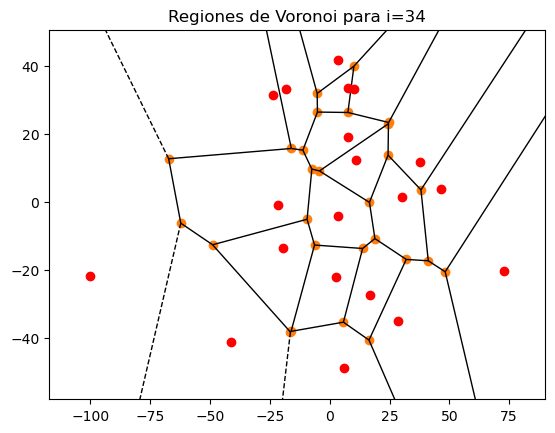

0.032801601252751444 33


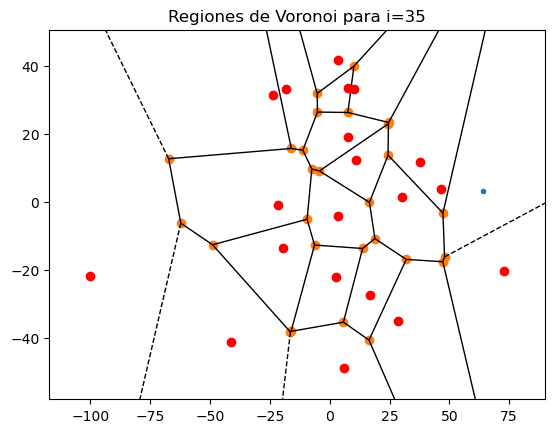

0.0003882693643568082 34


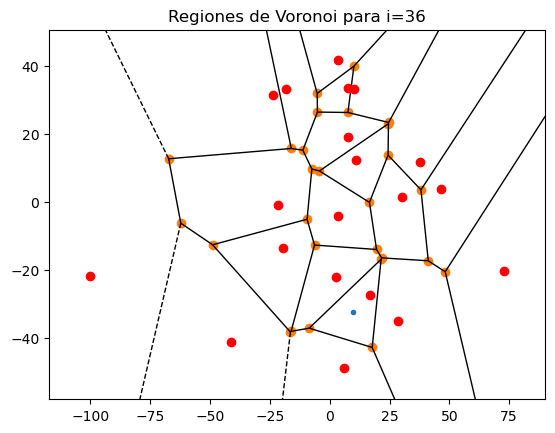

0.0005043161033458407 35


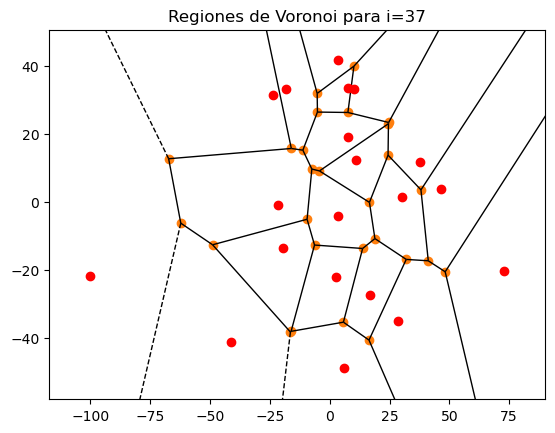

0.032801601252751444 36


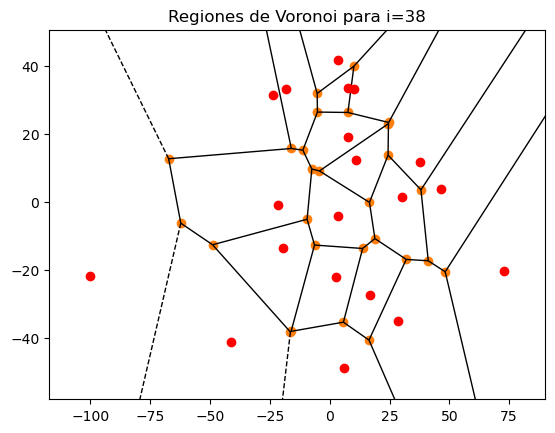

0.032801601252751444 37


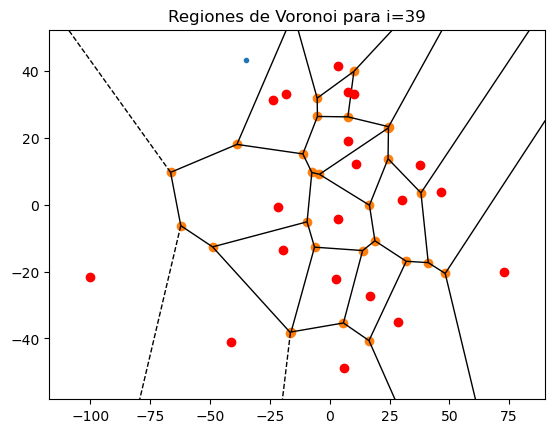

0.0005005276438362948 38


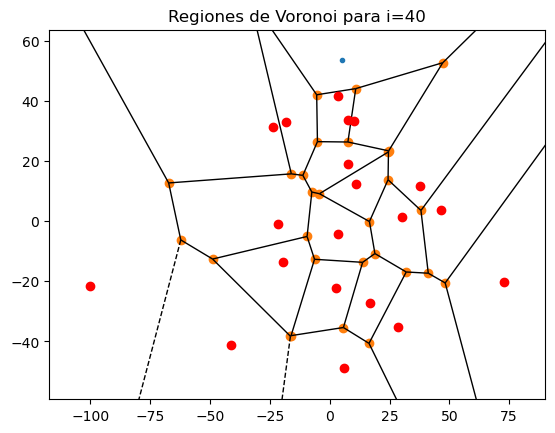

0.03470085997974153 39


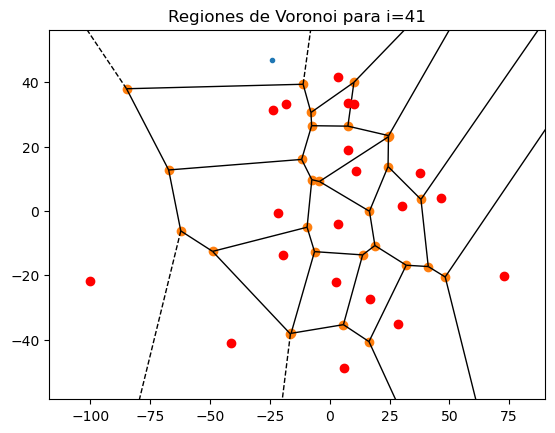

2.3274461941292406e-05 40


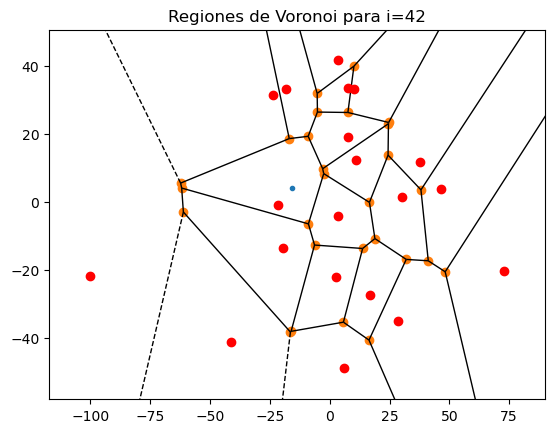

0.23307528942774922 41


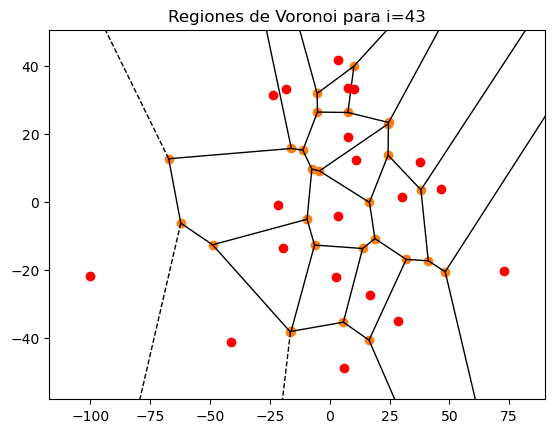

0.032801601252751444 42


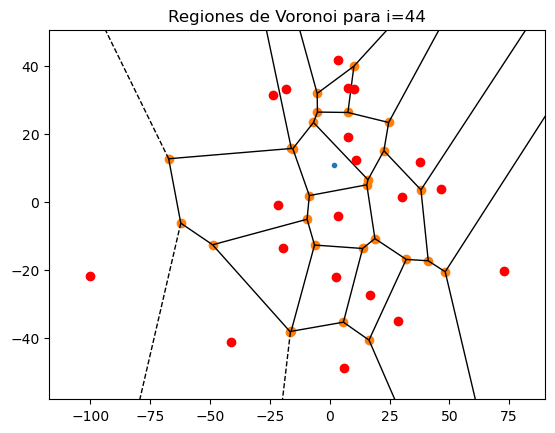

0.0035867602769956044 43


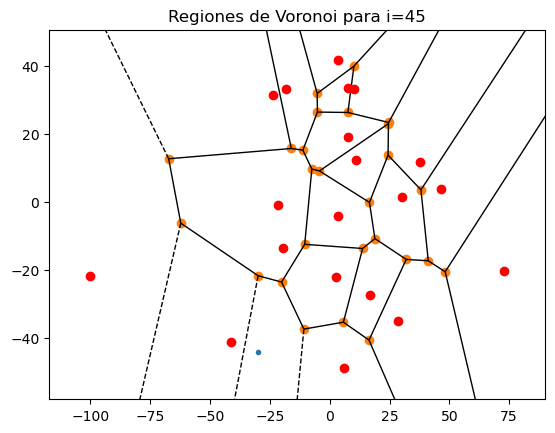

0.006414651782643174 44


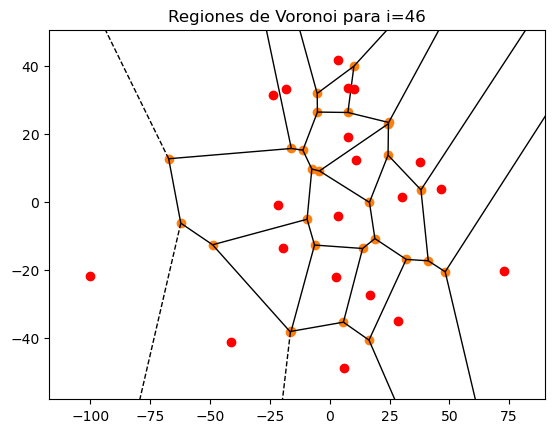

0.032801601252751444 45


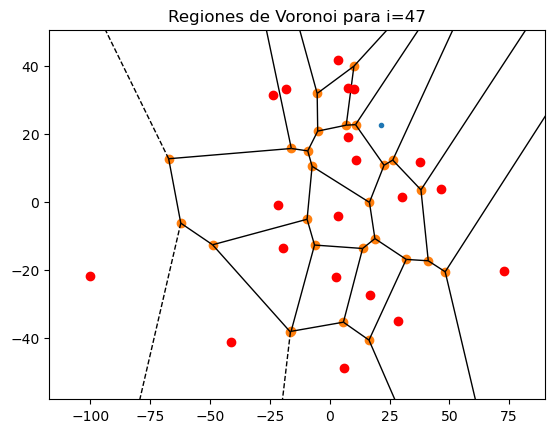

0.03237527063642155 46


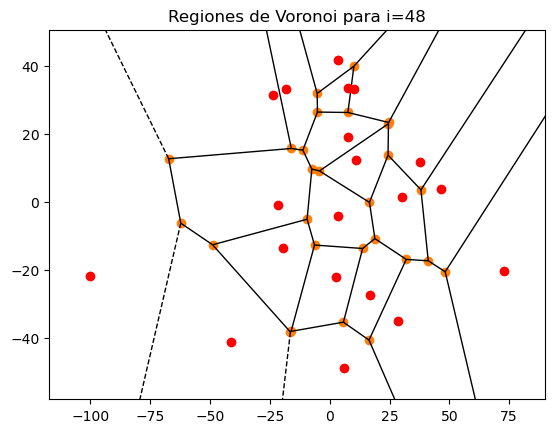

0.032801601252751444 47


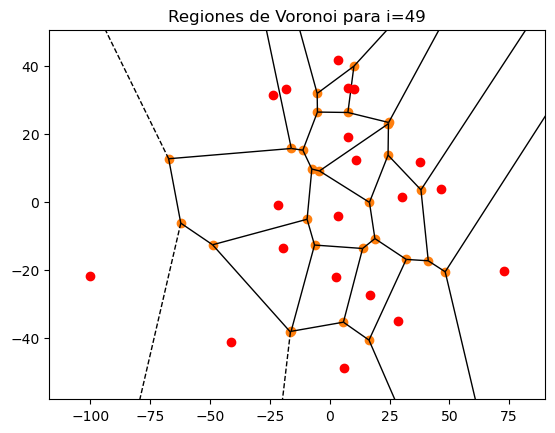

0.032801601252751444 48


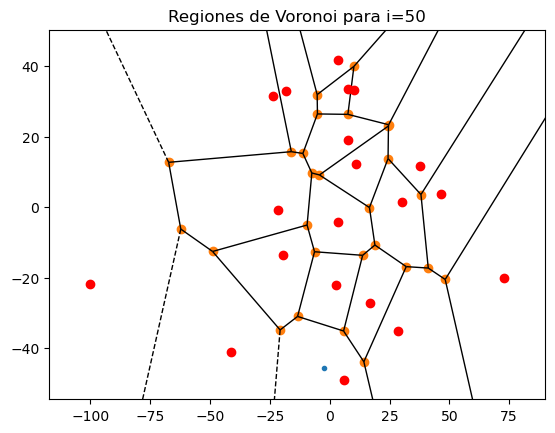

0.0007425482903960131 49


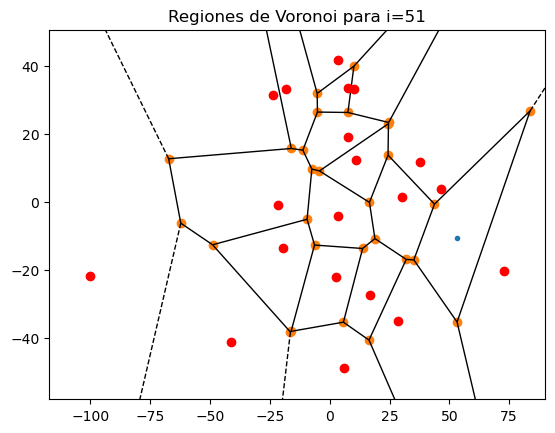

0.0008100216444878361 50


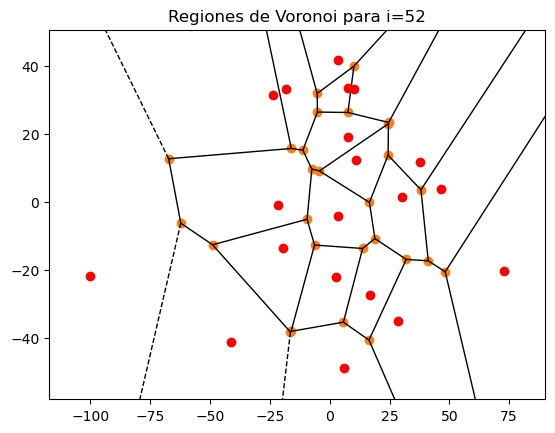

0.032801601252751444 51


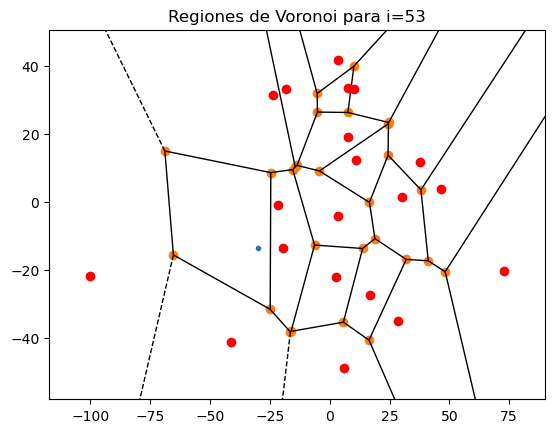

0.00396263698381984 52


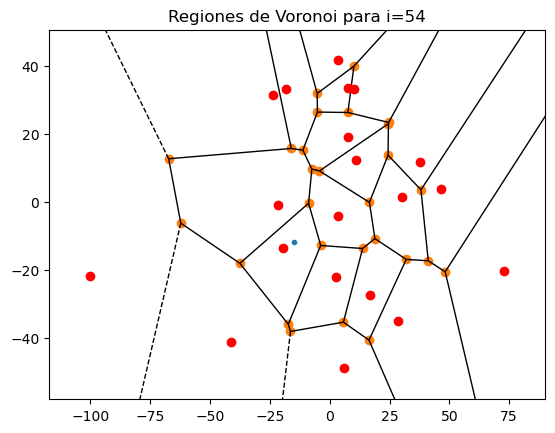

0.0024378067246491734 53


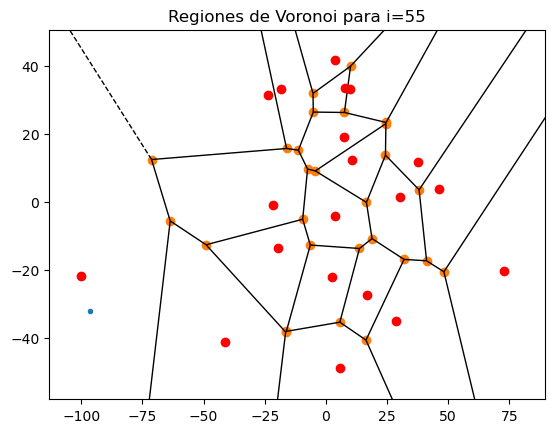

0.032742770578638634 54


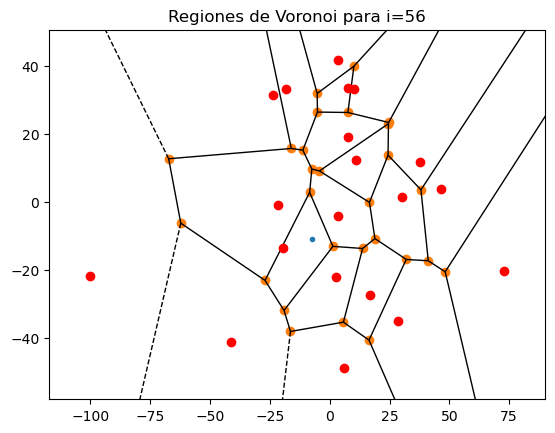

0.0007882436061259617 55


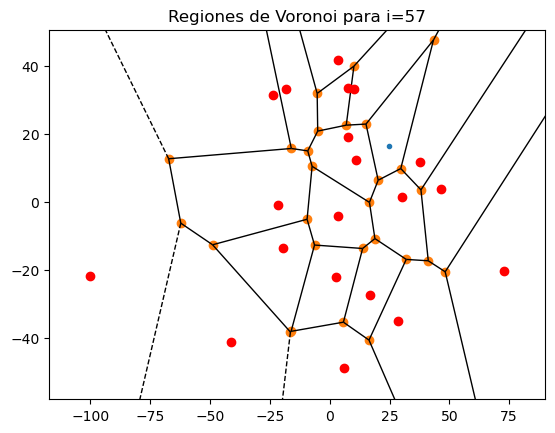

0.032406338207143684 56


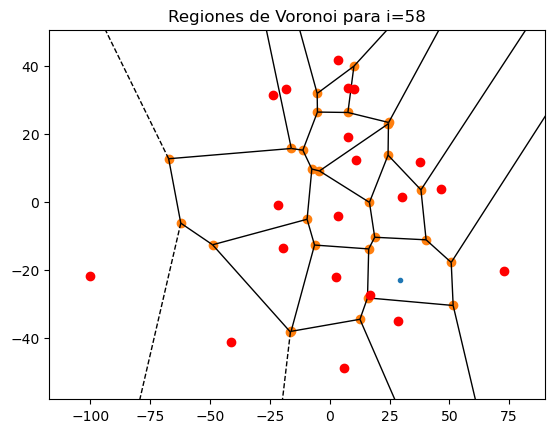

0.0005027939254195708 57


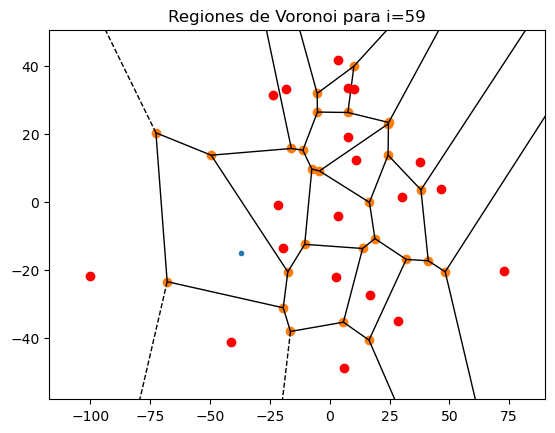

0.0014781878253323755 58


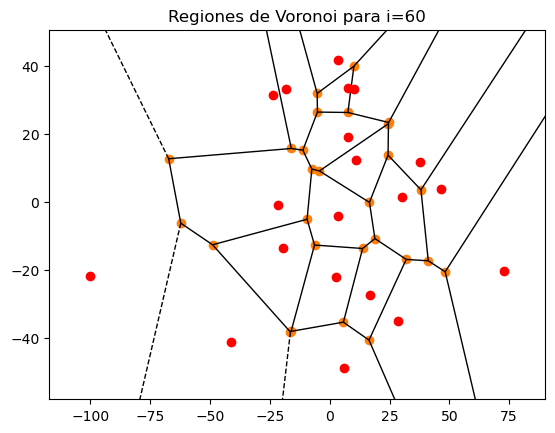

0.032801601252751444 59


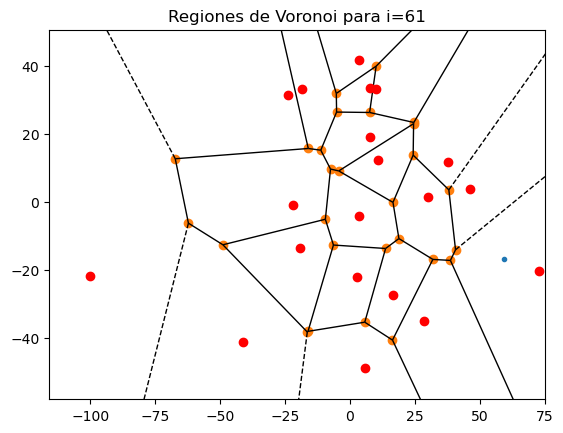

0.10865687306621342 60


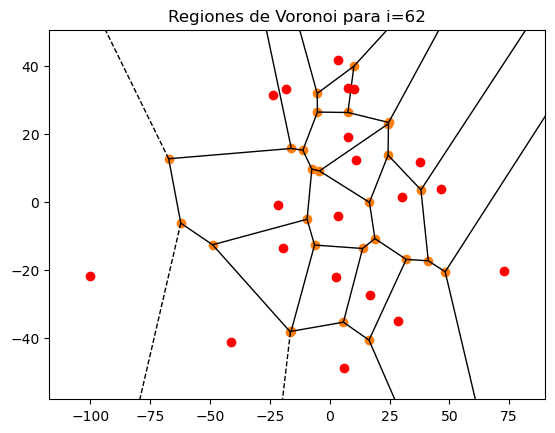

0.032801601252751444 61


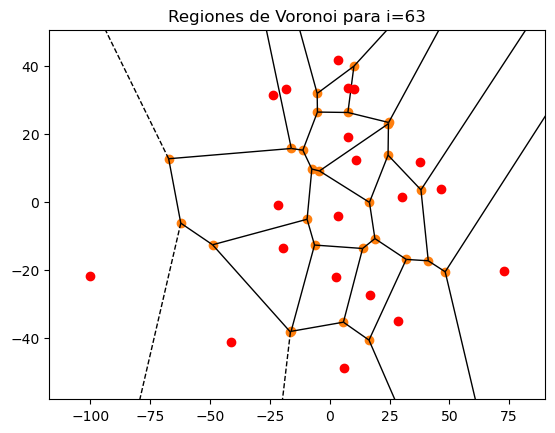

0.032801601252751444 62


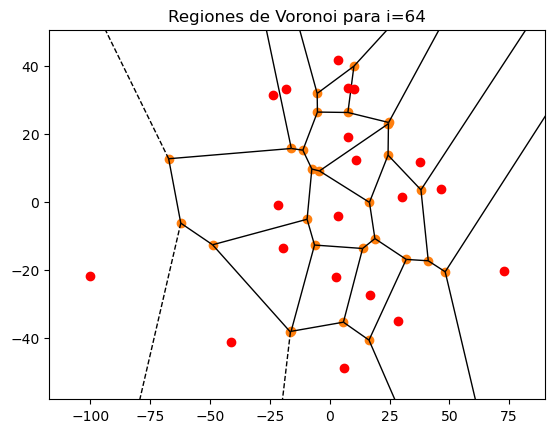

0.032801601252751444 63


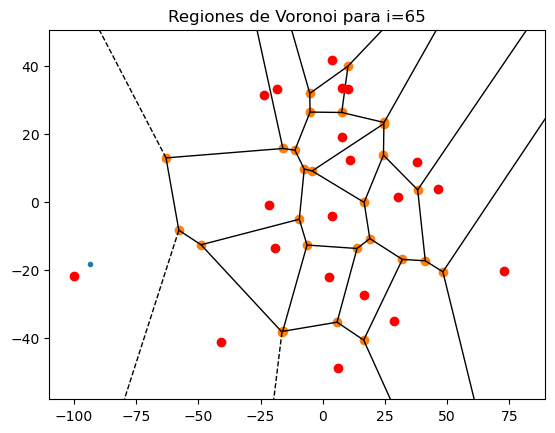

0.03287288088387967 64


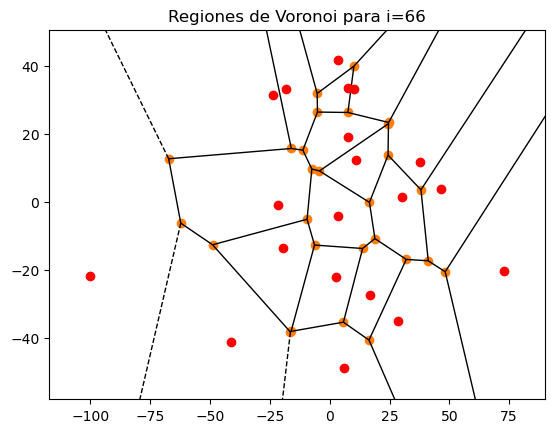

0.032801601252751444 65


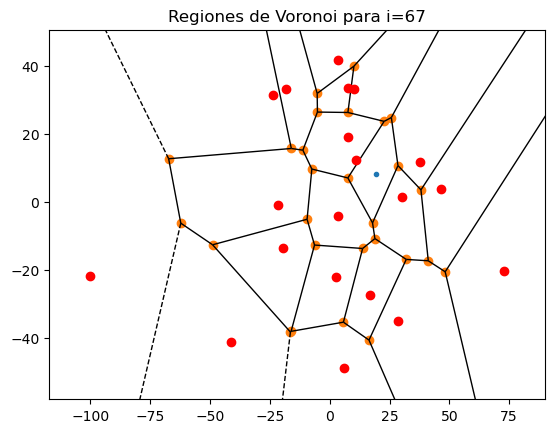

0.032520298827703166 66


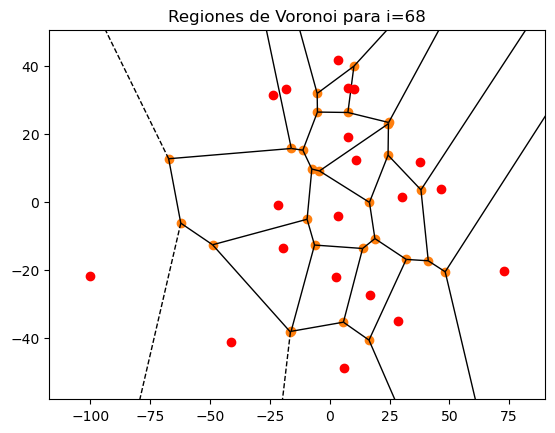

0.032801601252751444 67


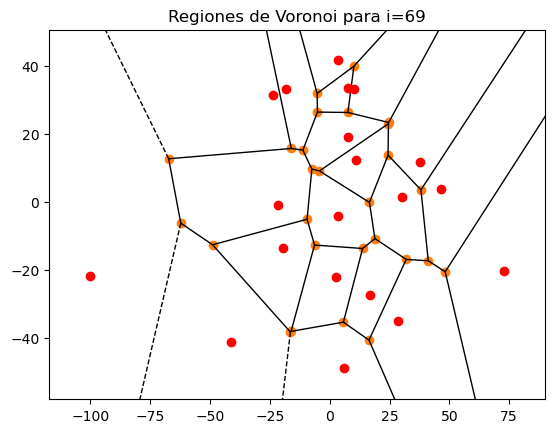

0.032801601252751444 68


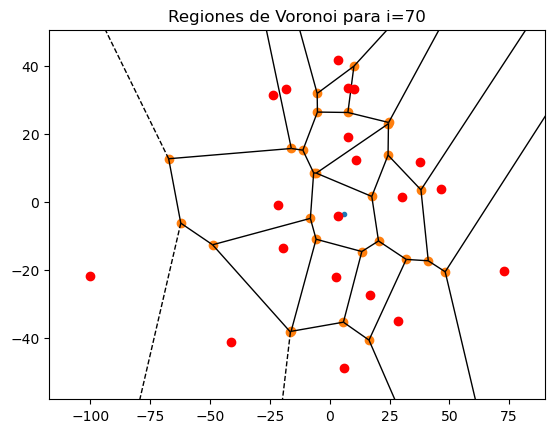

0.008109332768994322 69


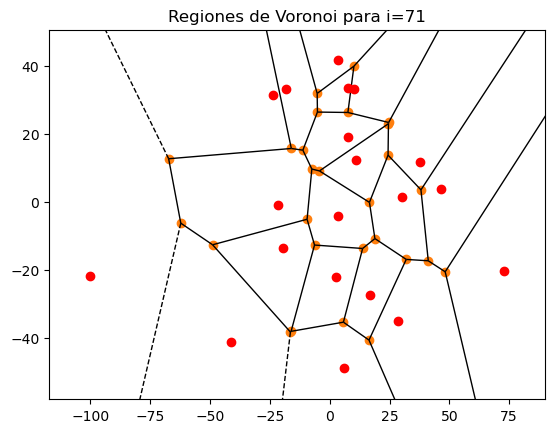

0.032801601252751444 70


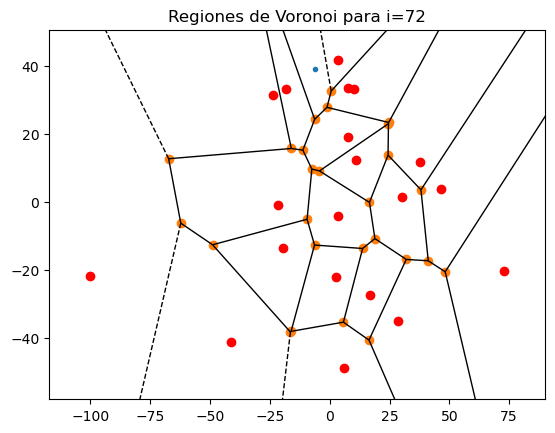

0.03233931823969888 71


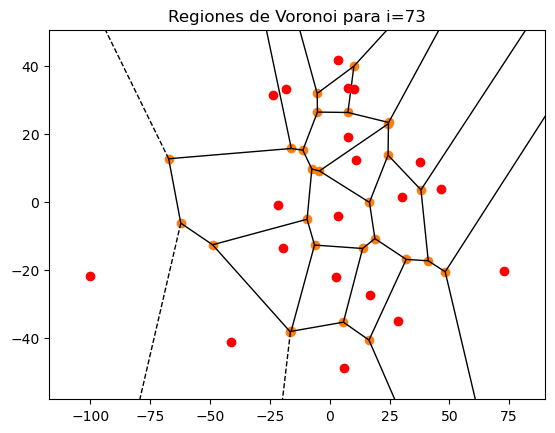

0.032801601252751444 72


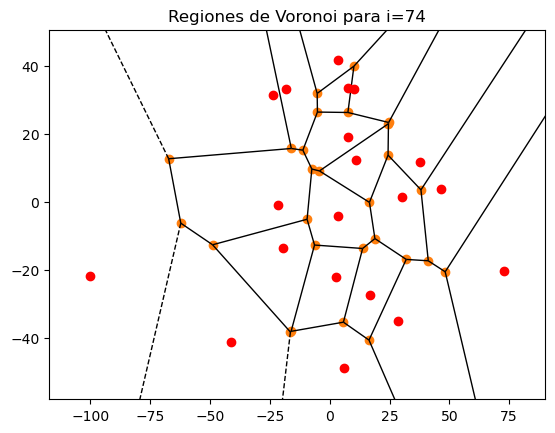

0.032801601252751444 73


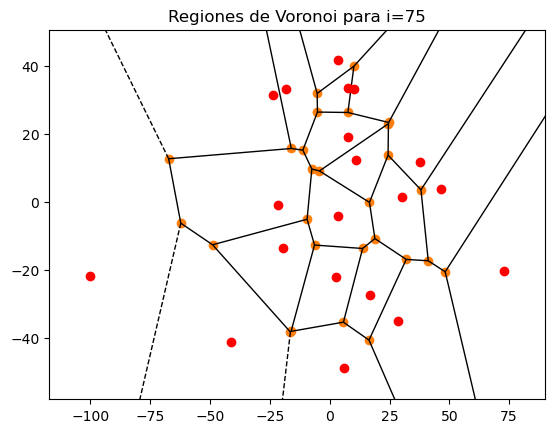

0.032801601252751444 74


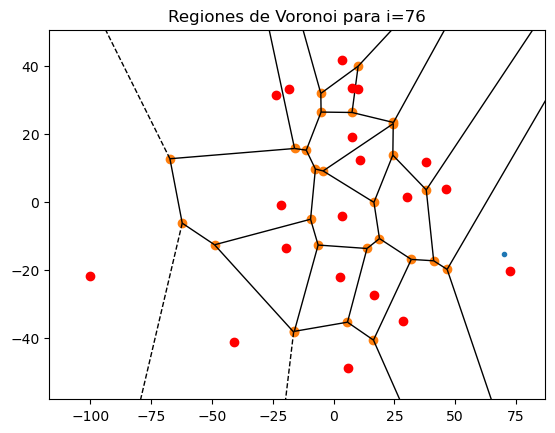

0.03280224277654959 75


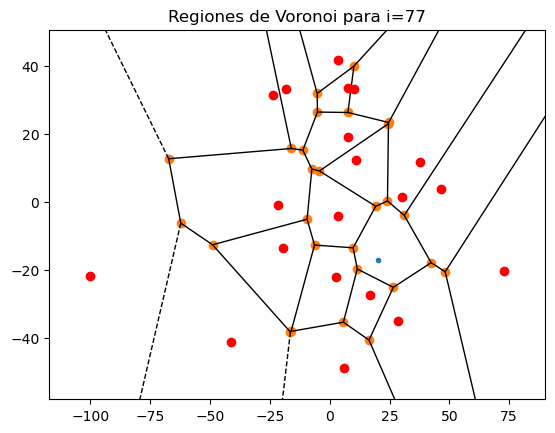

0.006612081322026507 76


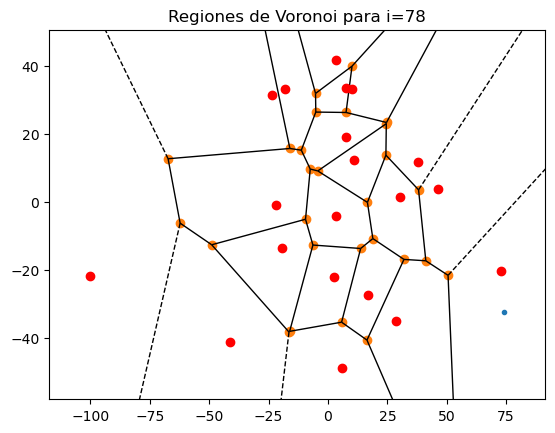

5.4700661543566565e-05 77


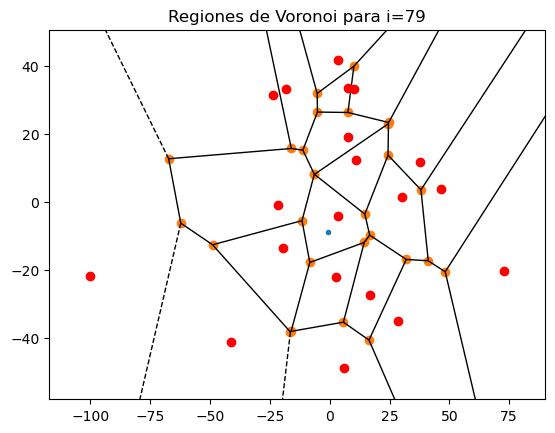

0.00042316095182617447 78


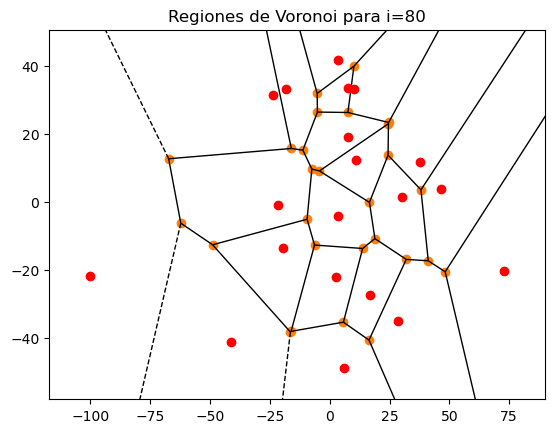

0.032801601252751444 79


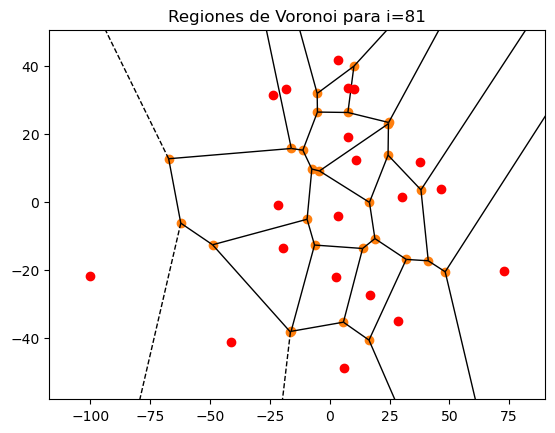

0.032801601252751444 80


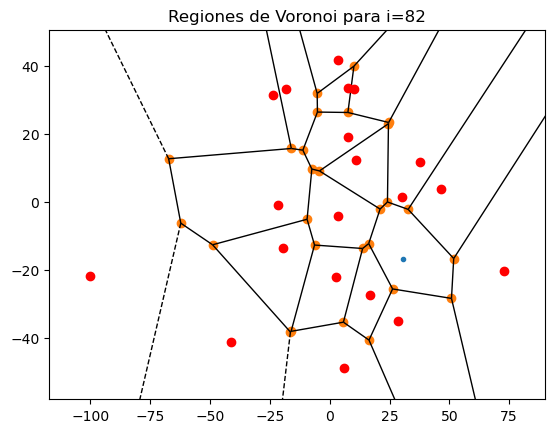

0.002984164023052497 81


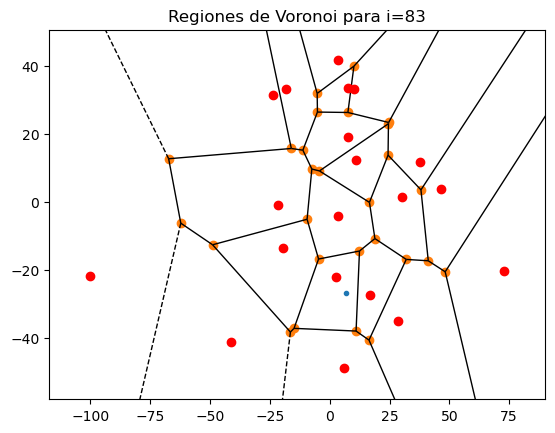

0.0005121819144508849 82


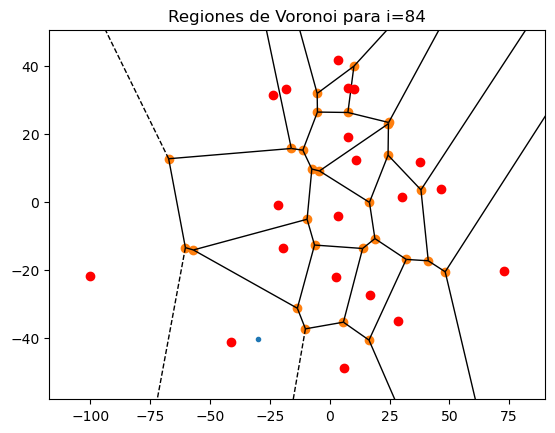

0.0347235504599128 83


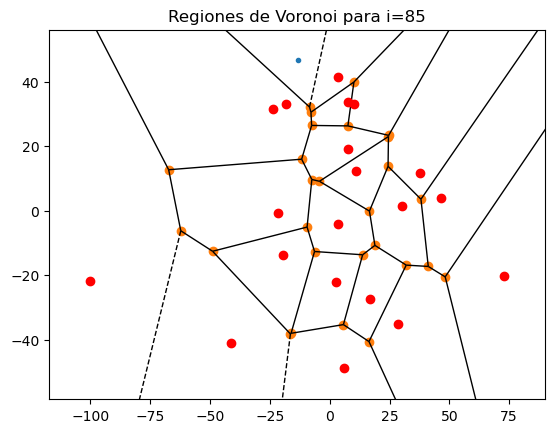

0.03231244577552634 84


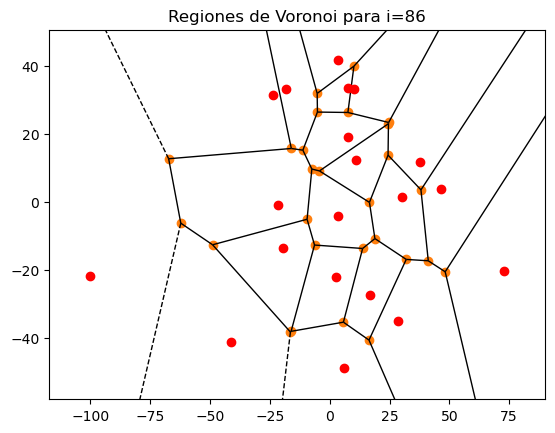

0.032801601252751444 85


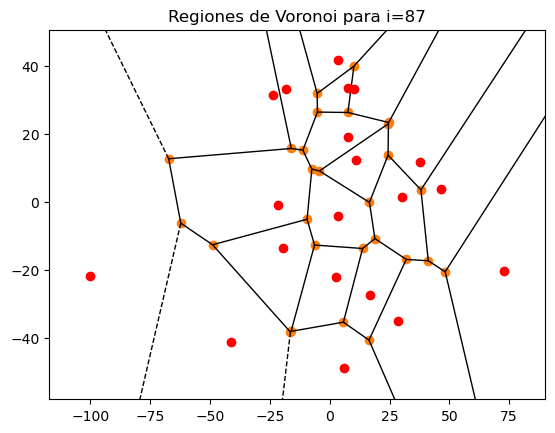

0.032801601252751444 86


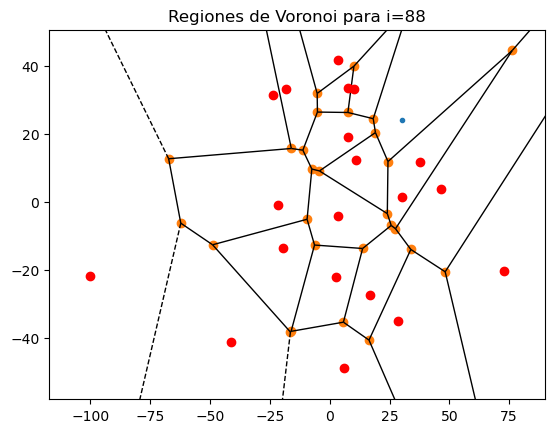

0.006866595282452569 87


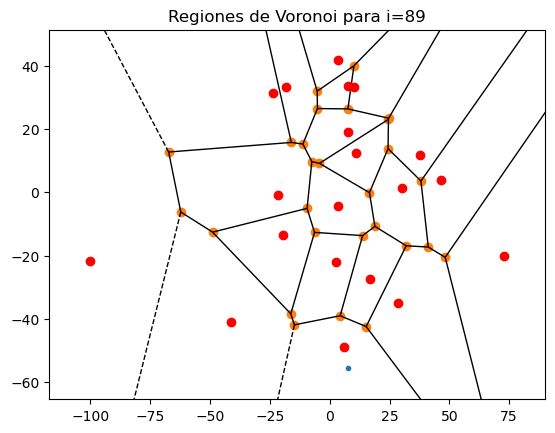

0.0007780391610492329 88


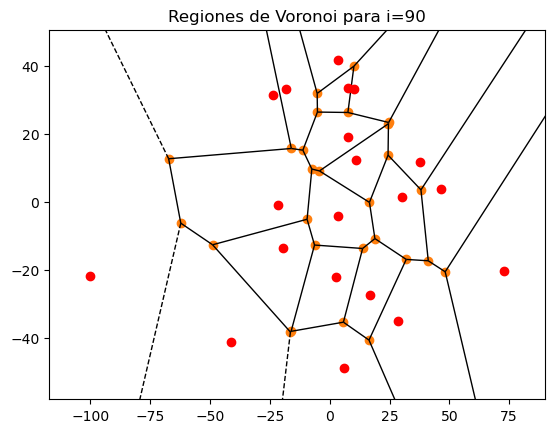

0.032801601252751444 89


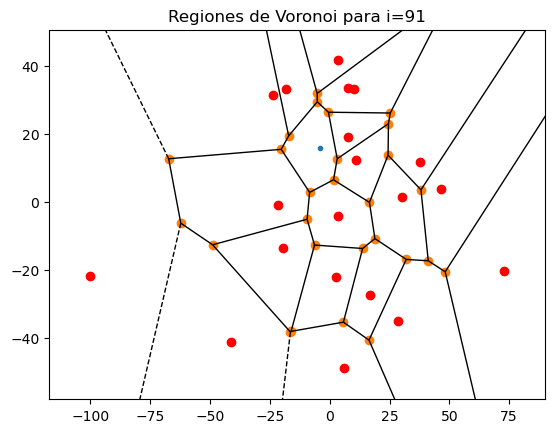

0.0016704523094089587 90


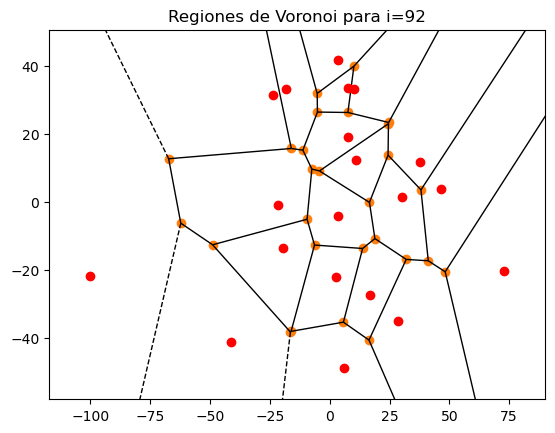

0.032801601252751444 91


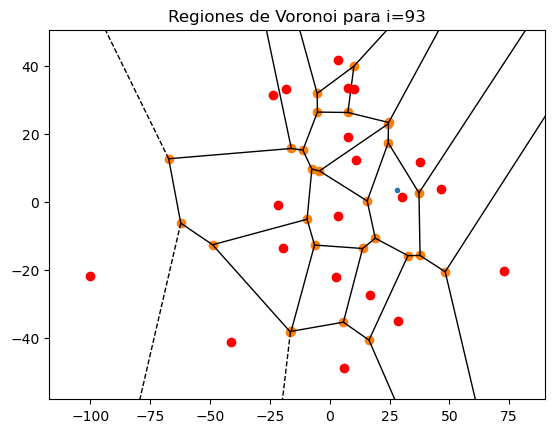

0.003139329160572474 92


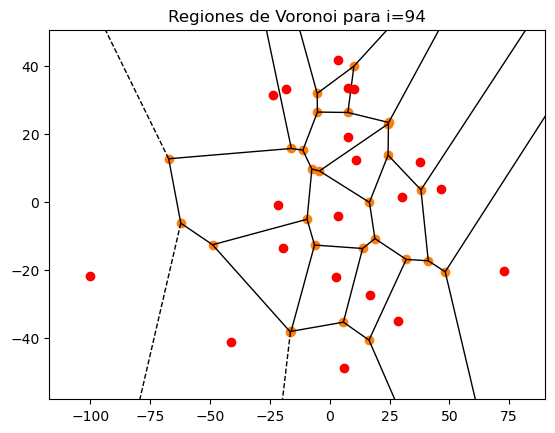

0.032801601252751444 93


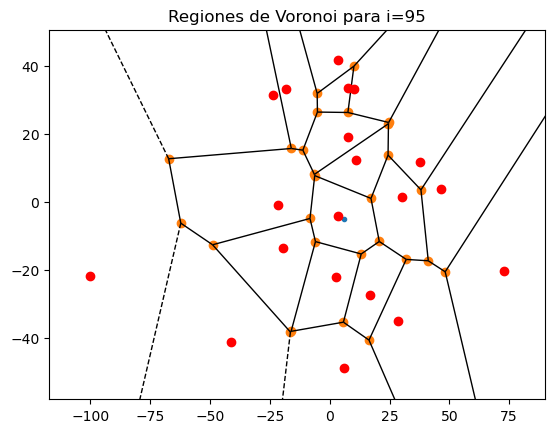

6.517093654056747e-05 94


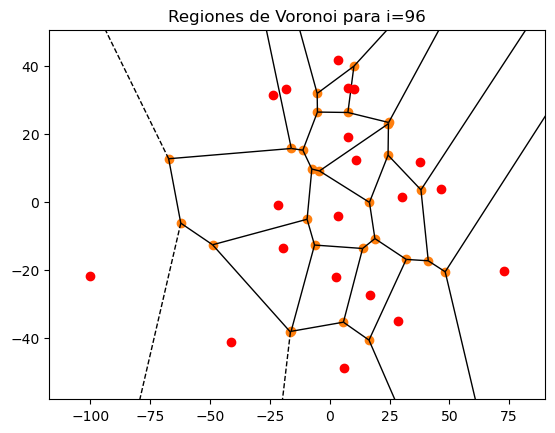

0.032801601252751444 95


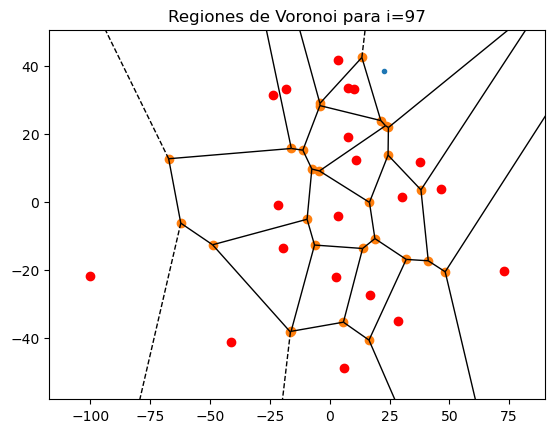

0.032458903183701954 96


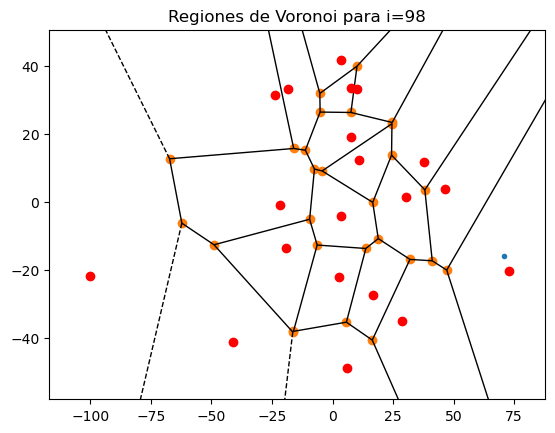

0.0328022446133638 97
5763.1917510763315 11


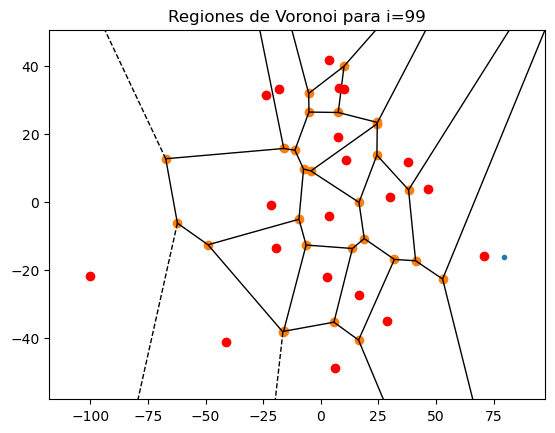

1 98
6448.464757662372 12


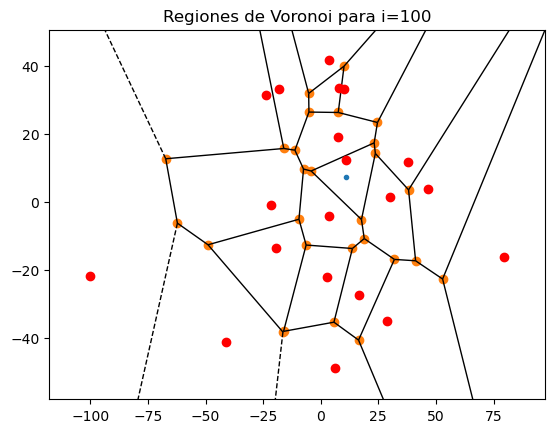

0.043084290166151853 99


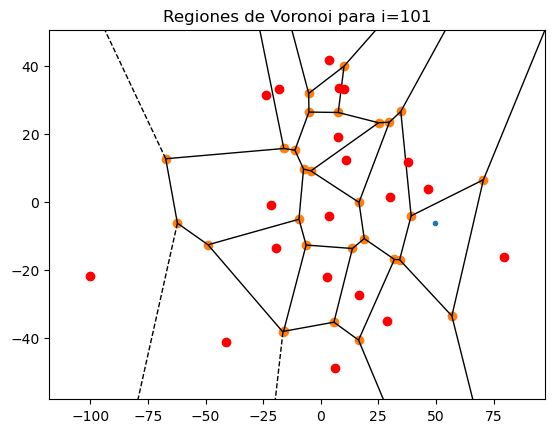

0.25789225189896275 100
1663.0090976446484 13


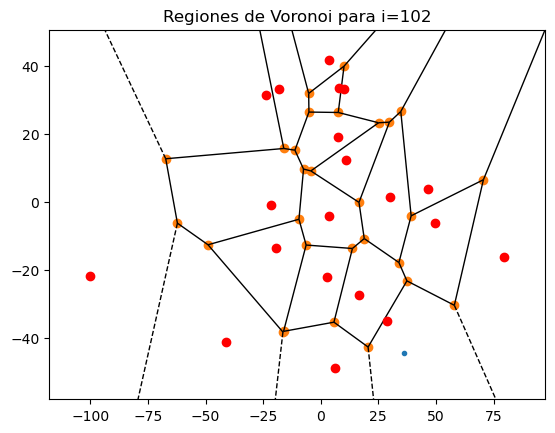

0.02405855903047955 101


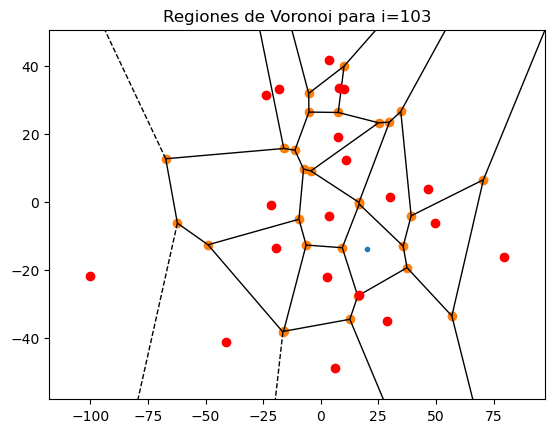

0.07901910796368802 102


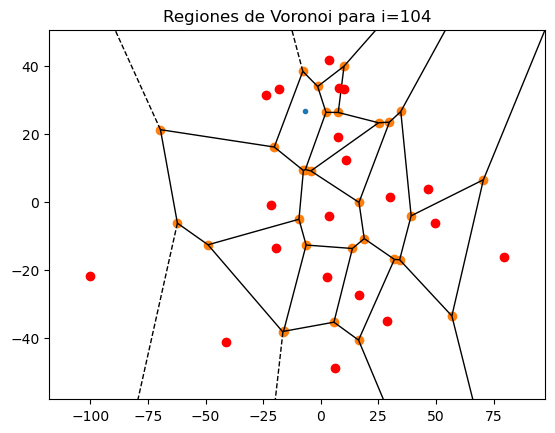

0.05040364899812686 103


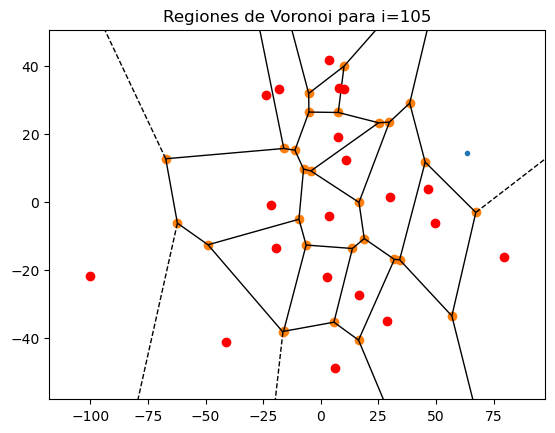

0.13266785557665914 104


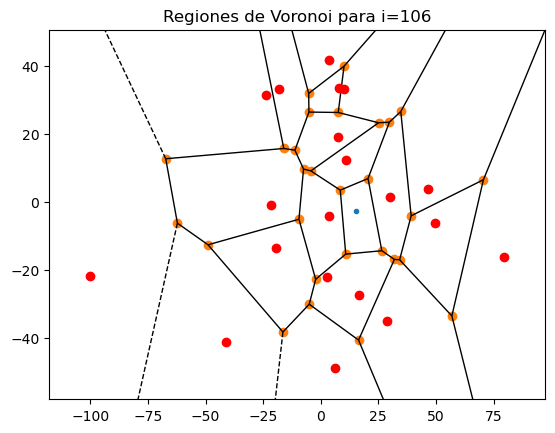

0.04814778032238659 105


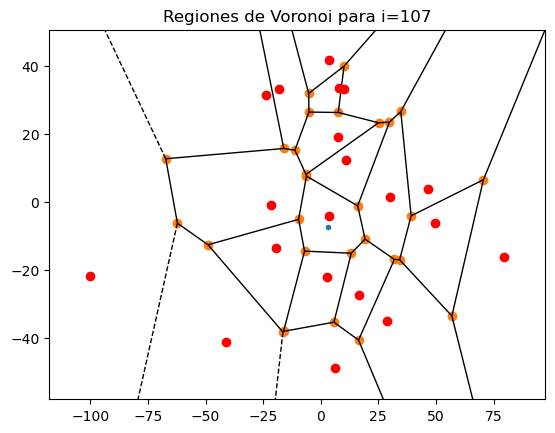

0.058565647519551026 106
97.39520463446308 14


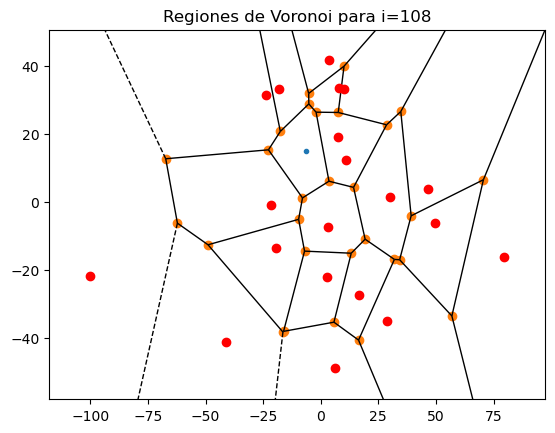

0.2589071402430767 107


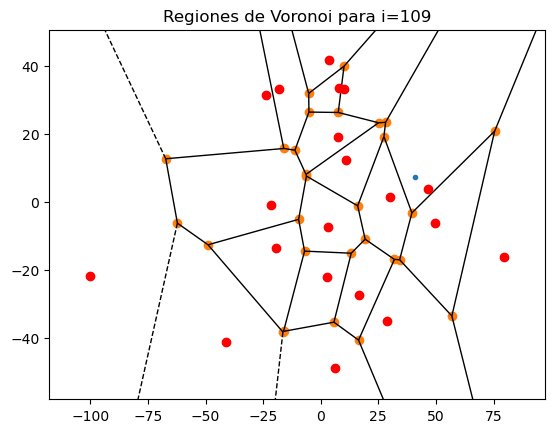

1 108
1473.0901510478789 15


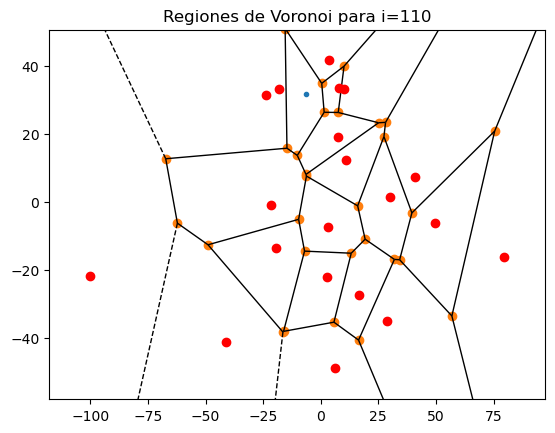

0.053160431773378224 109


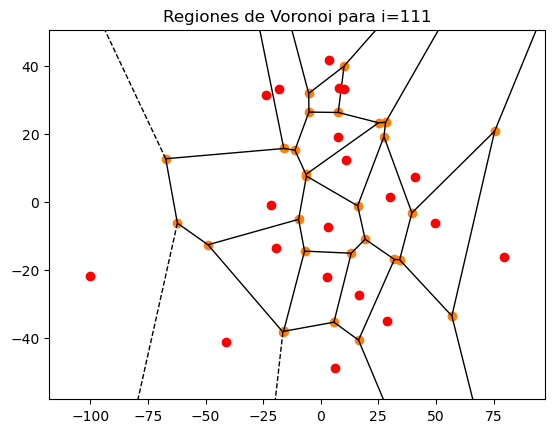

0.05264360287687124 110


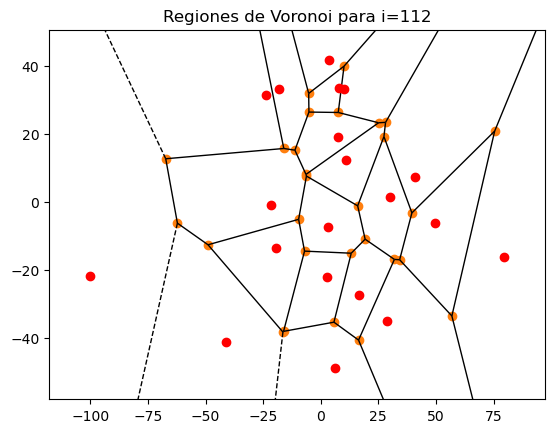

0.05264360287687124 111


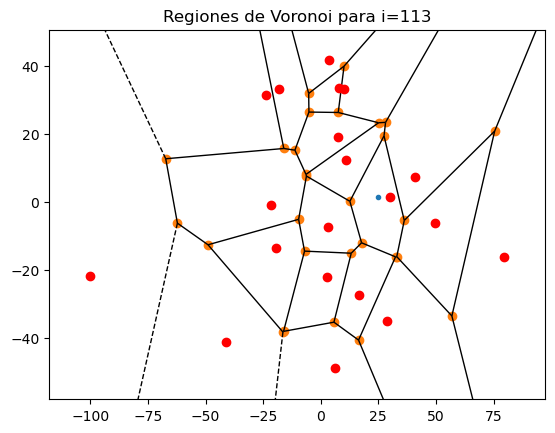

0.05265251979472571 112


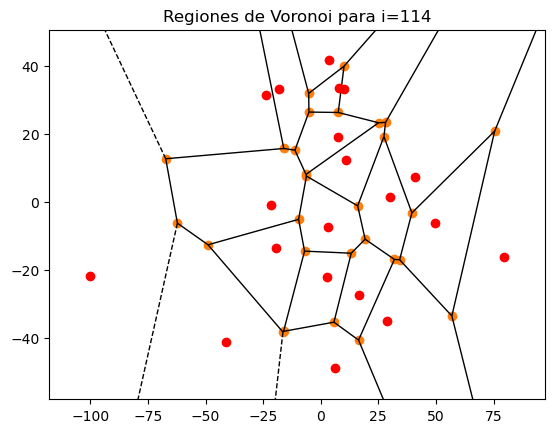

0.05264360287687124 113


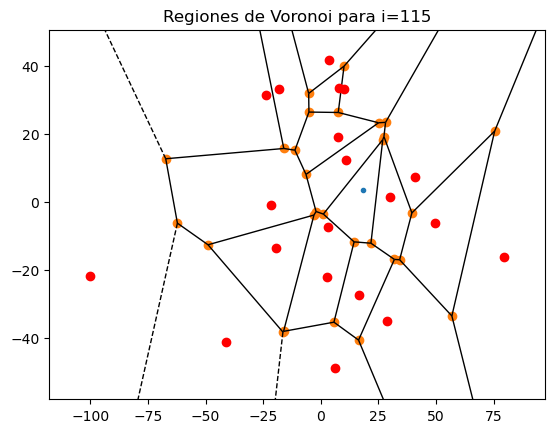

0.19402329545927718 114


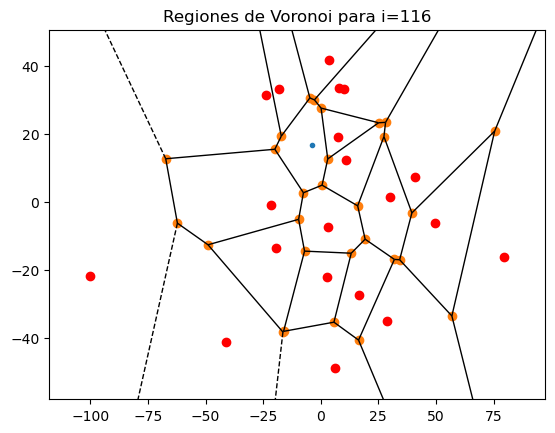

0.40635660459420836 115
598.5999120409856 16


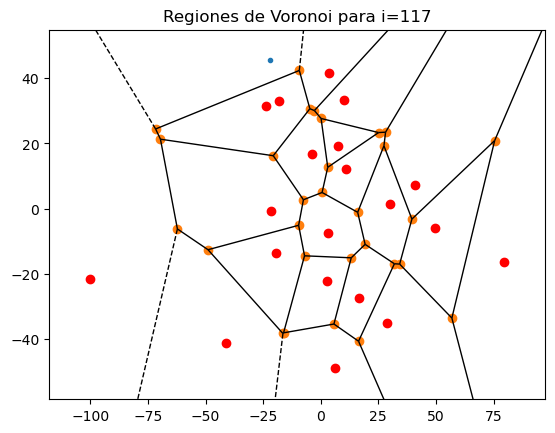

0.013124516419508002 116


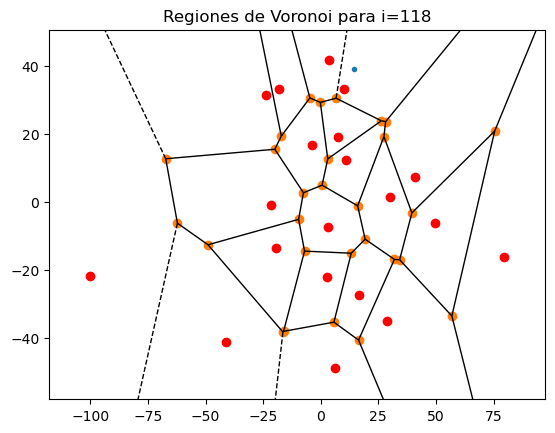

0.0821487647060919 117


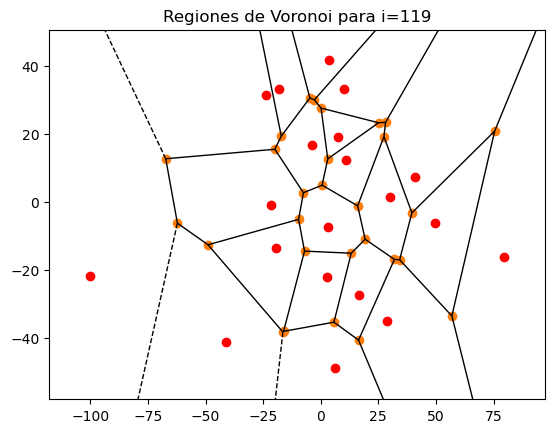

0.12976069037633273 118


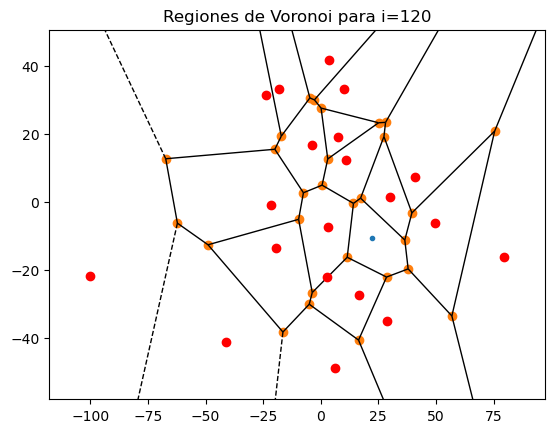

0.03062180181992045 119


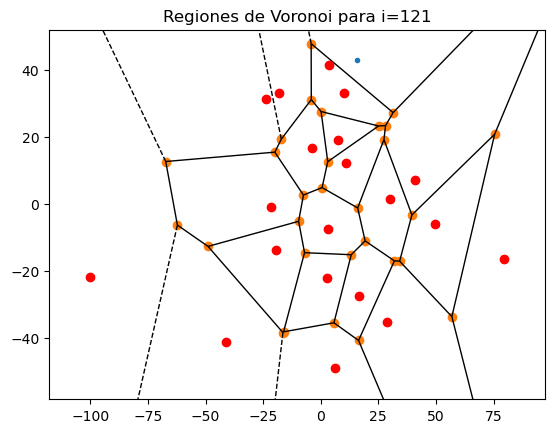

0.023924507775062002 120


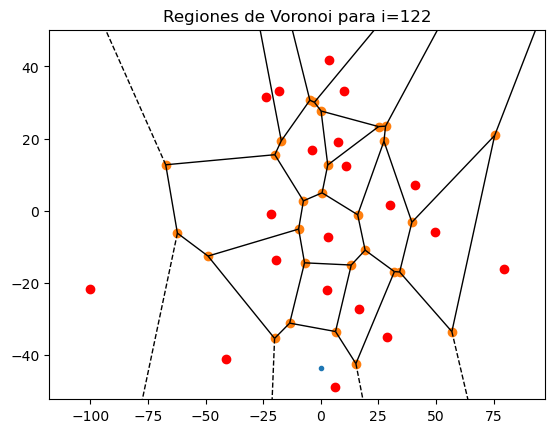

0.19335030662634775 121


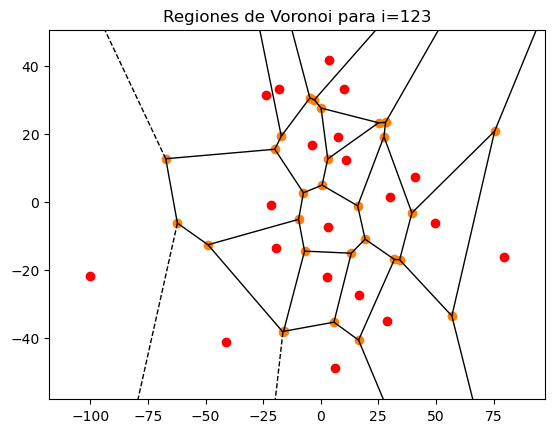

0.12976069037633273 122


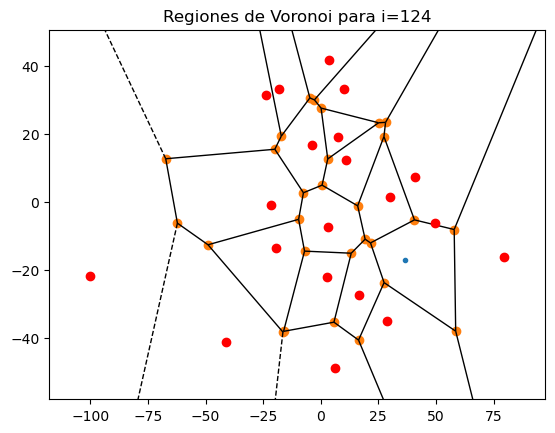

0.04750224438172996 123


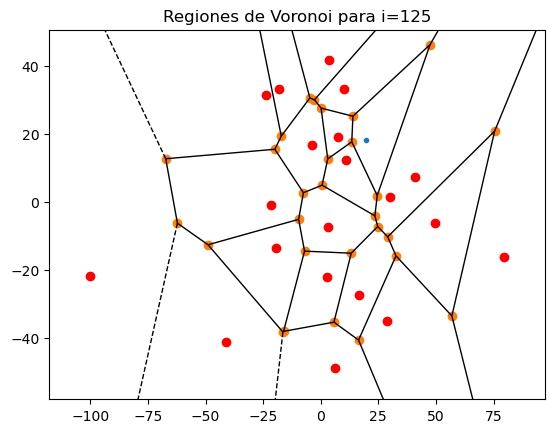

0.9934623629900821 124
594.6864831018928 17


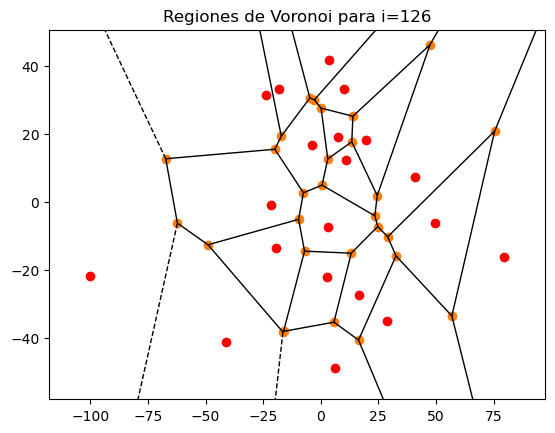

0.13153105683711785 125
78.21974160914078 18


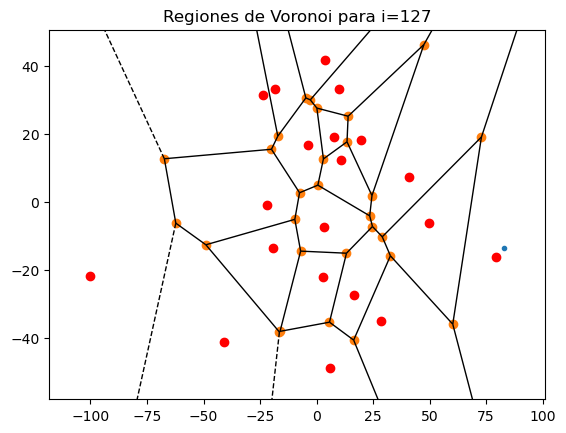

1 126
133.69522200322567 19


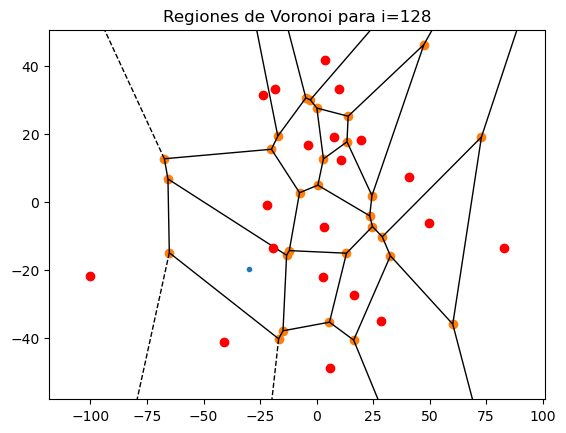

0.6987784895294321 127
93.42334528871612 20


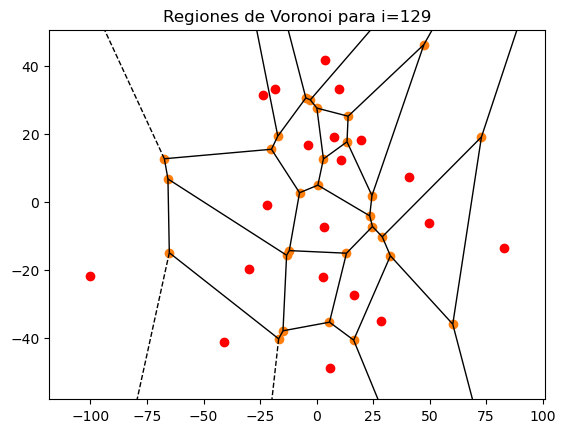

0.12465519492628824 128


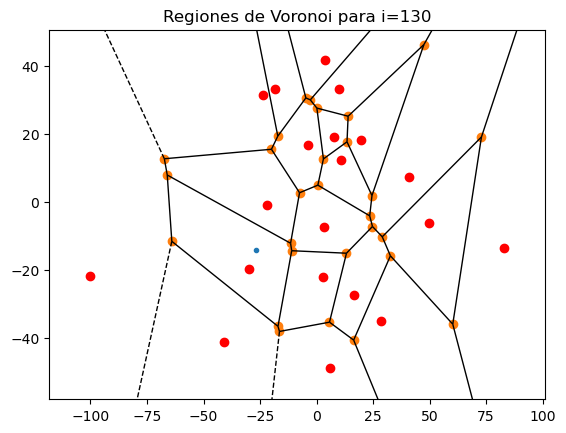

1 129
128.046111298178 21


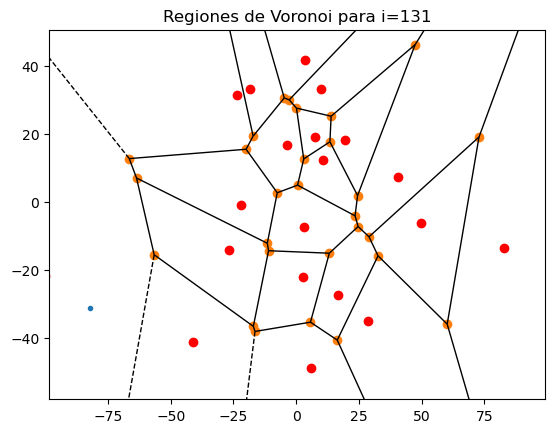

0.06811842804743785 130


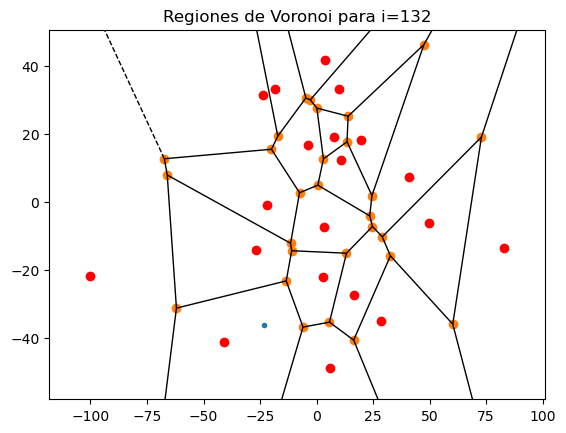

0.05240887039211822 131


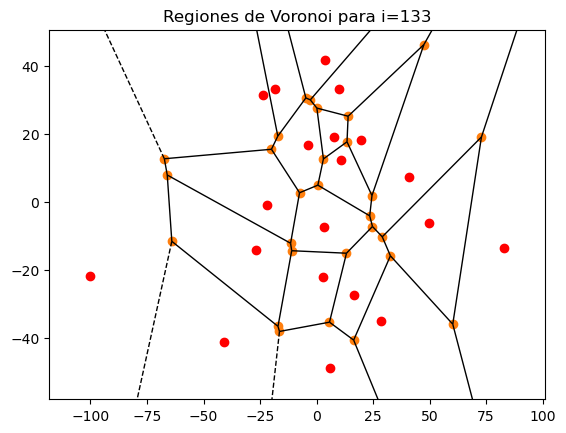

0.5929279644100687 132
75.92212012265378 22


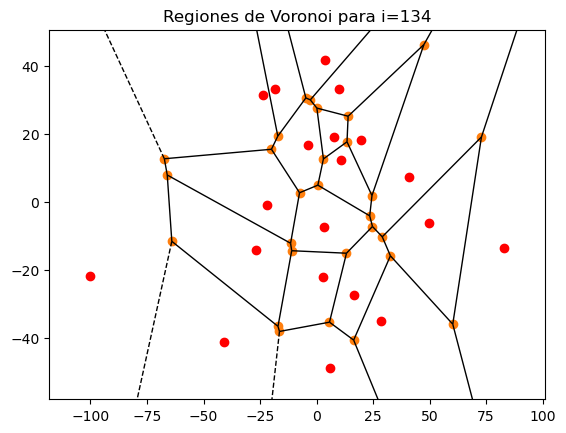

1 133
75.92212012265378 23


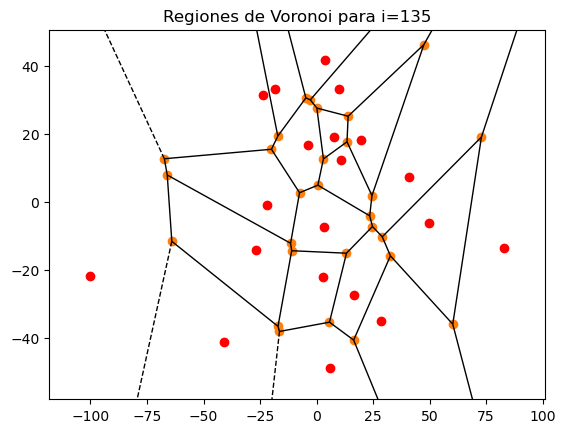

1 134
75.92212012265378 24


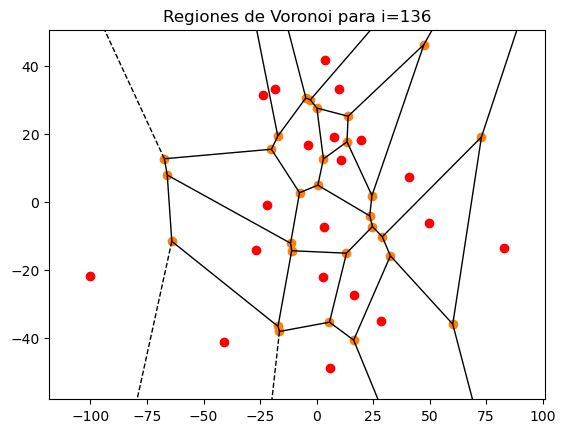

1 135
75.92212012265378 25


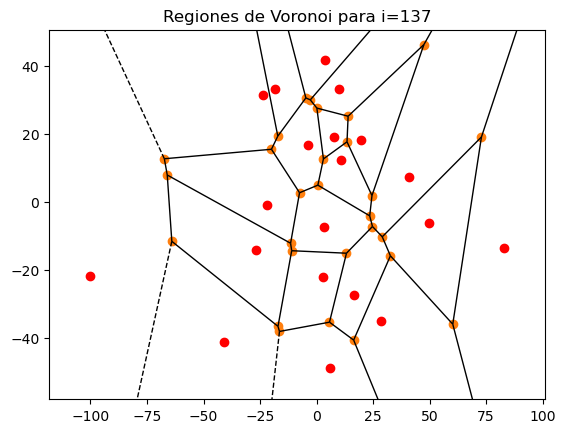

1 136
75.92212012265378 26


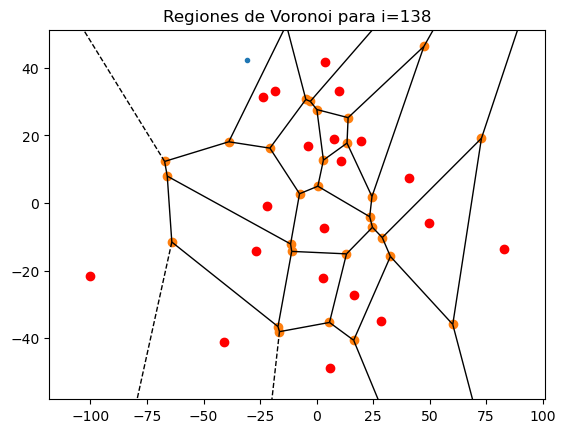

1 137
889.6472552029198 27


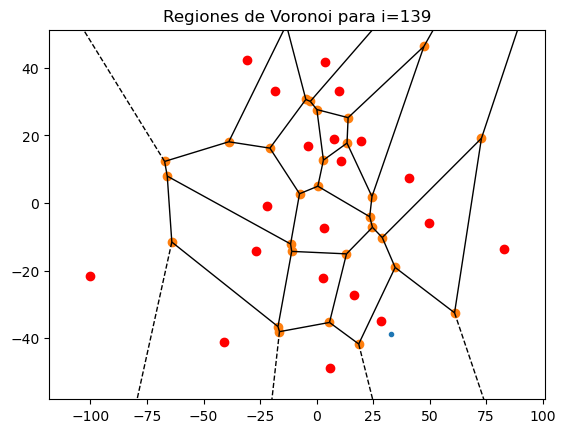

0.045818483330266696 138


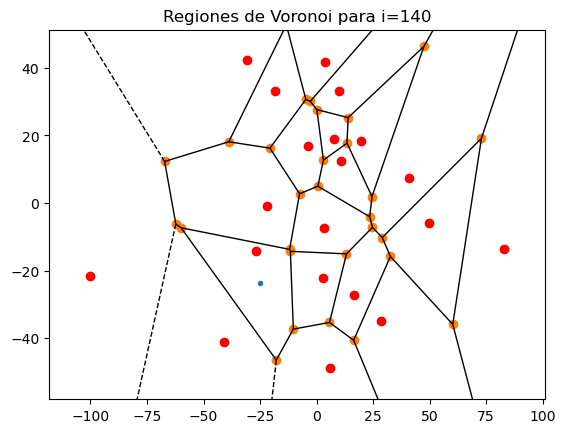

0.05198241560837779 139


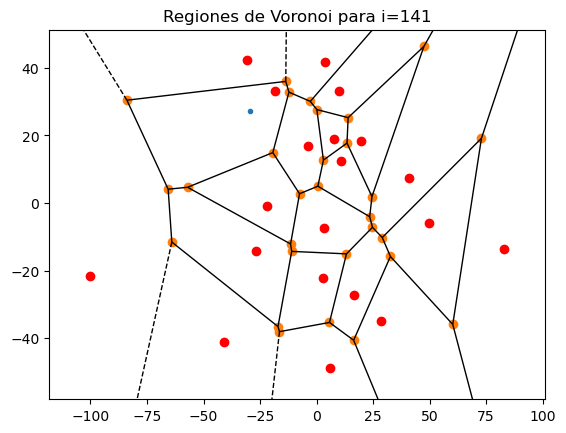

0.25574648423798546 140


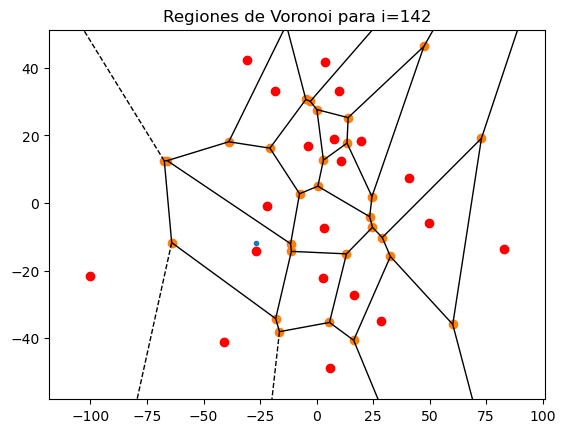

0.046414099203086805 141


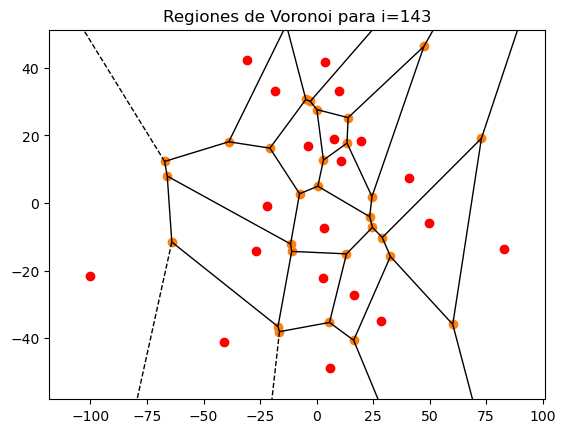

0.13198725516150822 142


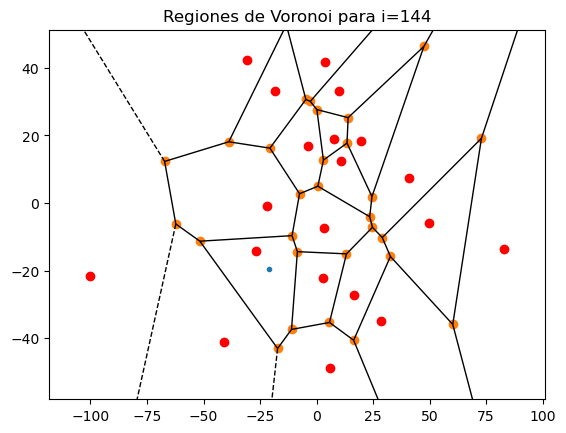

0.04114193475861872 143


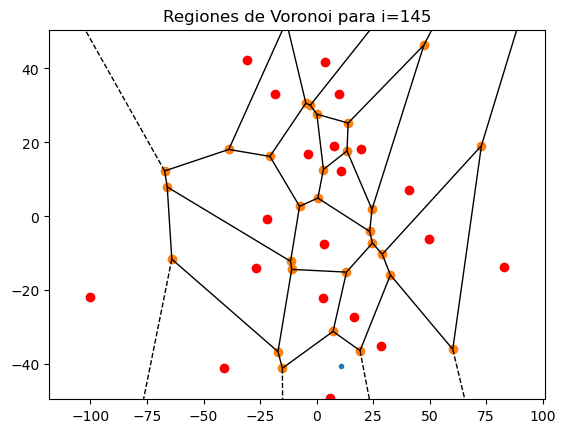

0.01323671776687127 144


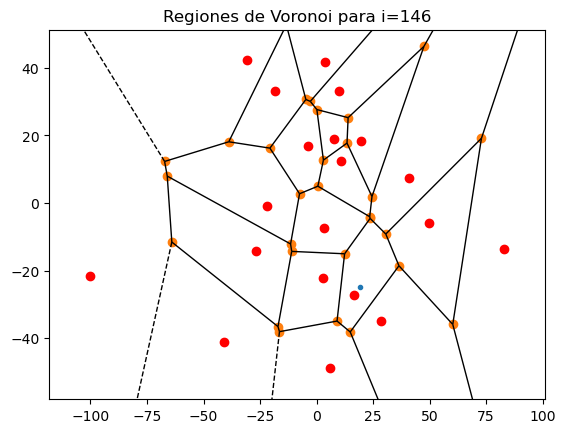

0.13455576678680847 145


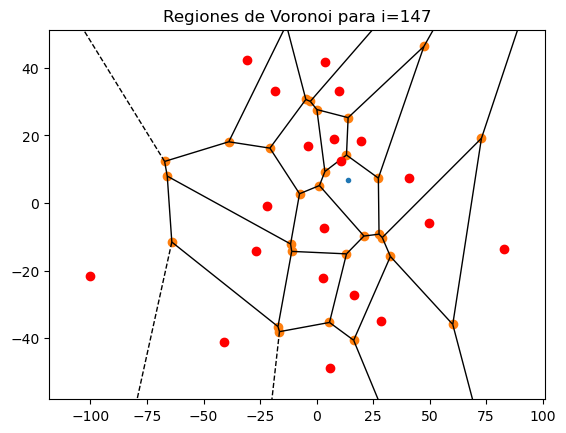

0.08549447094302617 146


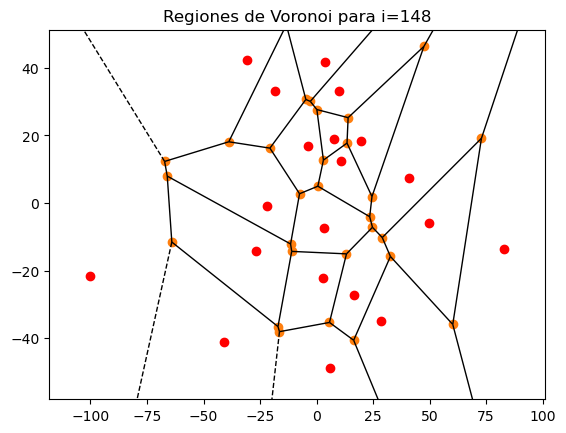

0.13198725516150822 147


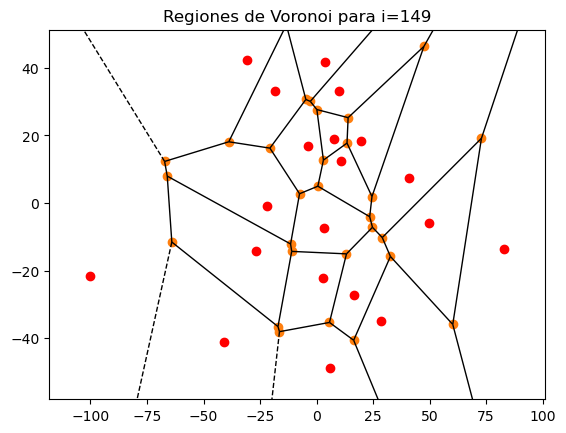

0.13198725516150822 148


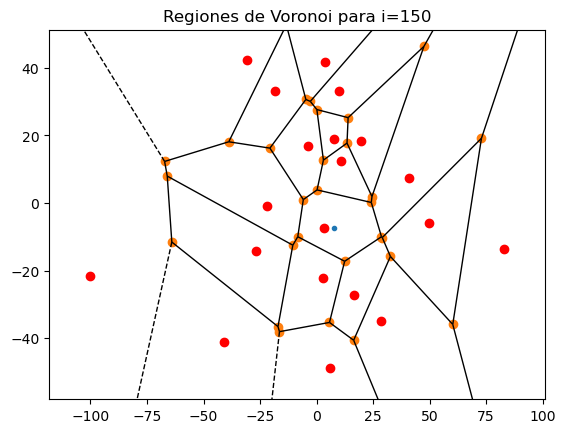

0.030680089661704647 149


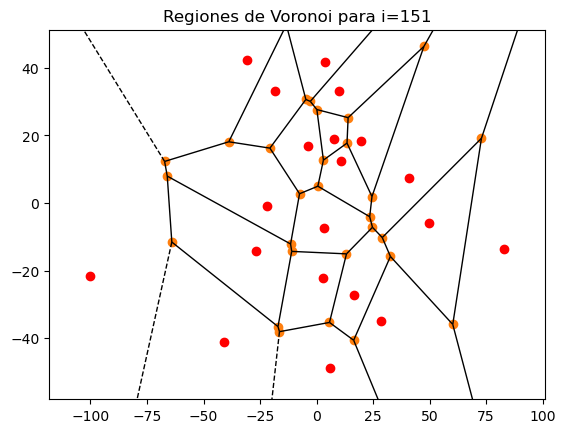

0.13198725516150822 150


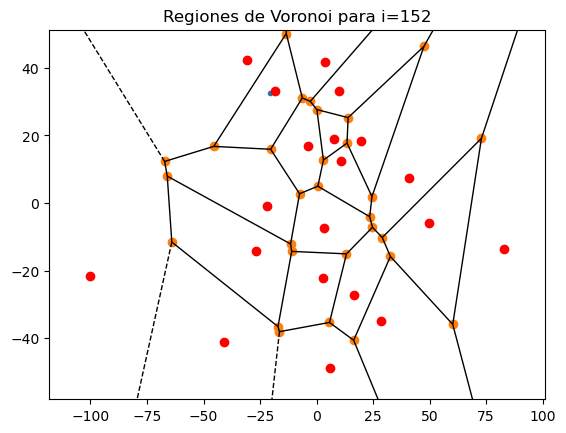

0.24133628396074316 151


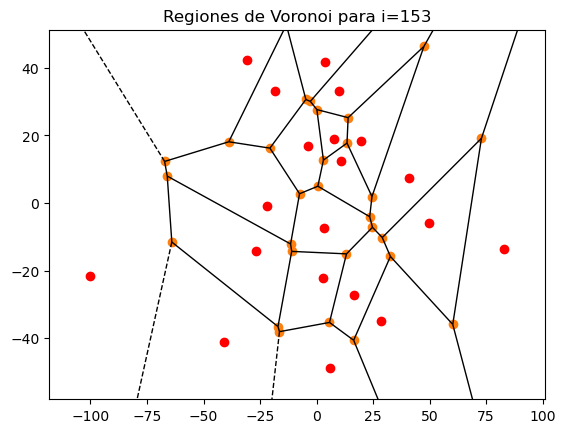

0.13198725516150822 152


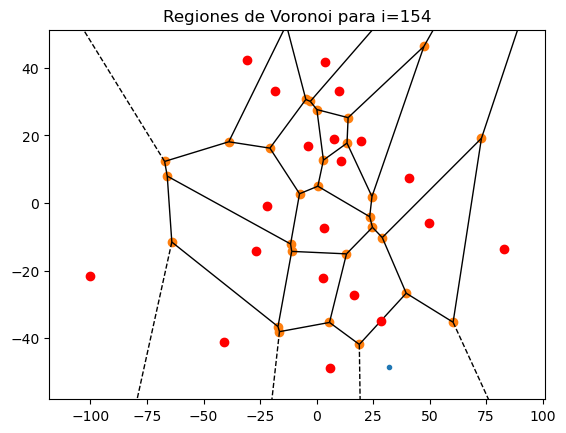

0.4439153284799819 153


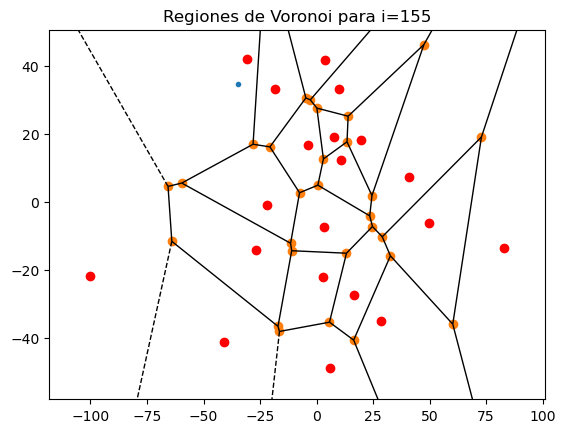

0.04725730793633594 154


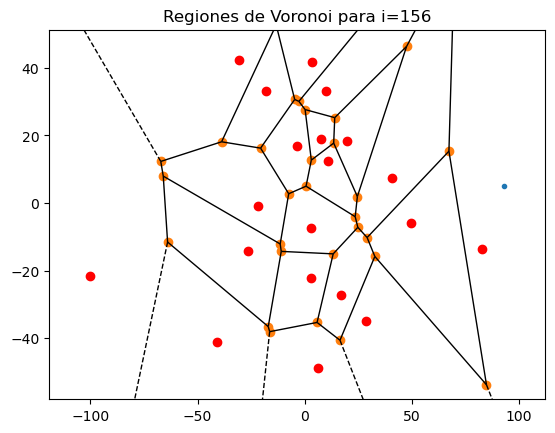

0.1341427488537216 155
119.33972832308805 28


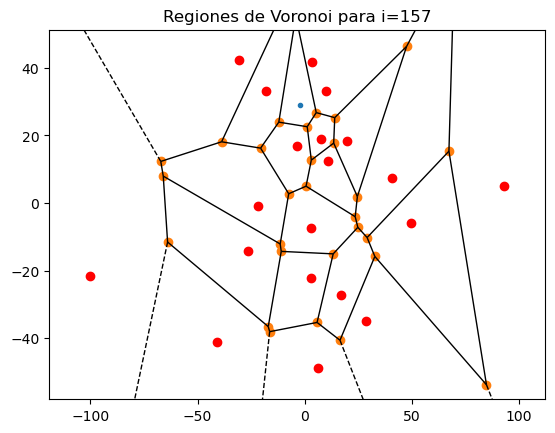

1 156
169.61472795132408 29


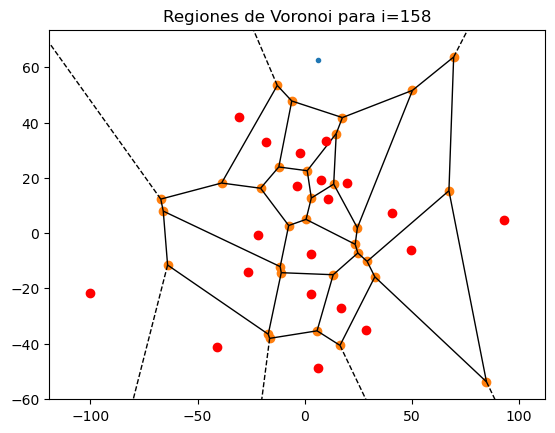

1 157
187.51566456350736 30


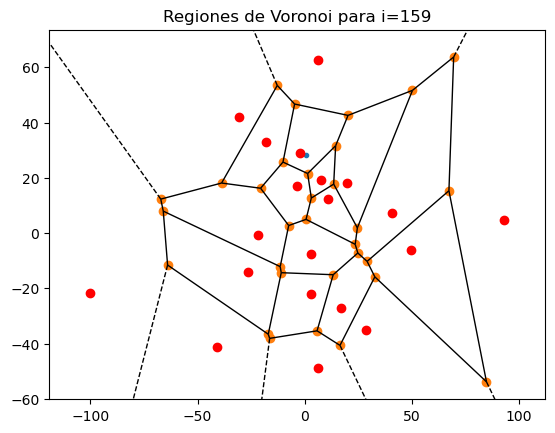

0.9863484997200682 158
184.95579441622704 31


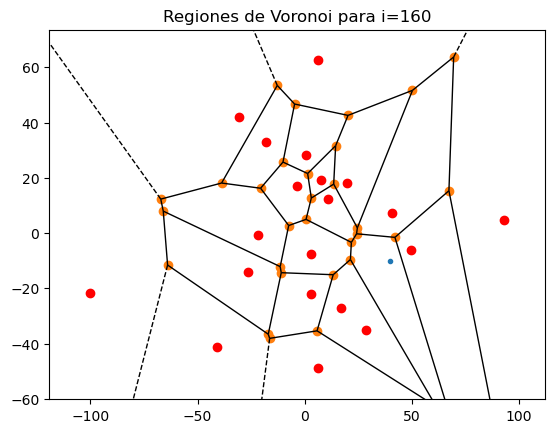

0.4606363829573052 159


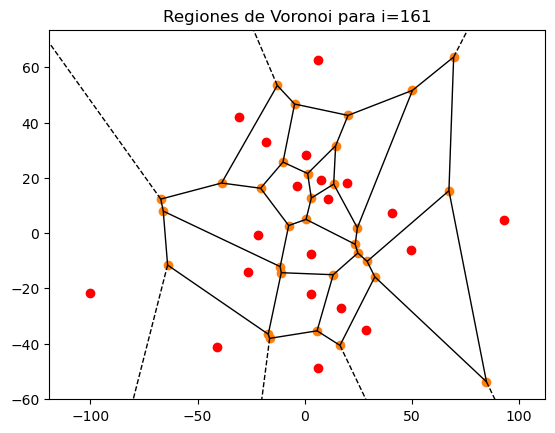

0.49409710606805735 160


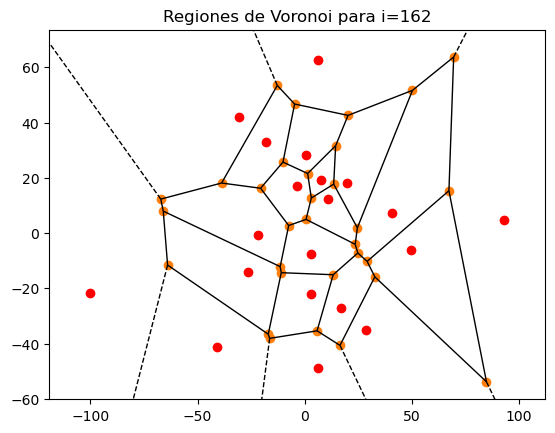

0.49409710606805735 161
91.38612277157634 32


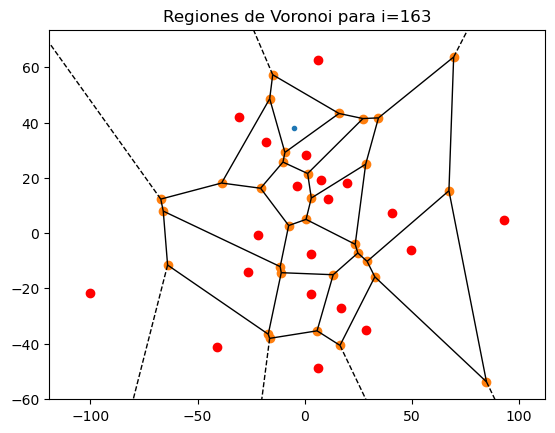

1 162
123739.76506575254 33


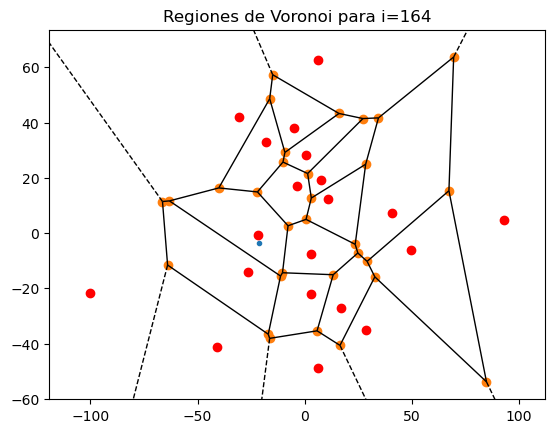

0.0005869944172899995 163


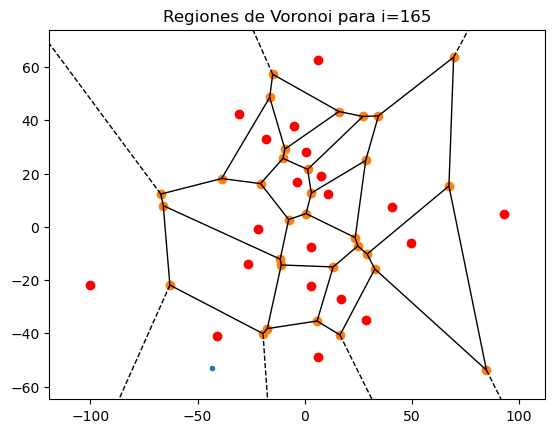

0.003205640232164358 164


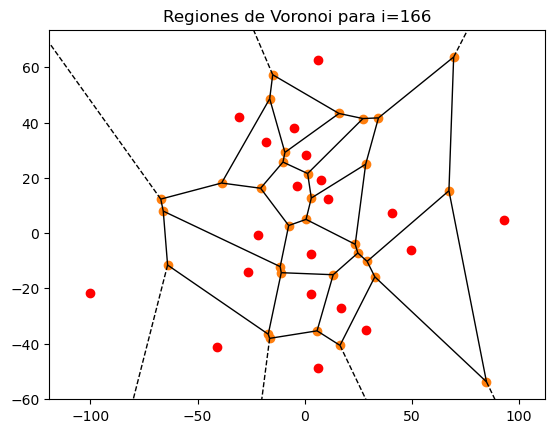

0.5025009851728379 165


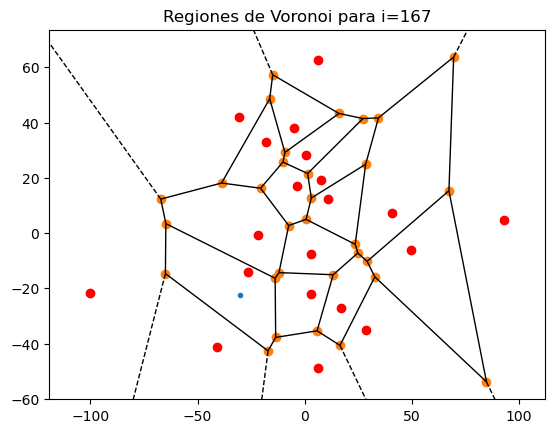

0.0009687276697020521 166


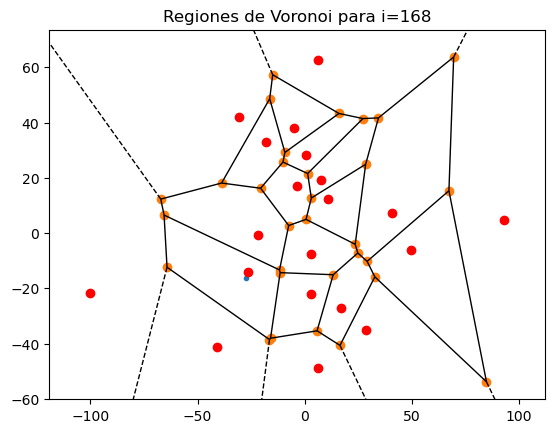

0.004203045259073665 167


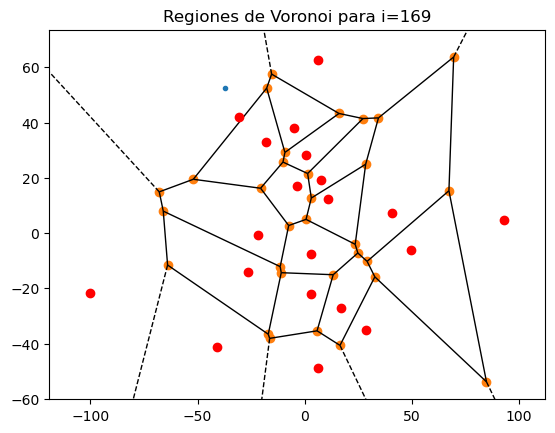

0.881736055003867 168


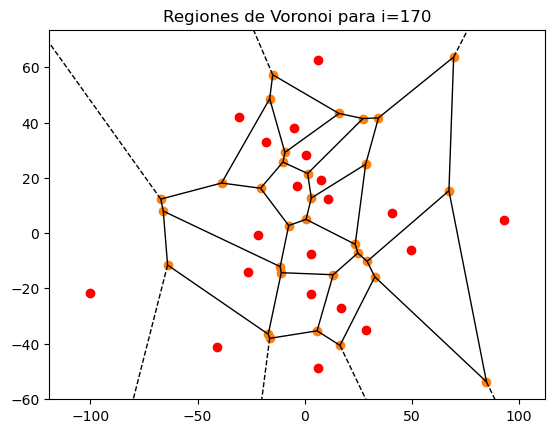

0.5025009851728379 169


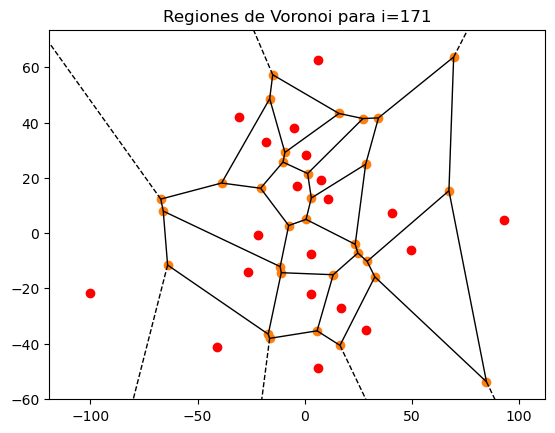

0.5025009851728379 170


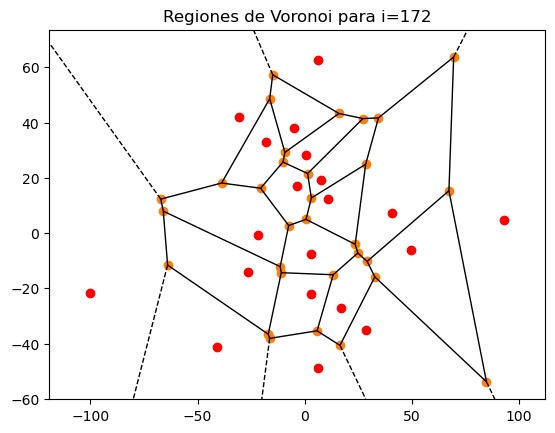

0.5025009851728379 171


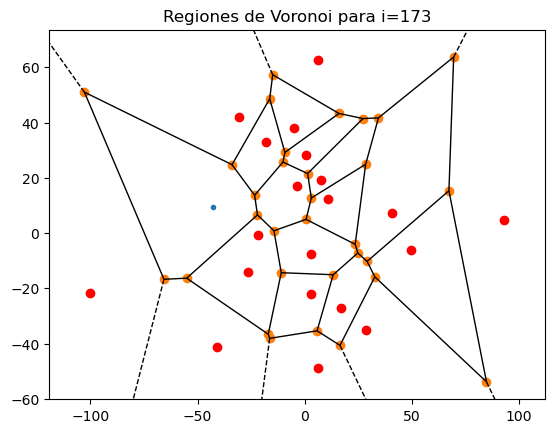

0.0003472116169853366 172


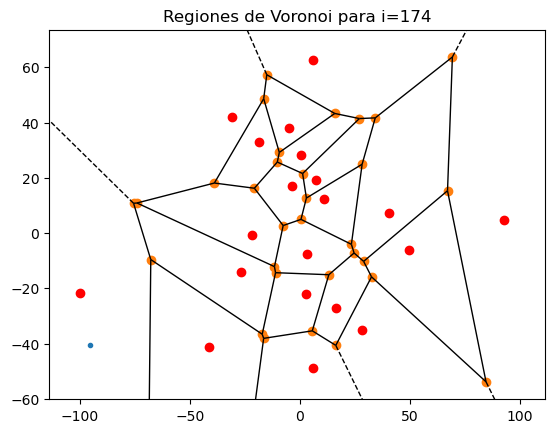

0.5019452129253226 173
62110.58272325855 34


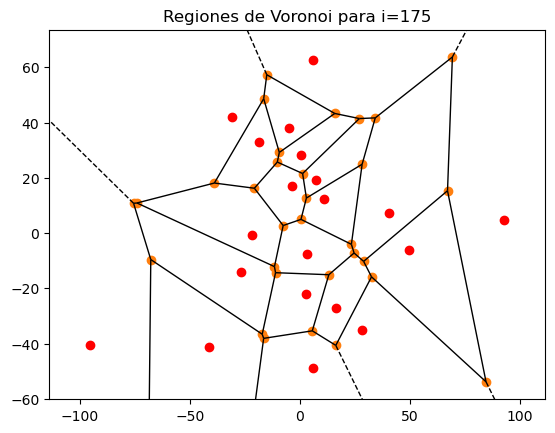

1 174
62110.58678770708 35


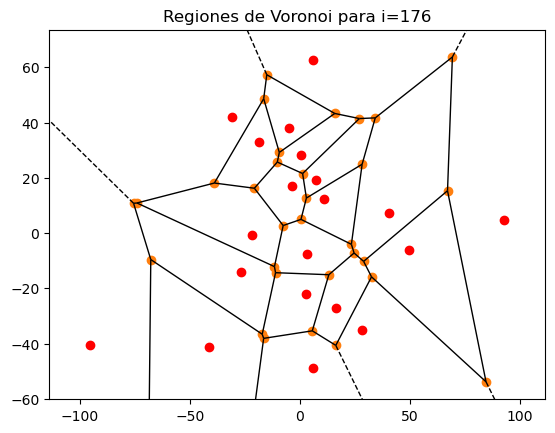

1 175
62110.58678770708 36


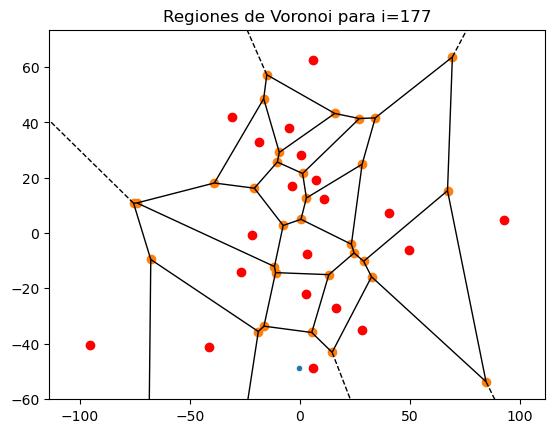

1 176
62113.87307278859 37


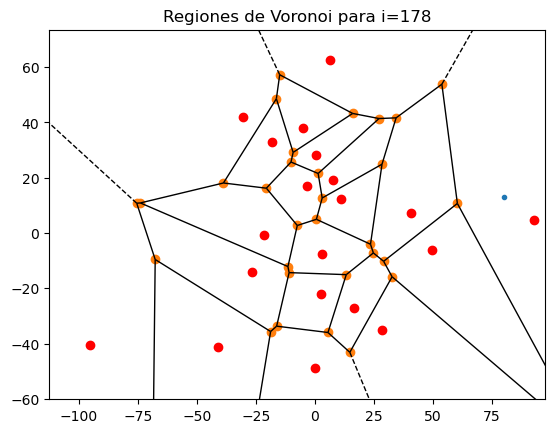

1 177
62114.42063652755 38


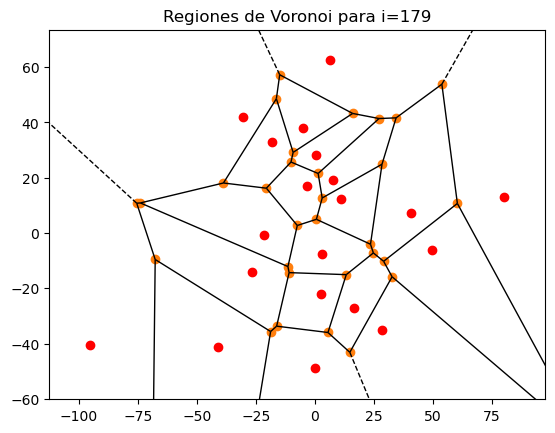

0.999999805383579 178
62114.40854804132 39


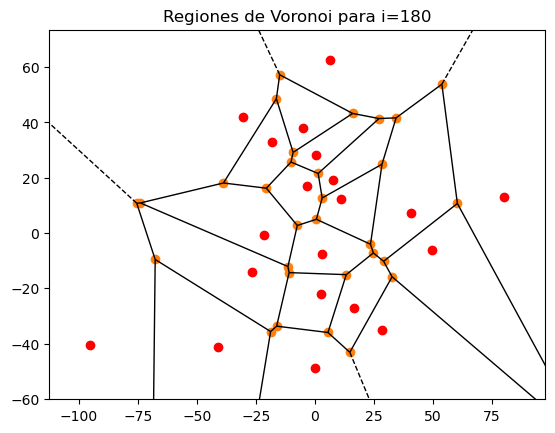

1 179
62114.40854804132 40


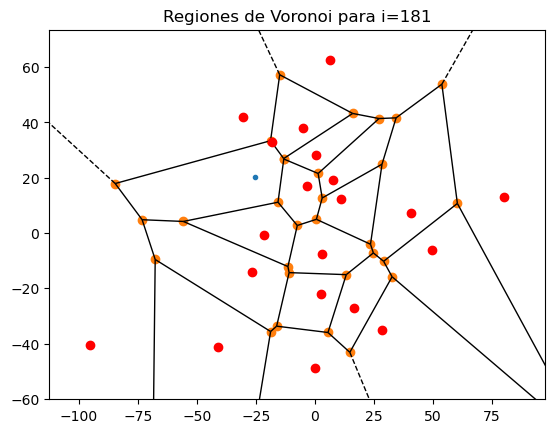

0.00031834969240054147 180


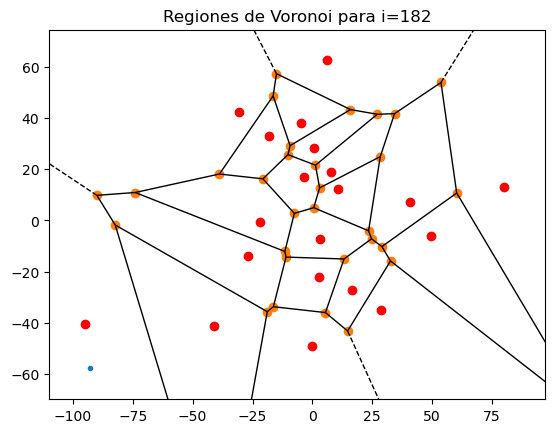

0.0008875533494681589 181


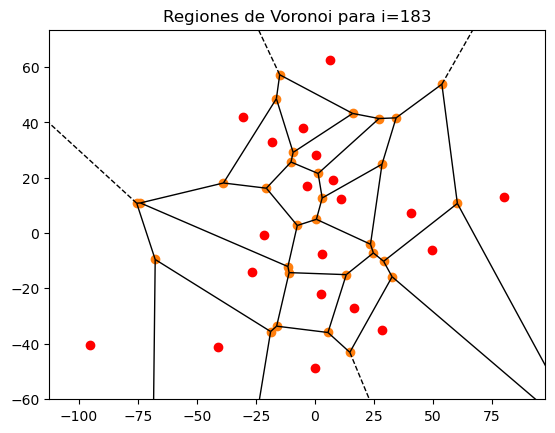

1 182
62114.40854804132 41


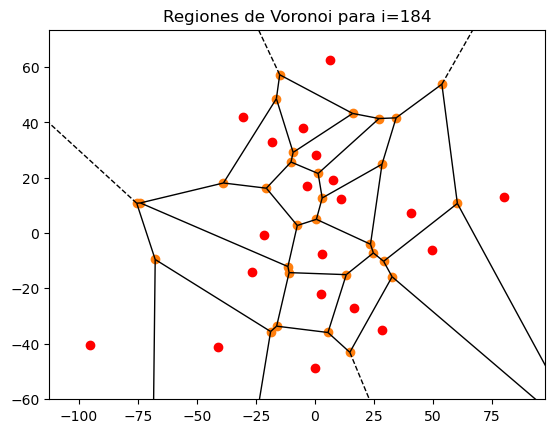

1 183
62114.40854804132 42


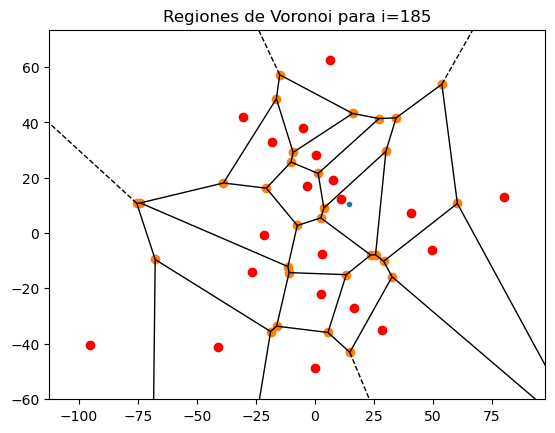

7.333428986930964e-05 184


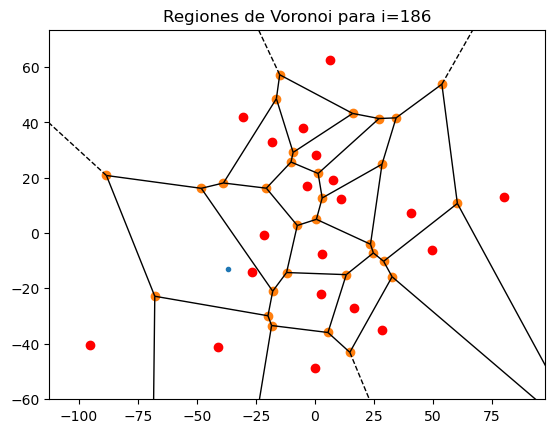

0.0013321093137206017 185


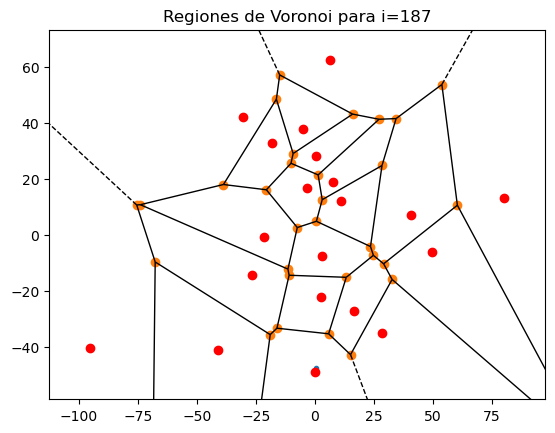

1 186
62116.226271468186 43


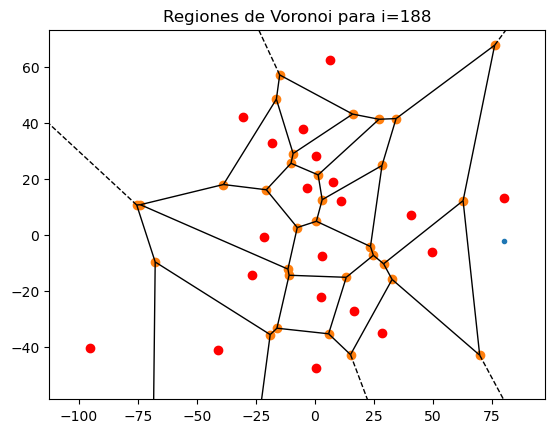

0.0009580710518608439 187


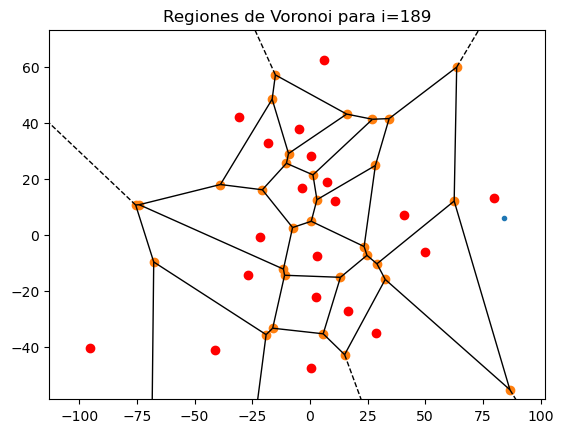

0.9999889568965424 188
62115.540315555074 44


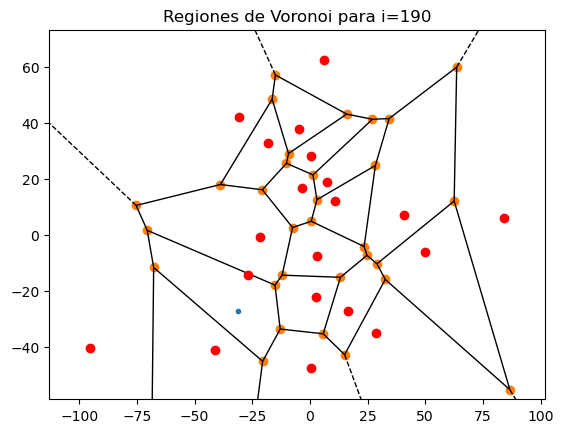

0.0008230535183074702 189


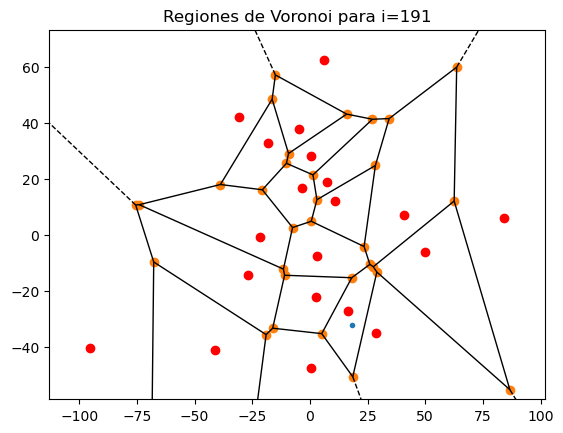

0.001956838743429736 190


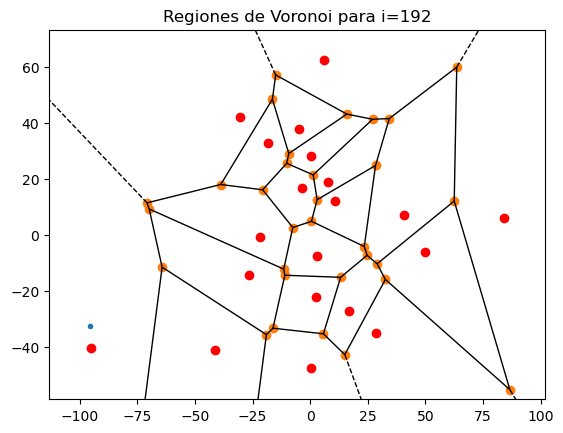

0.9999567091606714 191
62112.85128167946 45


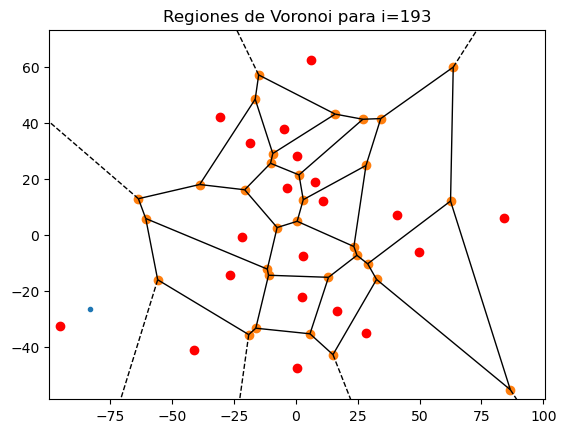

0.00607367267982214 192


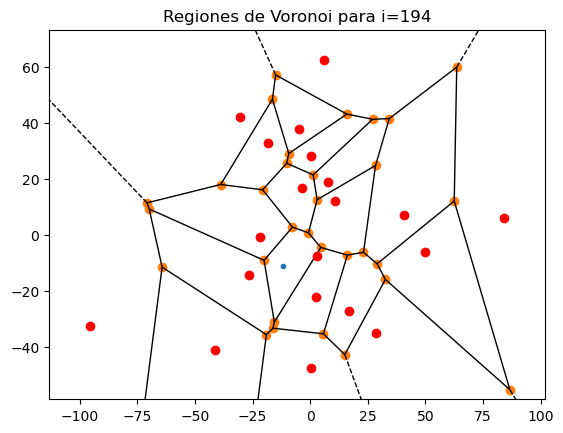

4.105248093100501e-05 193


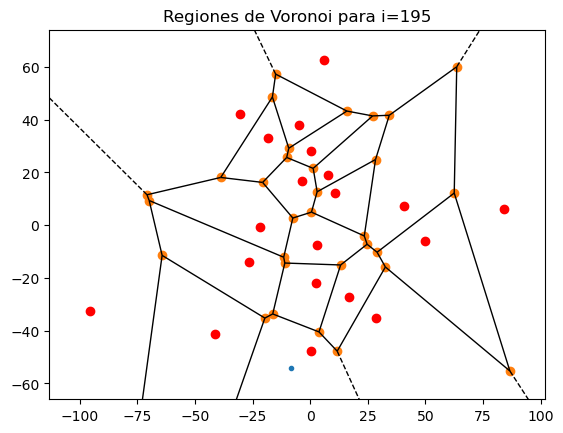

0.0040721553437793176 194


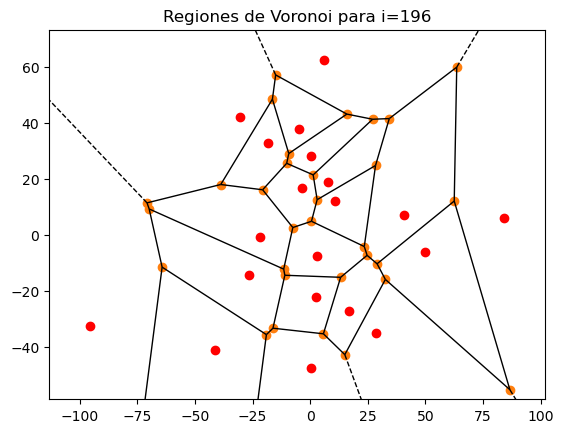

0.9999999961709358 195
62112.85104384537 46


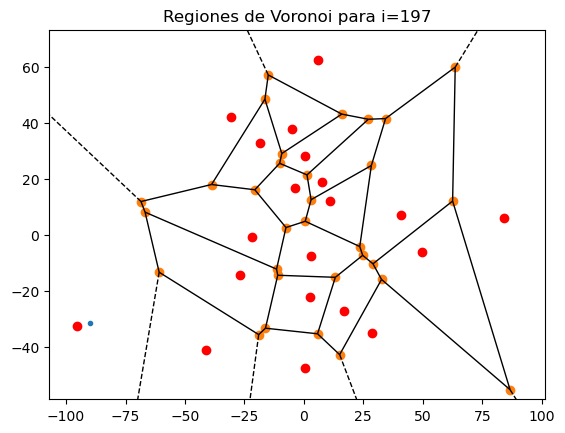

1 196
62125.00709013703 47


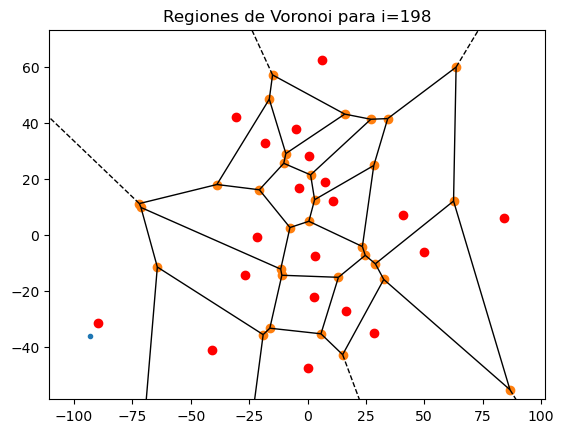

0.9998047636128297 197
62112.87802819982 48


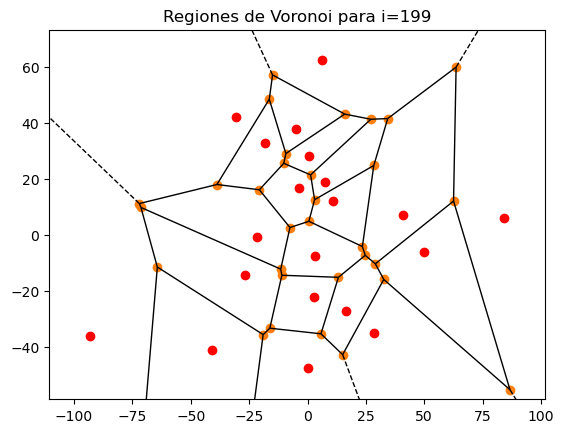

1 198
62112.878115968946 49


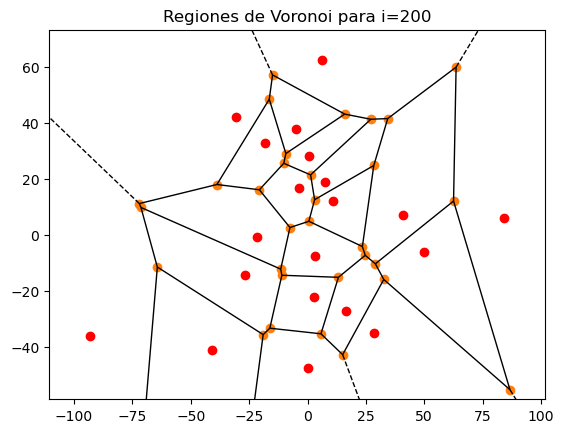

1 199
62112.878115968946 50


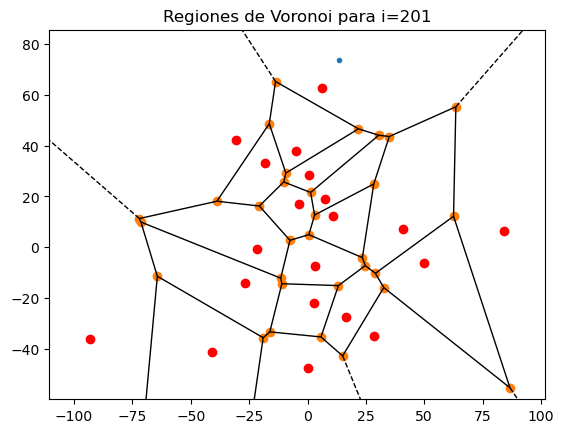

0.00033008254221117373 200


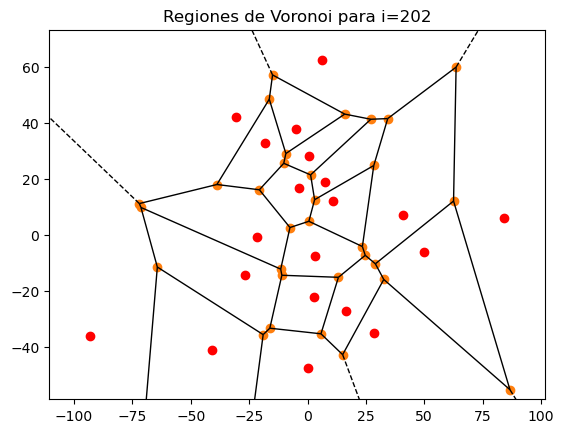

1 201
62112.878115968946 51


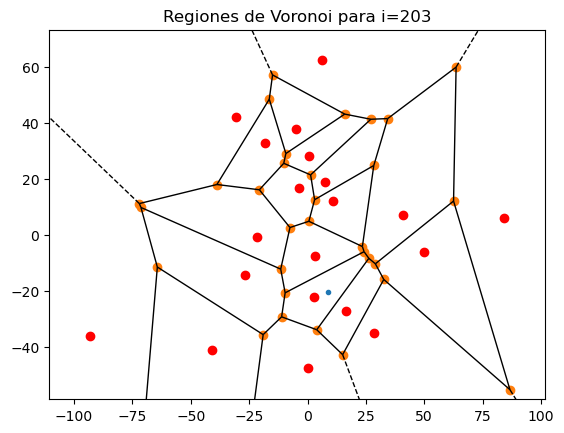

3.0232017616952847e-05 202


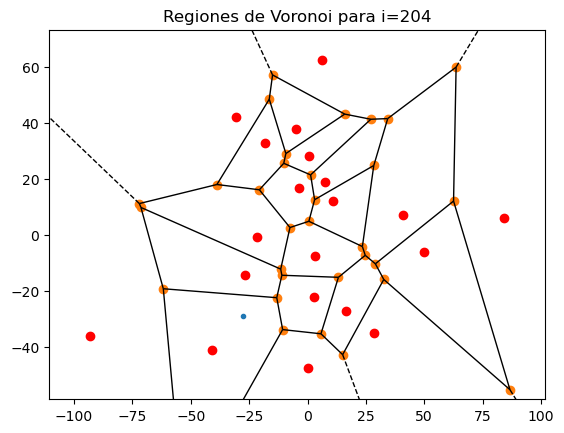

1 203
62208.686423848354 52


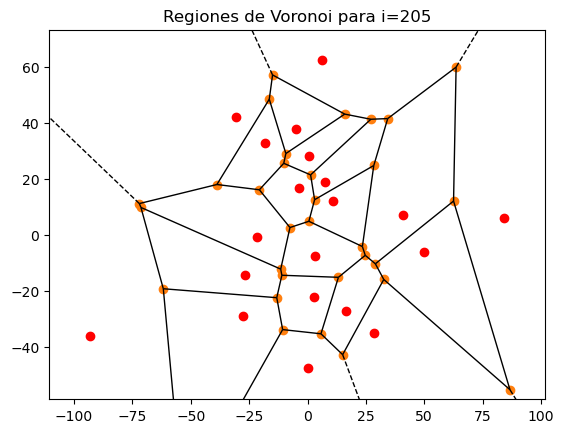

0.9984076430587732 204
62109.62799021674 53


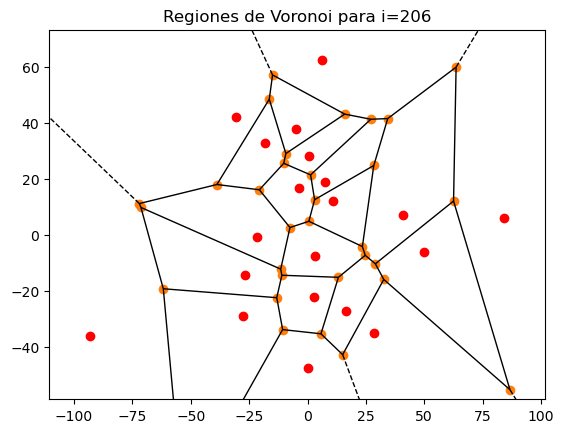

1 205
62109.62799021674 54


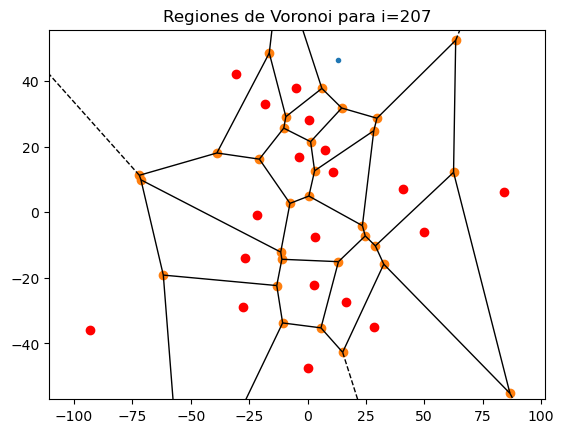

4.5577339369273834e-05 206


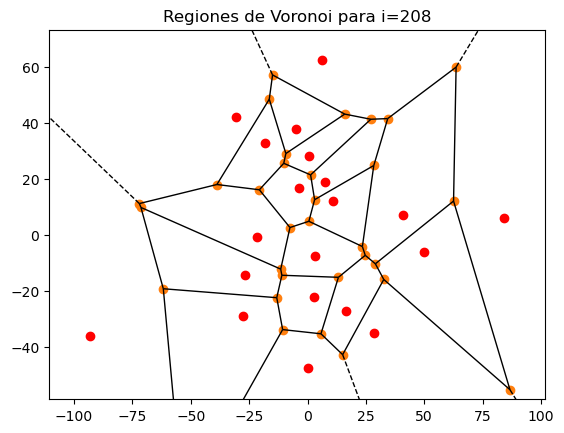

1 207
62109.62799021674 55


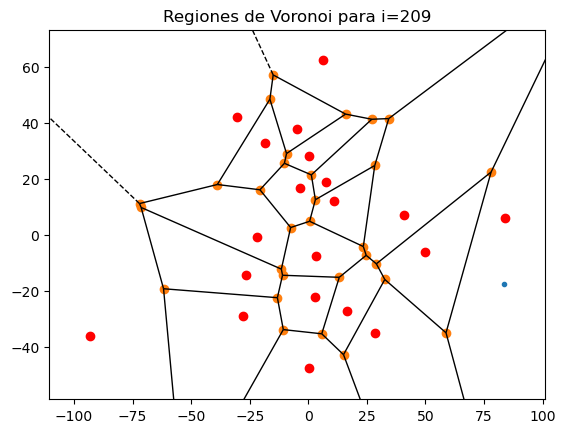

0.00035246201794604043 208


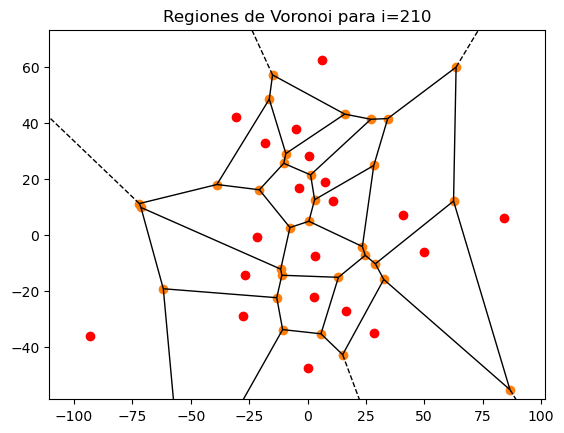

1 209
62109.62799021674 56


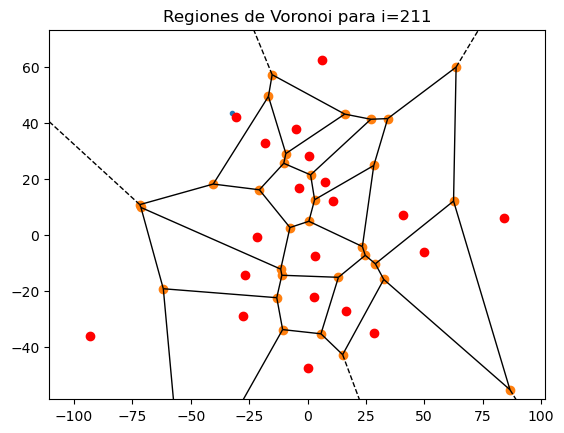

1 210
109045.2154434413 57


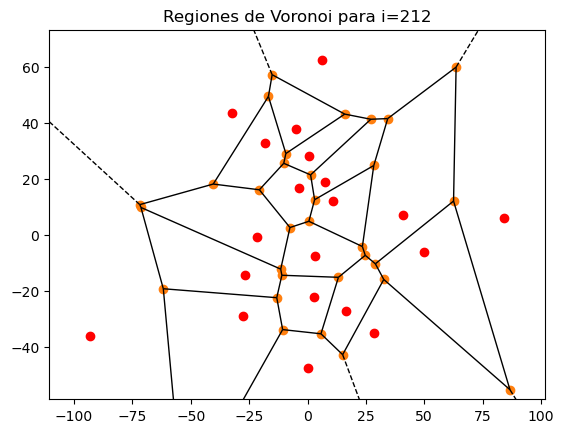

0.5696002956681381 211


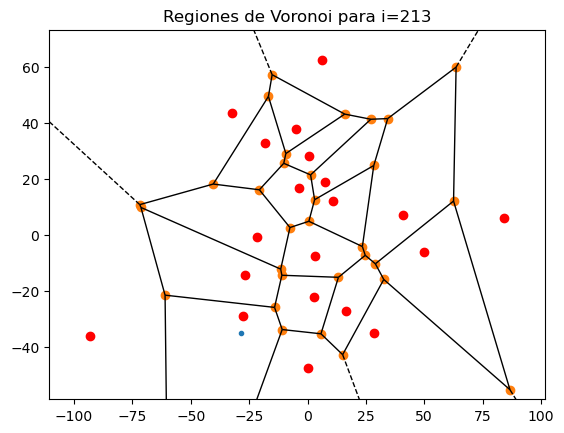

0.5695683067630174 212


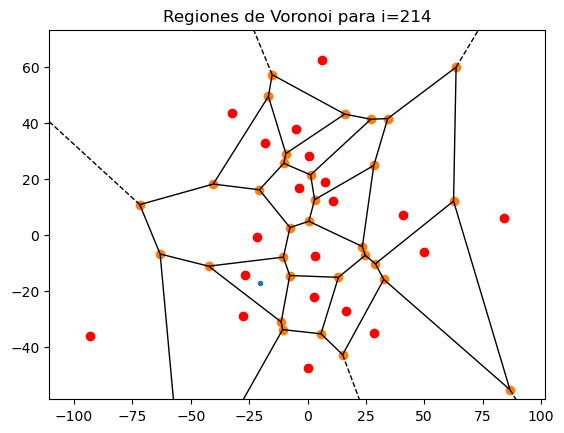

0.0005868797770266228 213


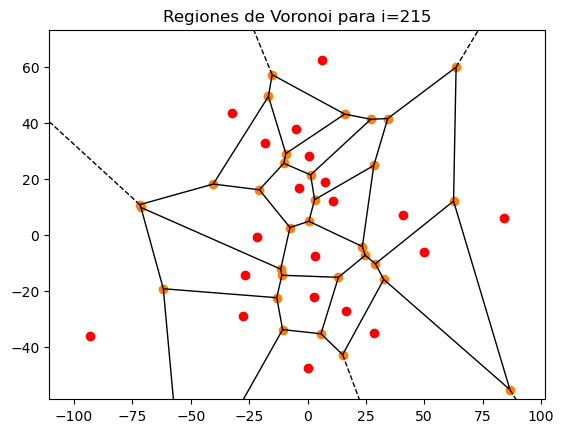

0.5696002956681381 214


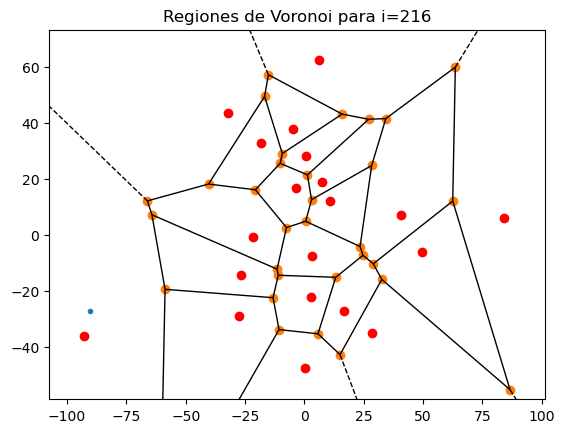

0.5695594760289122 215


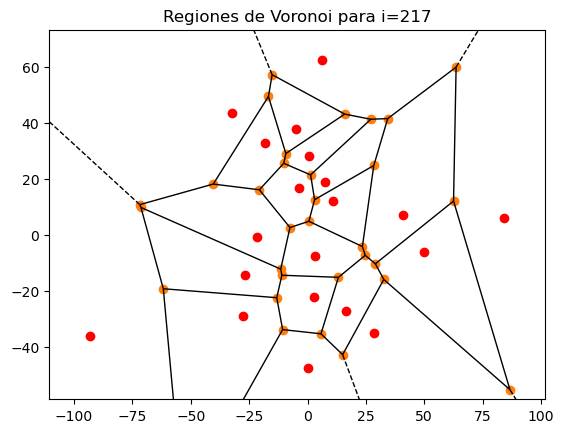

0.5696002956681381 216
62112.18695777998 58


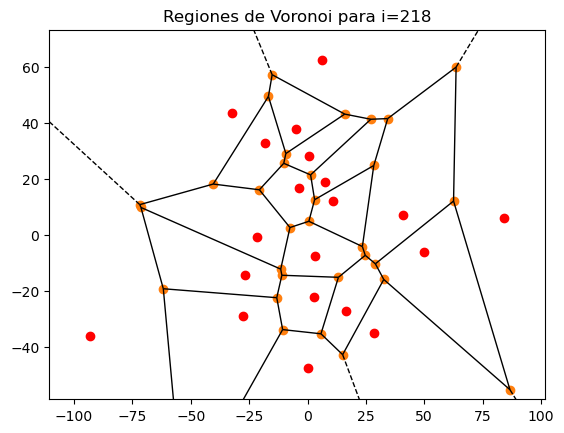

1 217
62112.18695777998 59


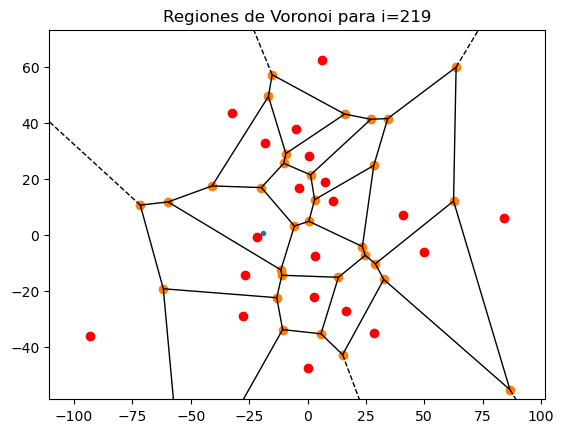

0.000863090102352752 218


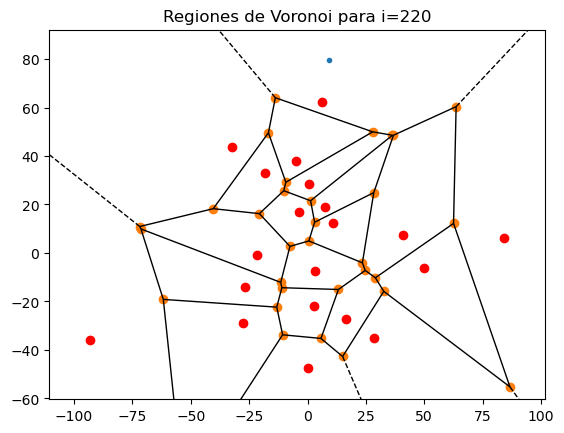

6.0139095162911e-05 219


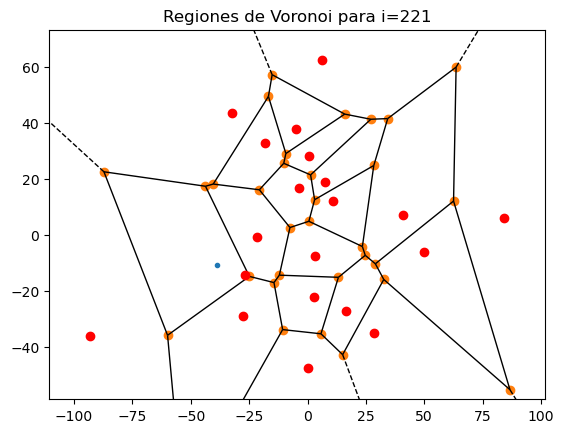

3.970842110700823e-05 220


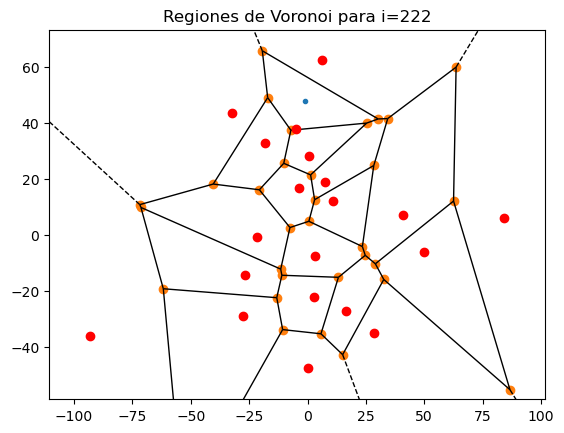

1 221
502126.911638716 60


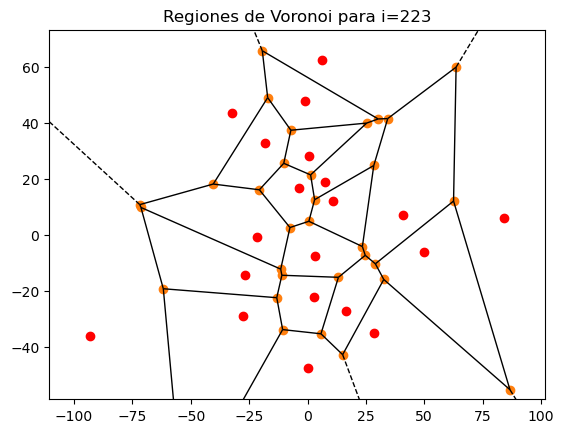

0.12370241754503851 222


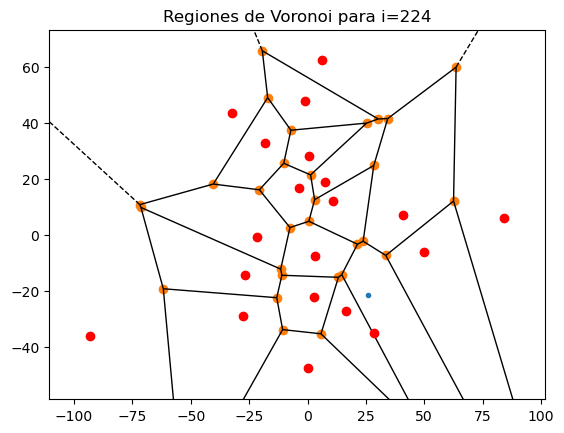

0.000321981930669847 223


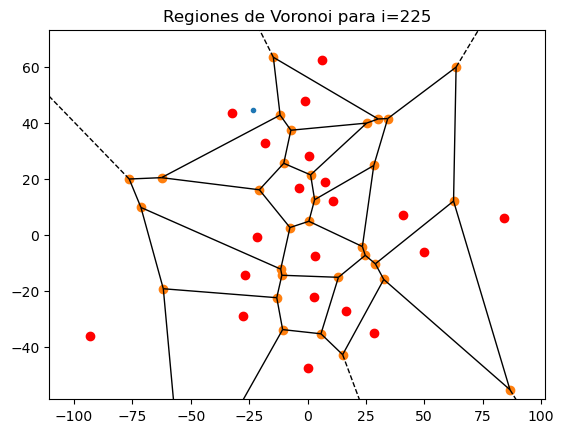

4.84106741497057e-05 224


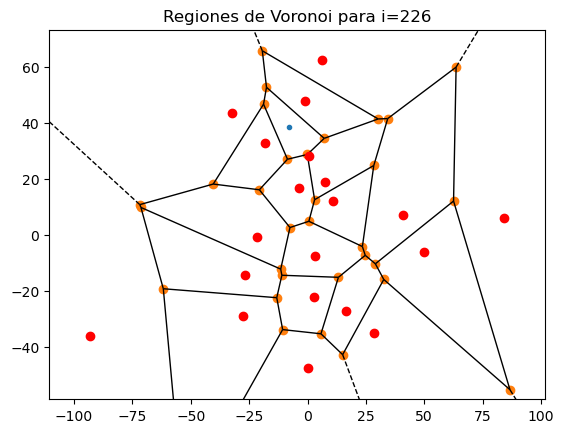

0.12369695058246517 225


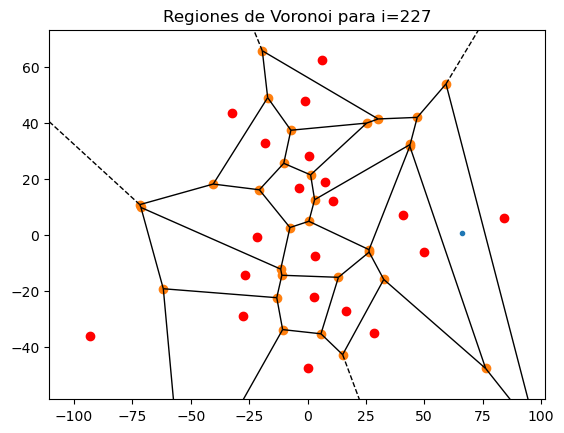

1.808642350410296e-05 226


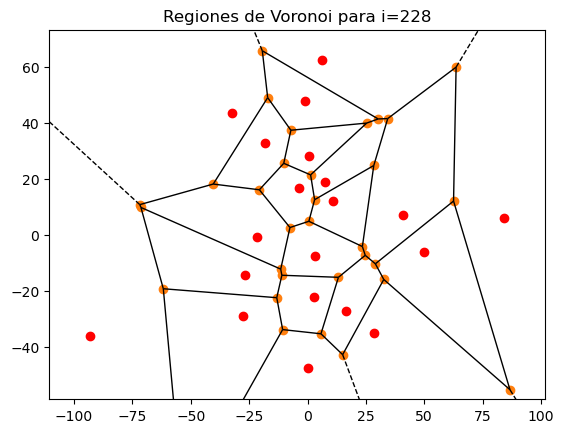

0.12370241754503851 227


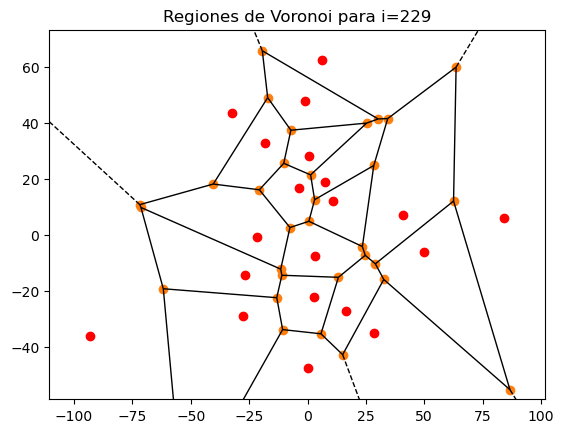

0.12370241754503851 228


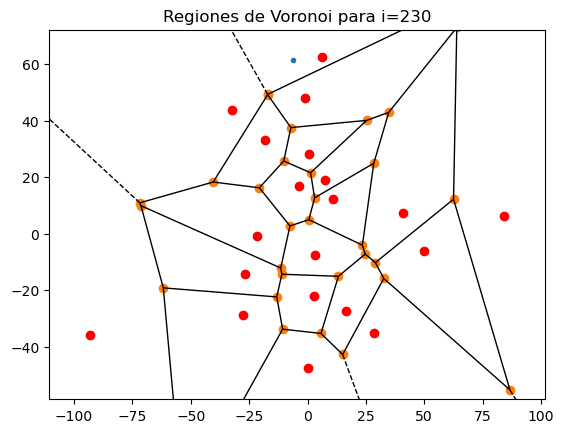

0.00782511329927355 229


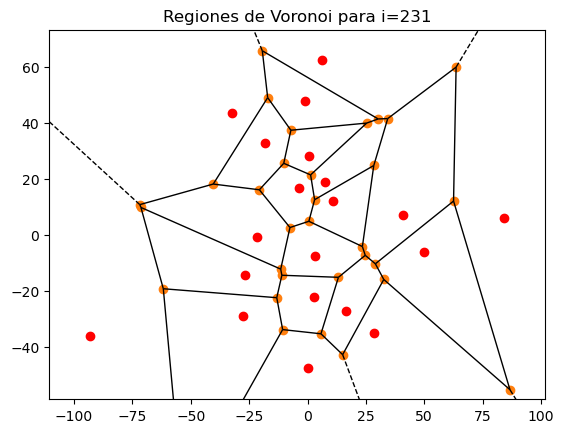

0.12370241754503851 230


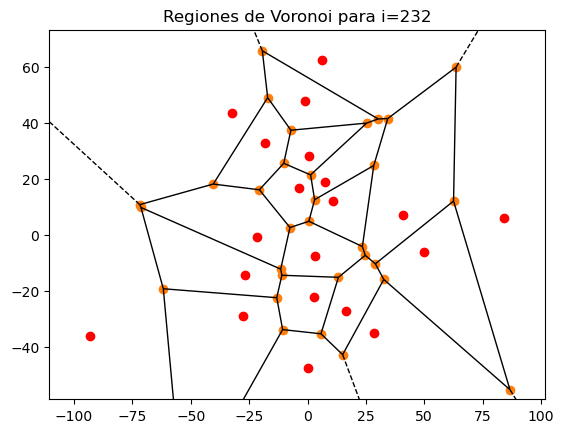

0.12370241754503851 231


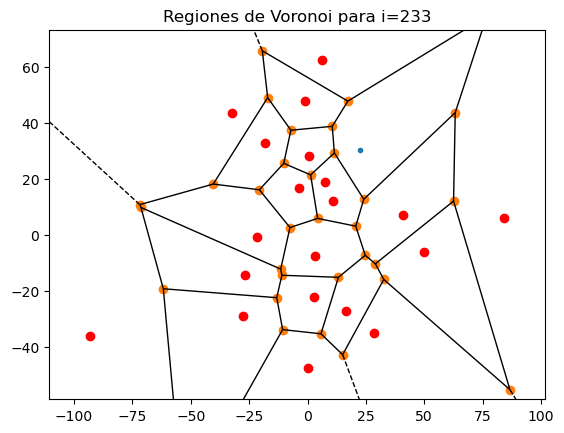

2.34661672830393e-05 232


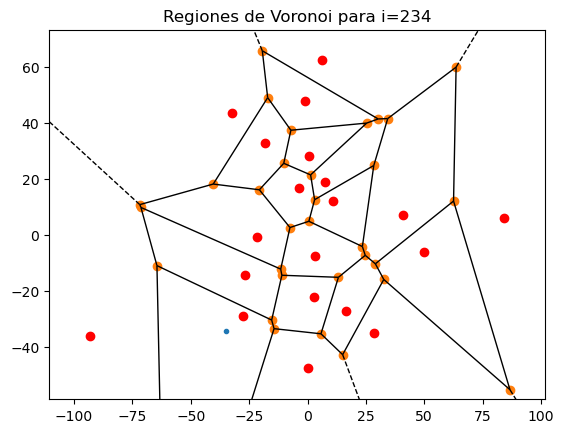

0.12369488406643647 233


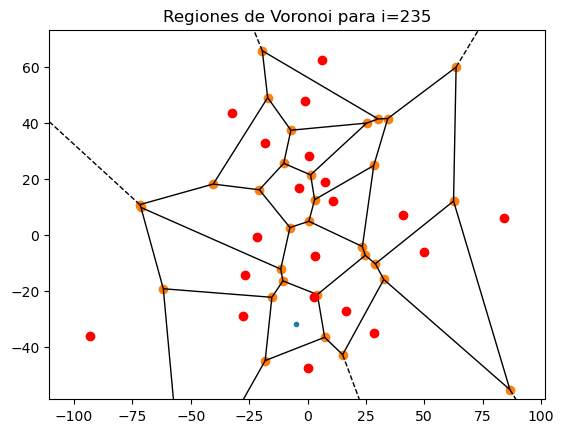

0.0005580831572143567 234


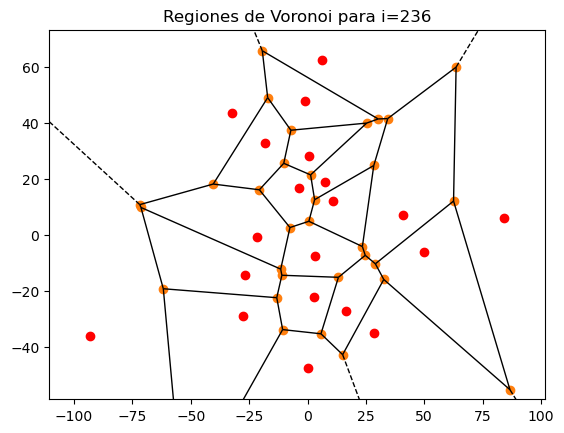

0.12370241754503851 235


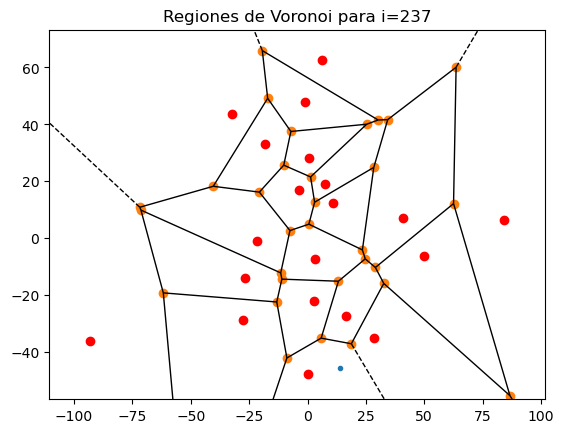

0.0002182507483792687 236


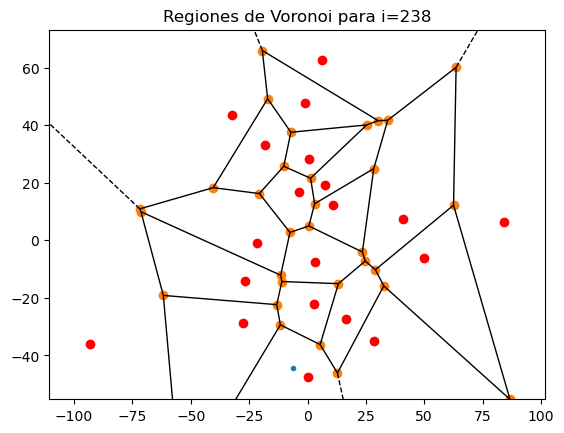

3.361775400772689e-05 237


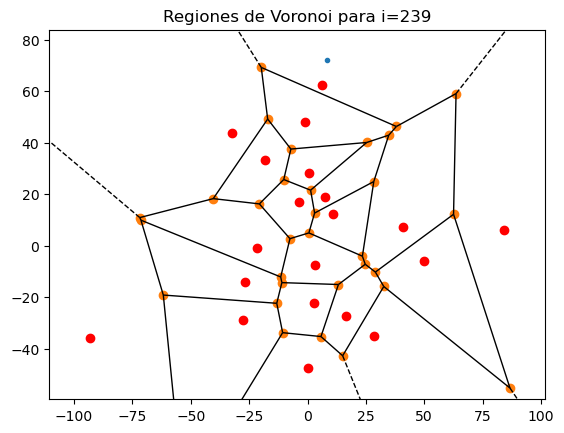

0.00011755835317296756 238


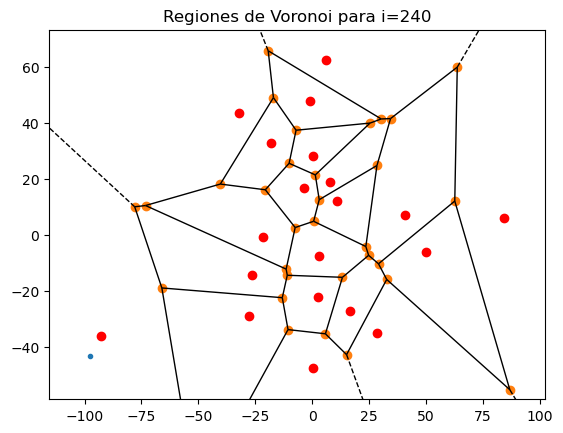

0.12369232774690858 239


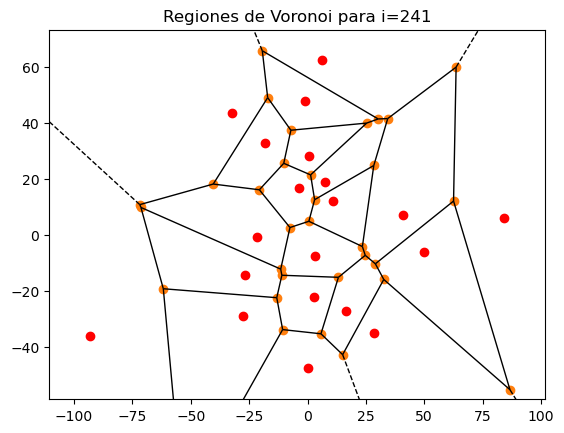

0.12370241754503851 240


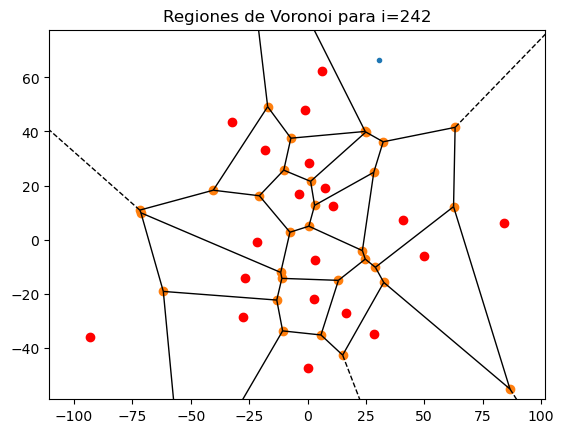

0.023104509812094255 241


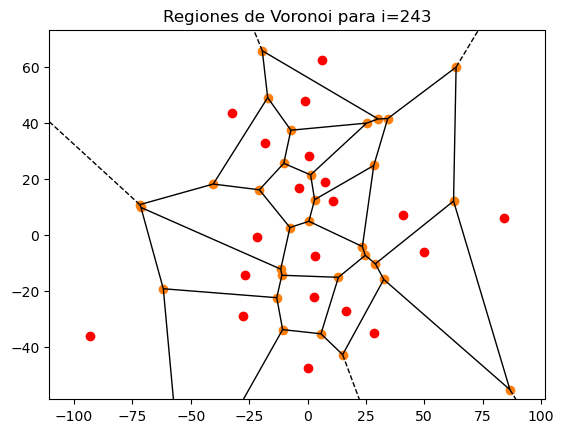

0.12370241754503851 242


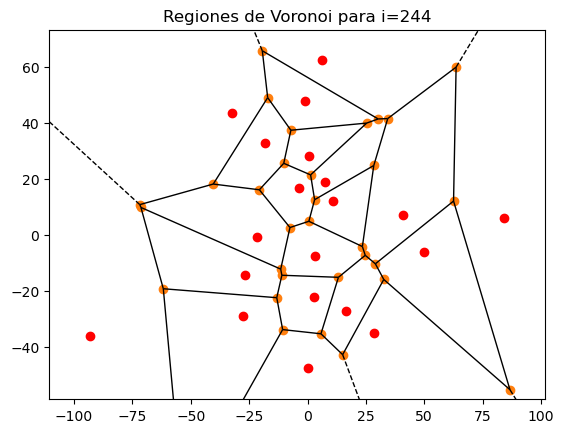

0.12370241754503851 243


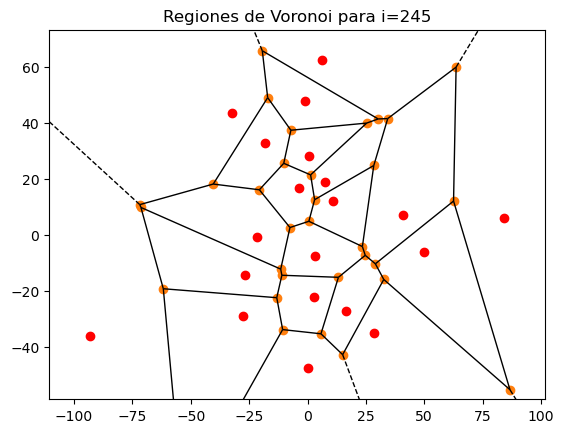

0.12370241754503851 244


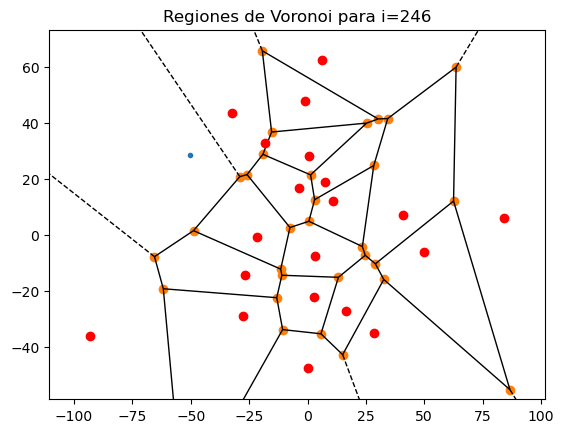

0.12369087452298556 245


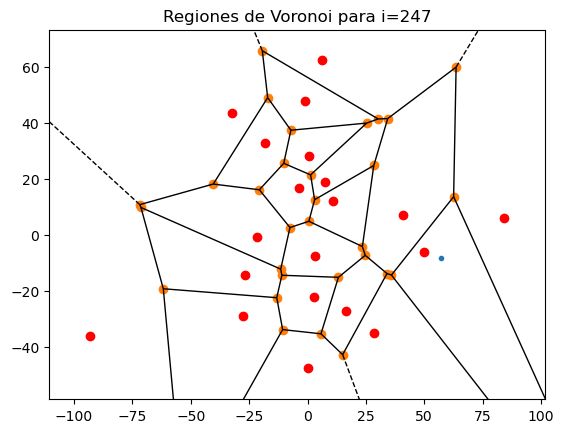

1.4040009913664825e-05 246


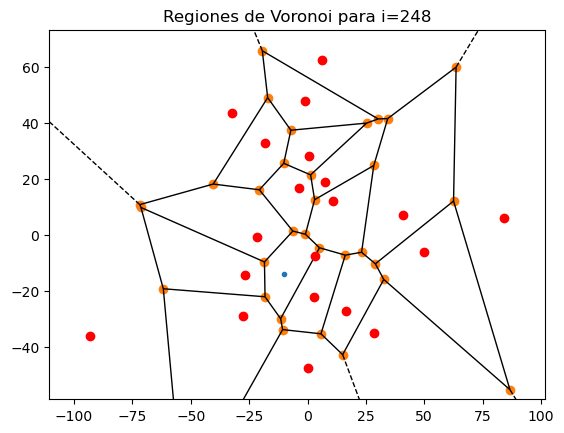

0.0006000435782553962 247


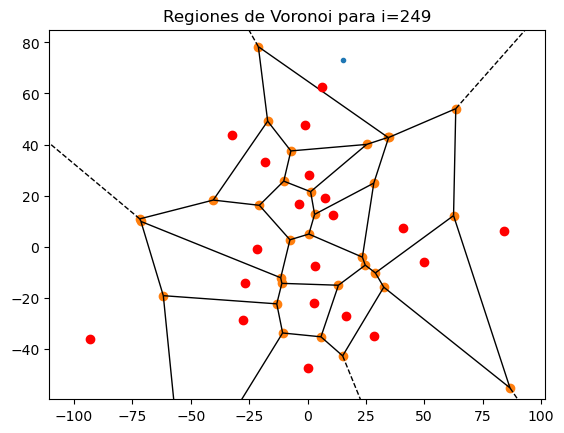

0.011243321020998103 248


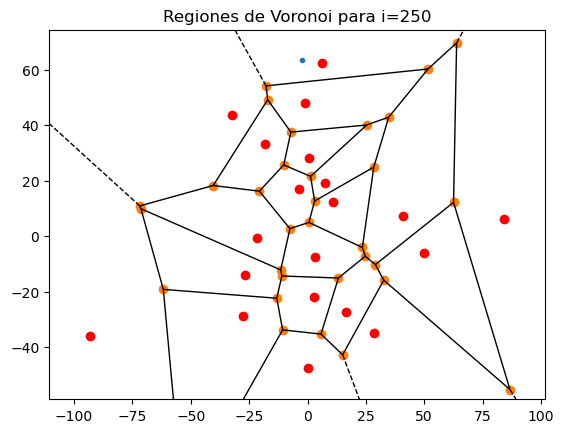

6.244868917773311e-05 249


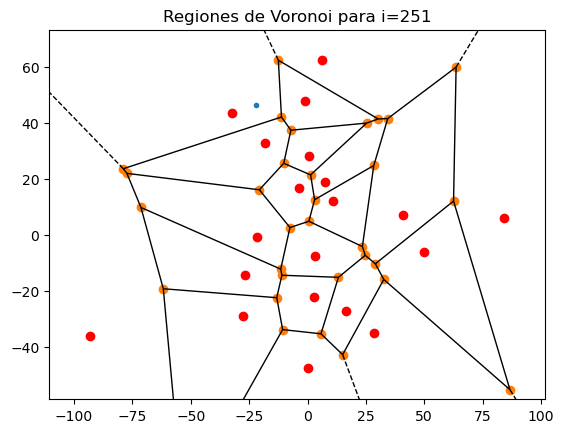

5.718393958713952e-05 250


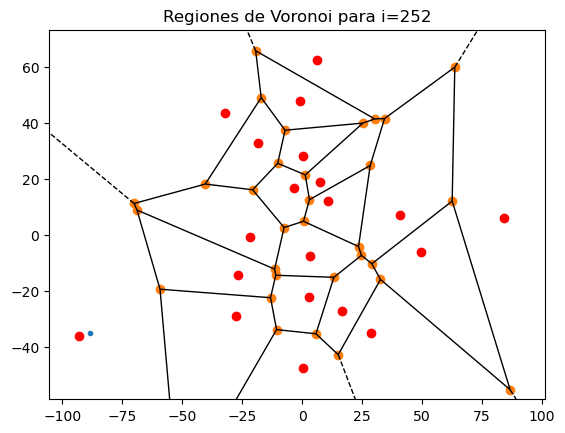

4.626363701964972e-05 251


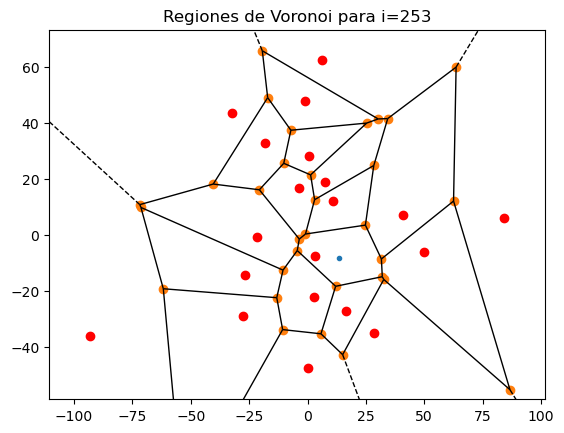

1.428951647662936e-05 252


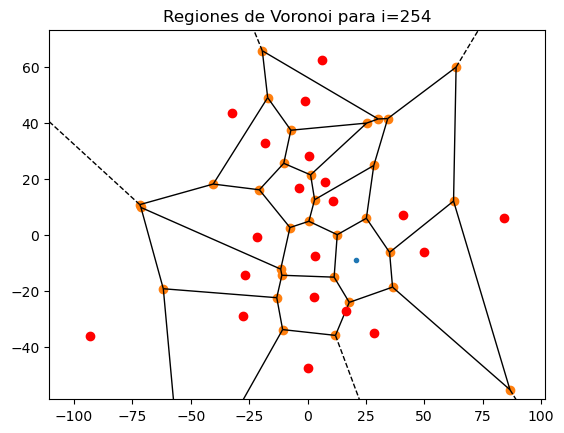

3.004084032267442e-05 253


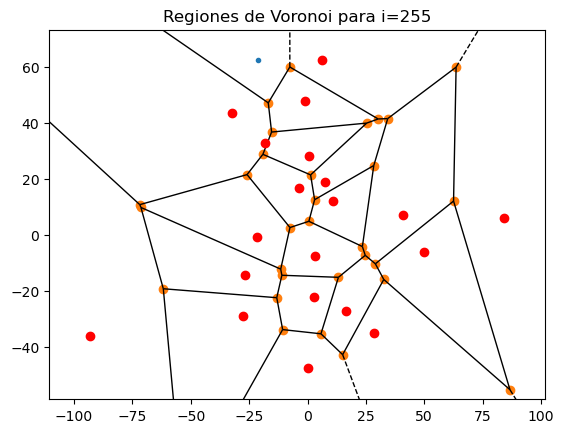

0.00025157784907401743 254


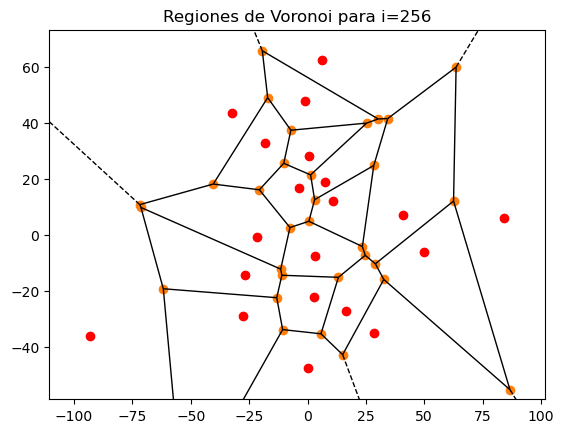

0.12370241754503851 255


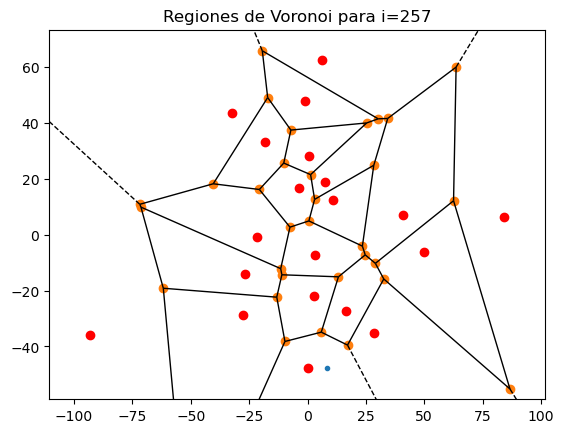

0.12369912882048859 256


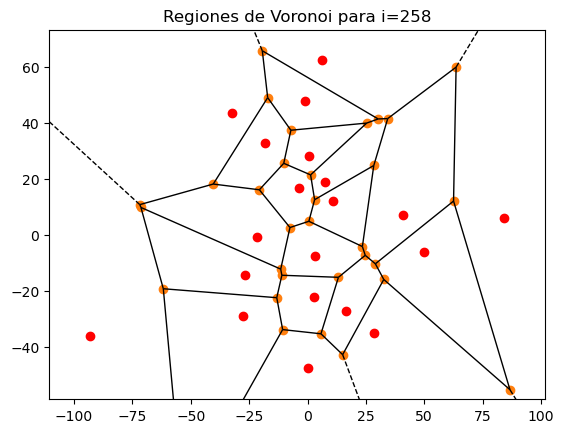

0.12370241754503851 257


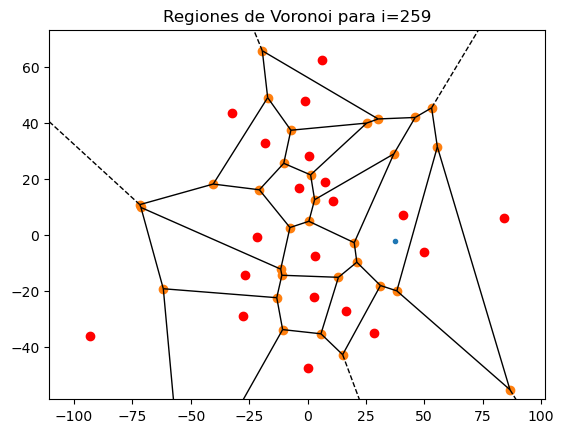

3.6594471451878895e-05 258


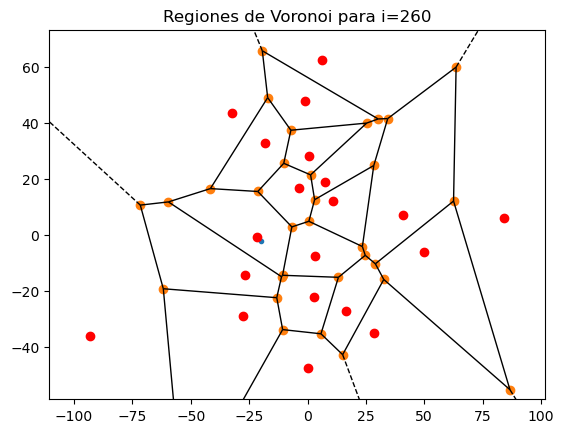

0.00012488827634829372 259


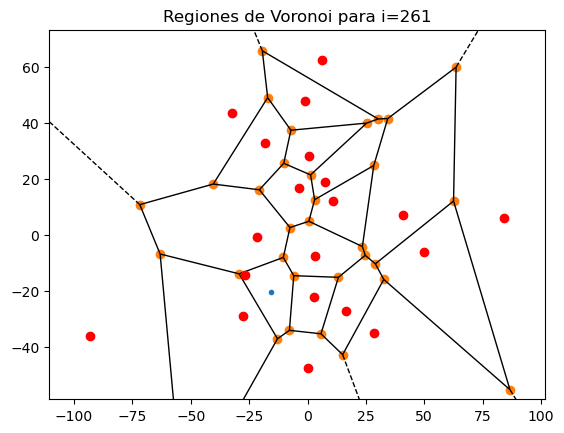

6.194154315808942e-05 260


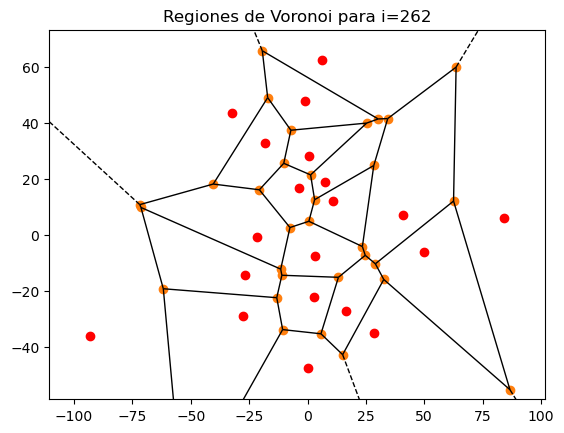

0.12370241754503851 261


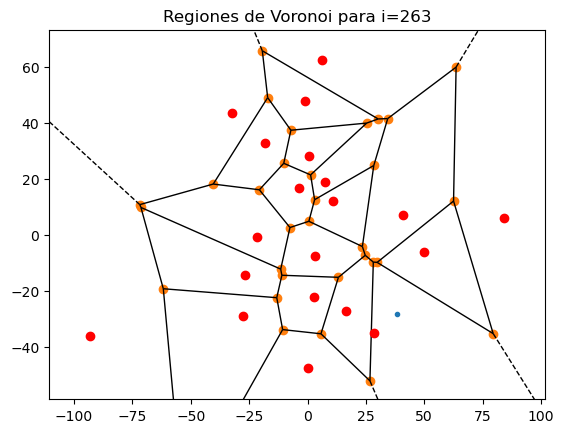

0.1614003101248157 262


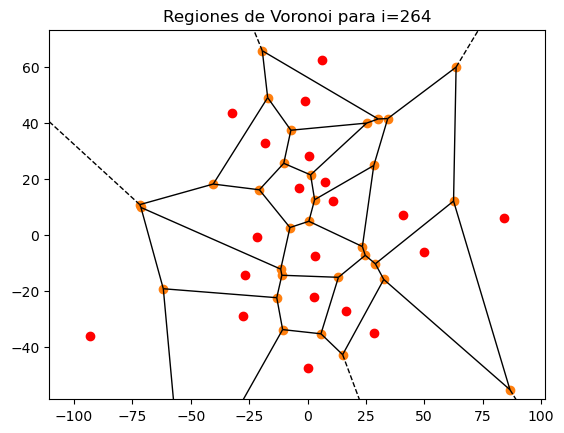

0.12370241754503851 263


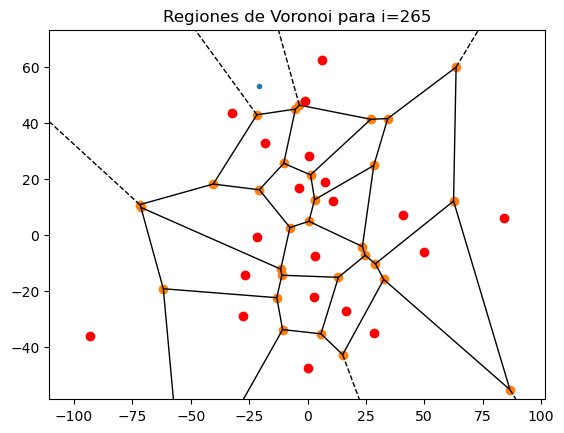

0.12382062396461983 264


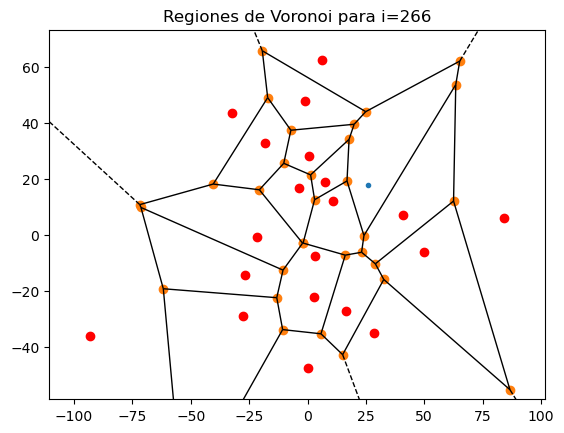

3.403728405060997e-05 265


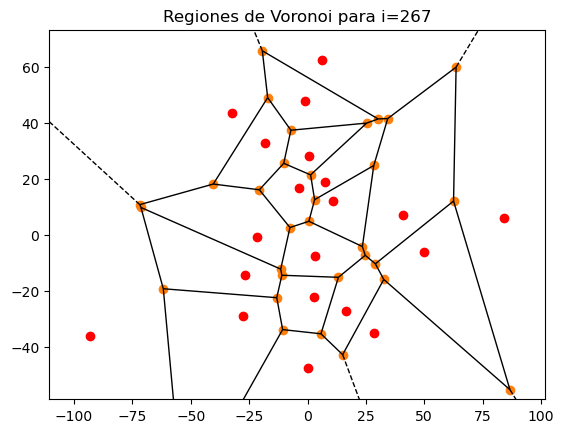

0.12370241754503851 266


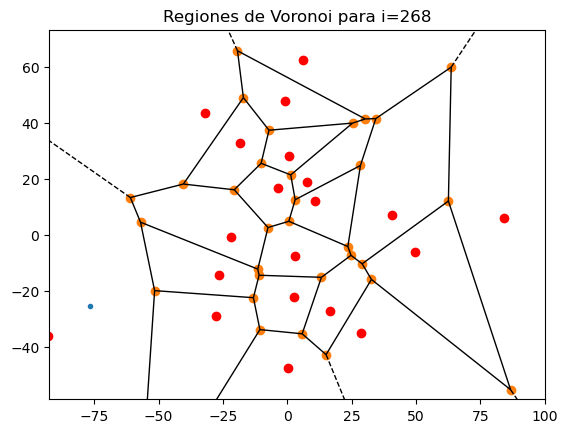

4.296523829210836e-05 267


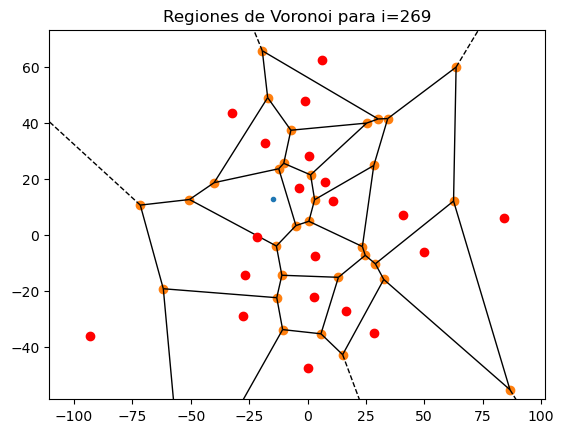

7.384320258274996e-05 268


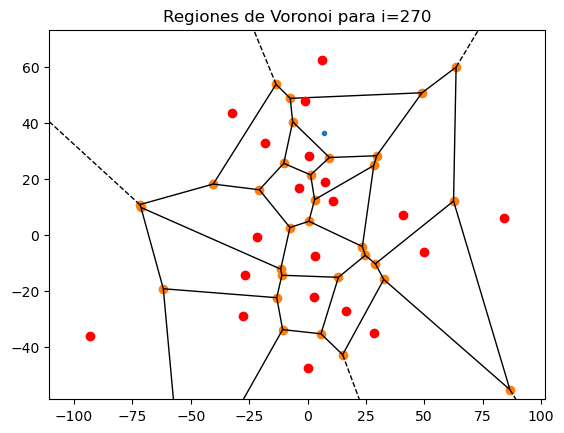

3.511850765522406e-05 269


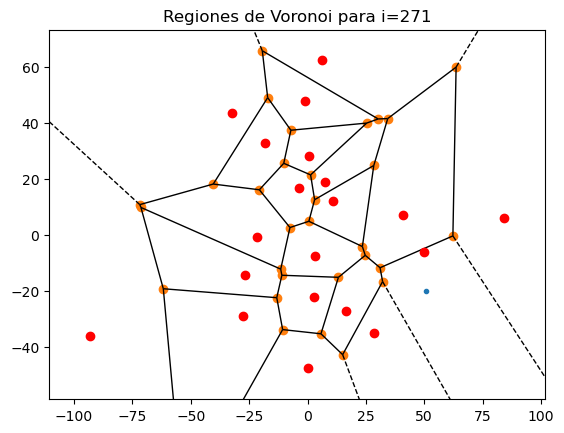

0.30119467534249017 270


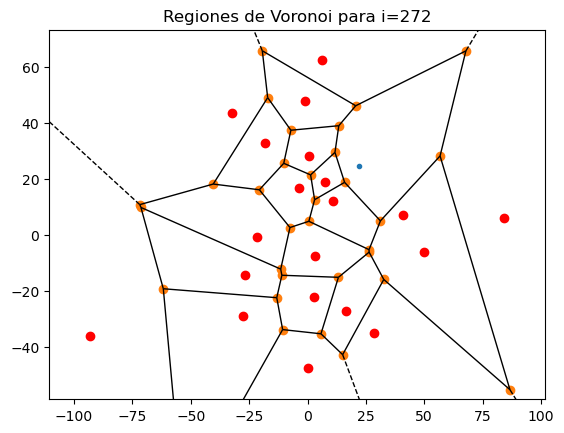

1.3742317745466442e-05 271


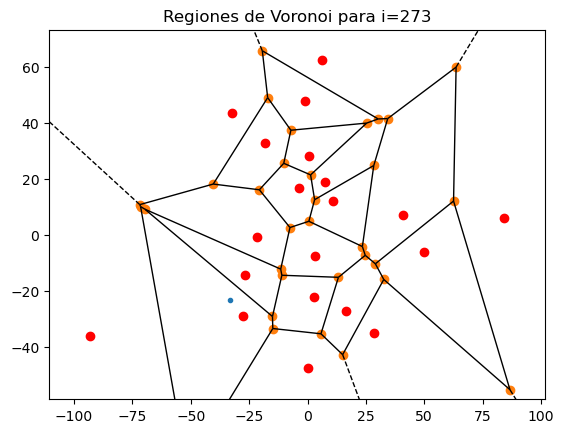

0.1237174819036549 272


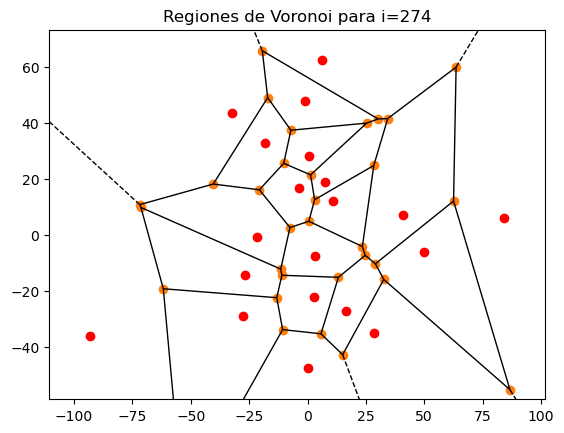

0.12370241754503851 273


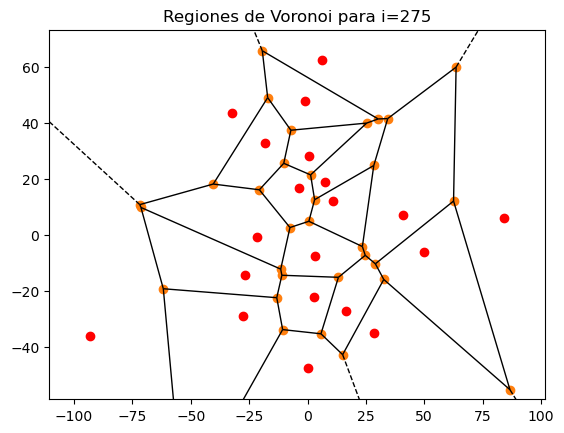

0.12370241754503851 274


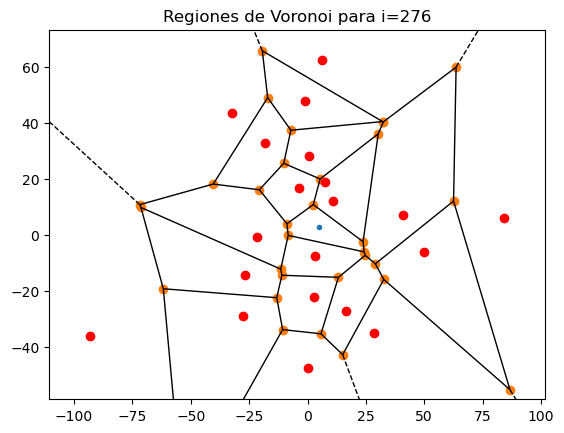

4.521471577631782e-05 275


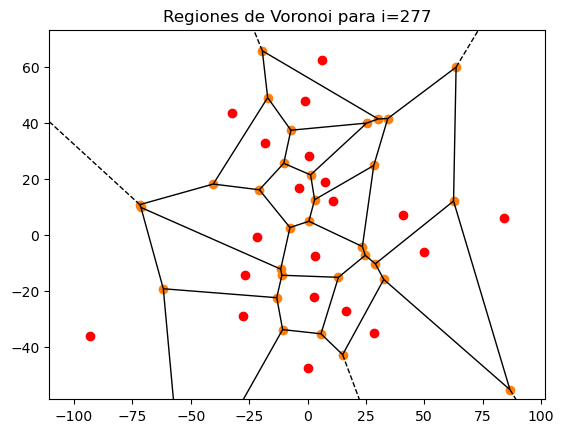

0.12370241754503851 276


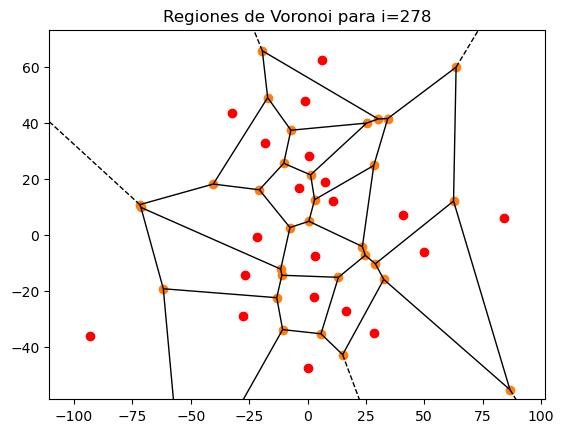

0.12370241754503851 277


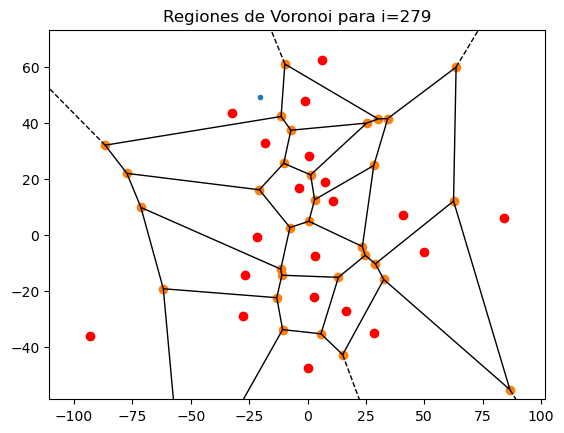

4.929705180454384e-05 278


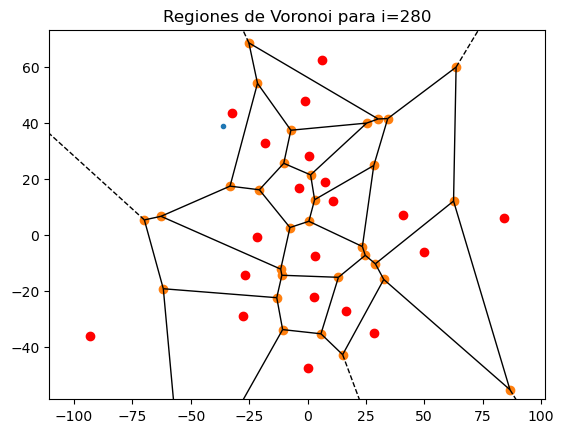

0.12369983732671079 279


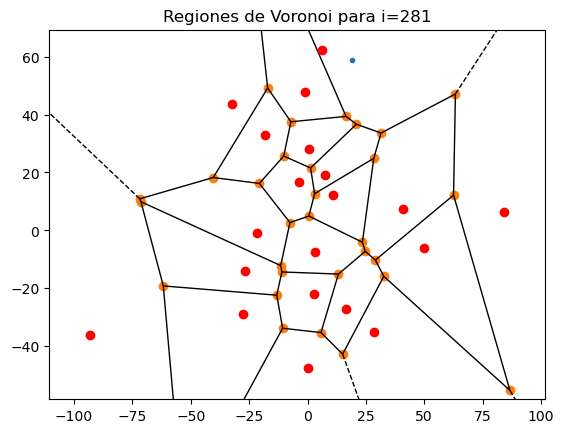

7.21101458377161e-05 280


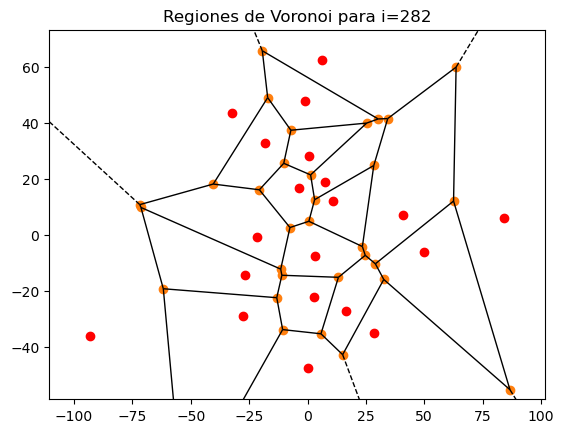

0.12370241754503851 281


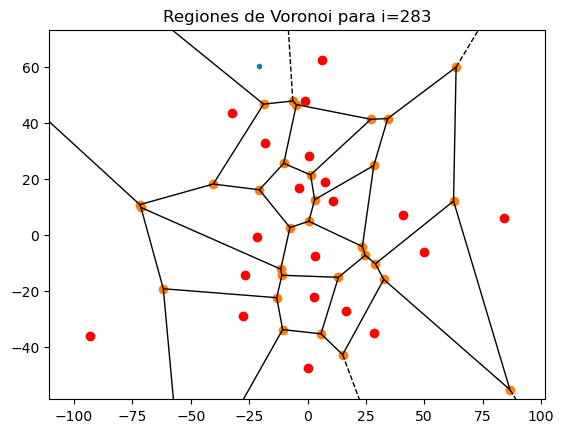

7.407154271677713e-05 282


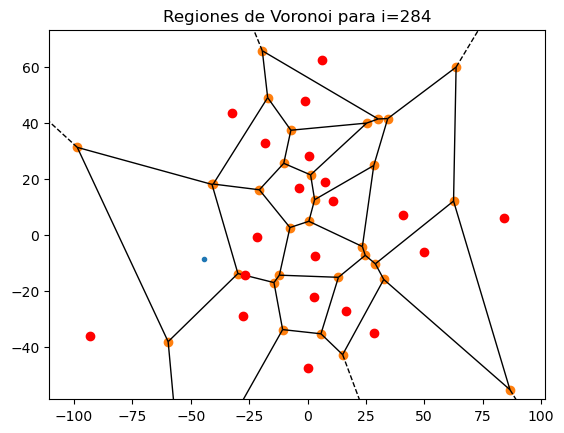

8.147693565445478e-06 283


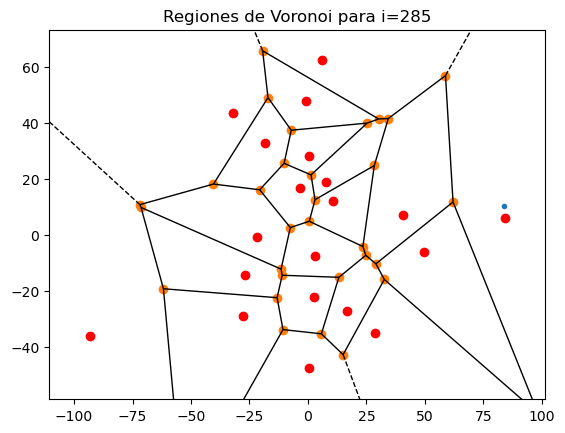

0.123710351577228 284


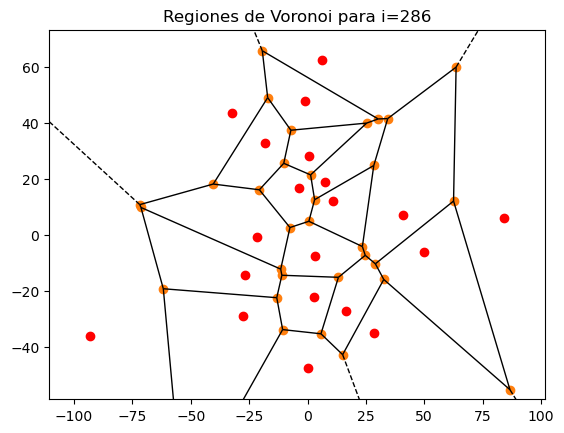

0.12370241754503851 285
62114.312884133105 61


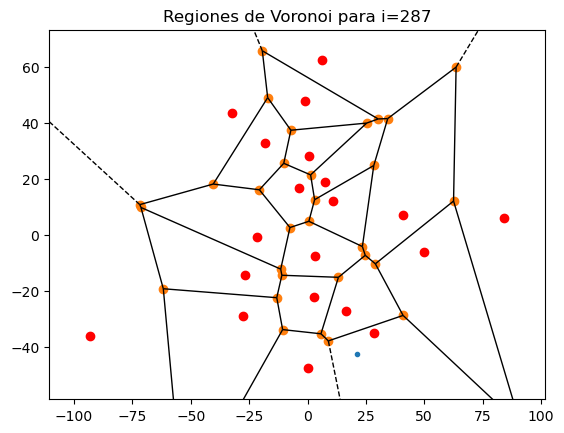

9.852381540230238e-05 286


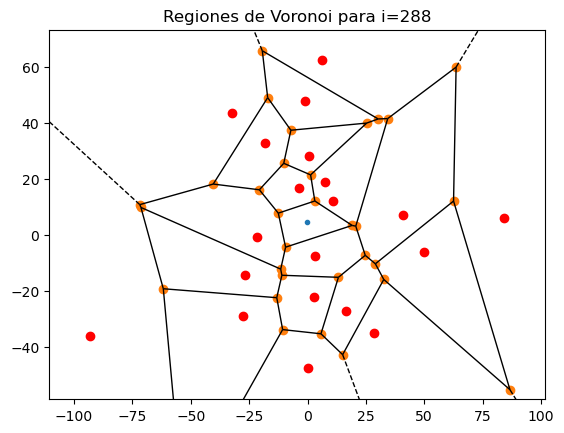

0.003086394734996261 287


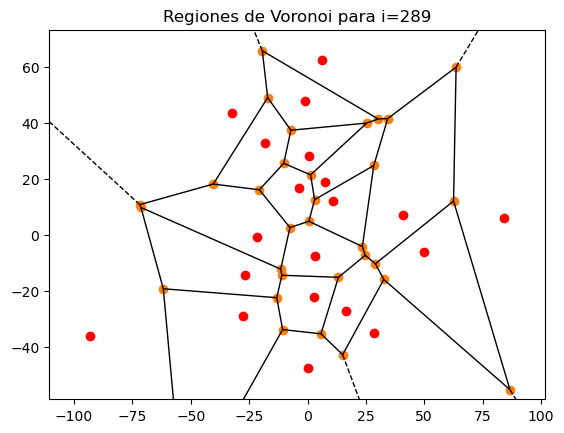

1 288
62114.312884133105 62


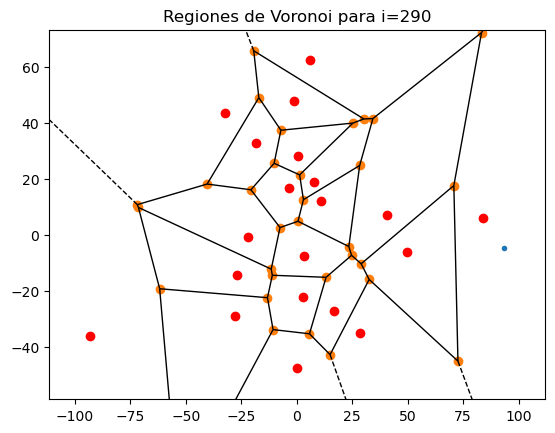

0.999978982683133 289
62113.00740793724 63


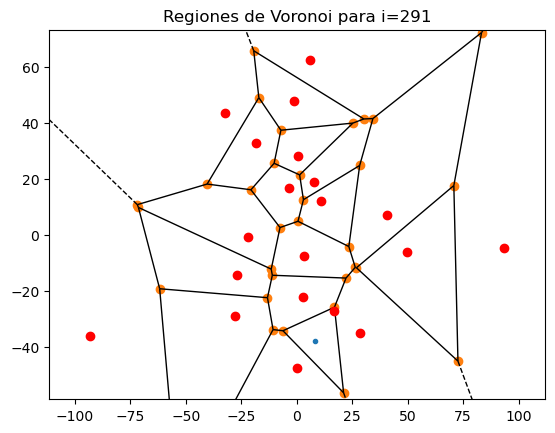

0.0001139214480520262 290


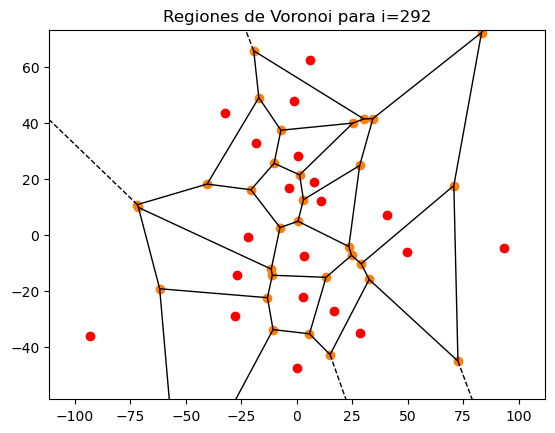

1 291
62113.008468961314 64


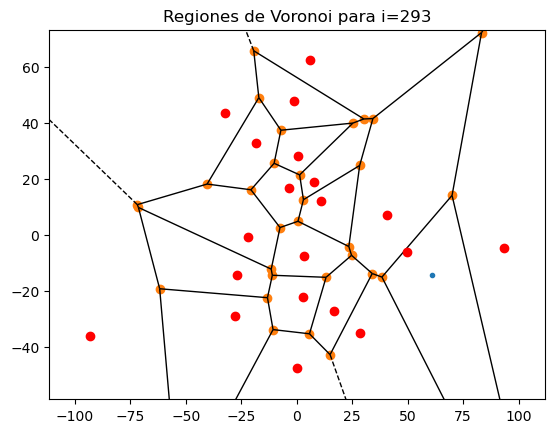

0.00011344253044244535 292


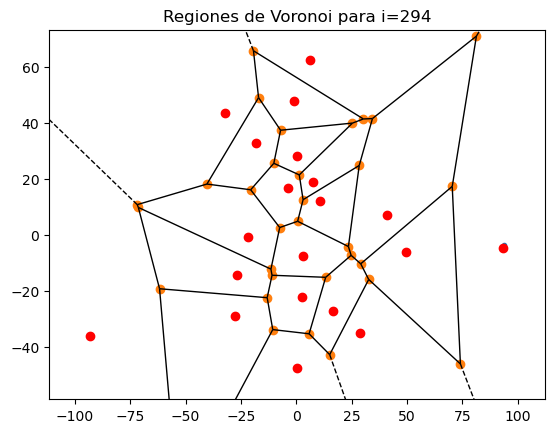

1 293
62113.039162099485 65


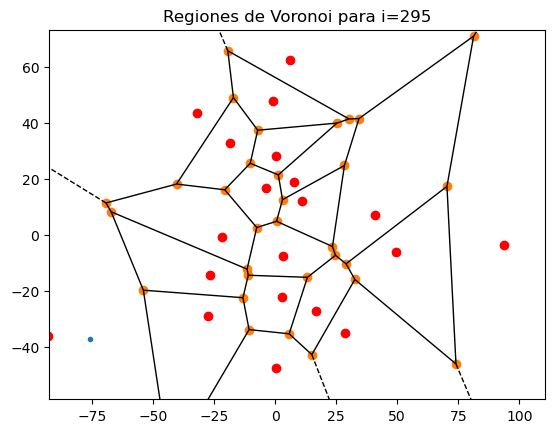

0.0003628879996814408 294


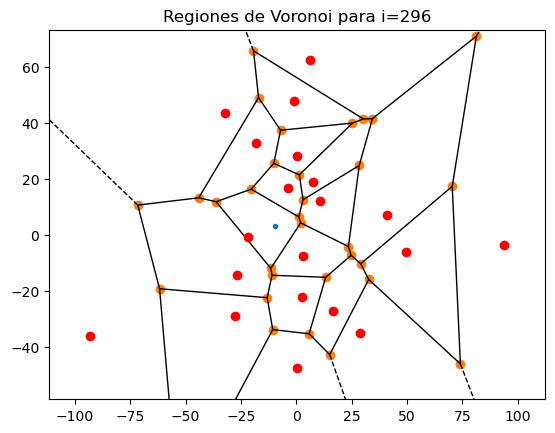

0.0007921384909890444 295


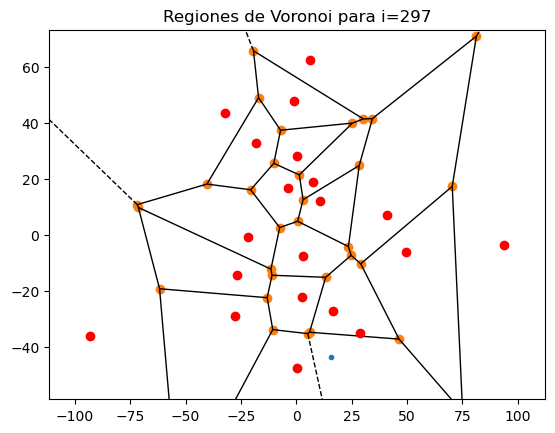

1 296
62120.15513823003 66


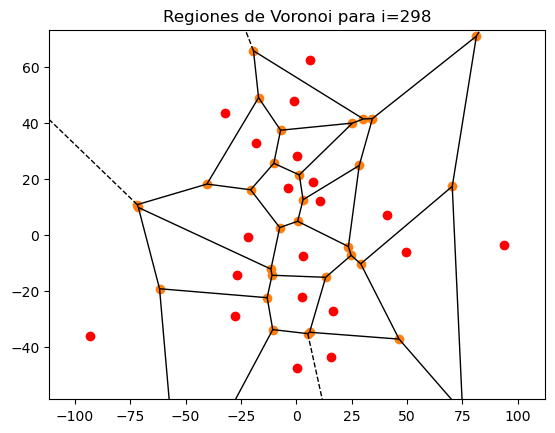

1 297
62158.01128633968 67


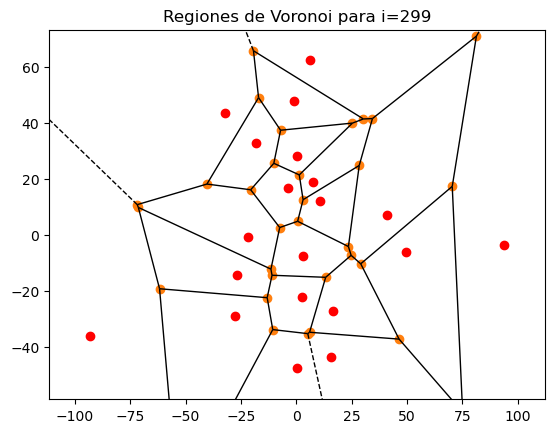

1 298
62158.01128633968 68


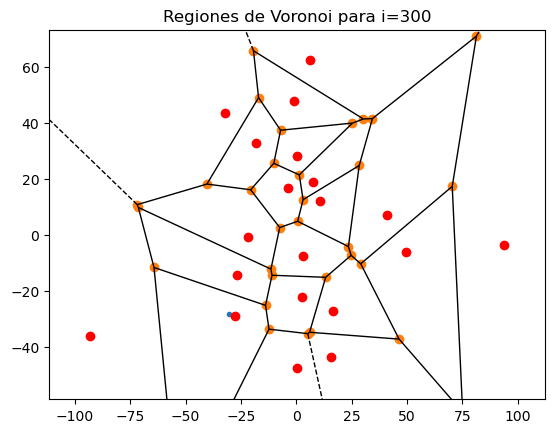

0.9999890204867663 299
62157.32882163218 69


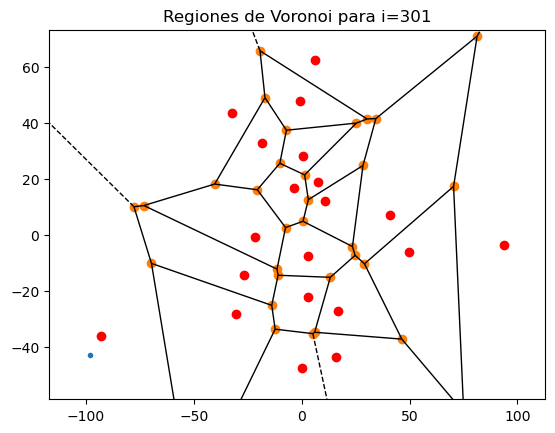

0.9999303767281497 300
62153.001225030144 70


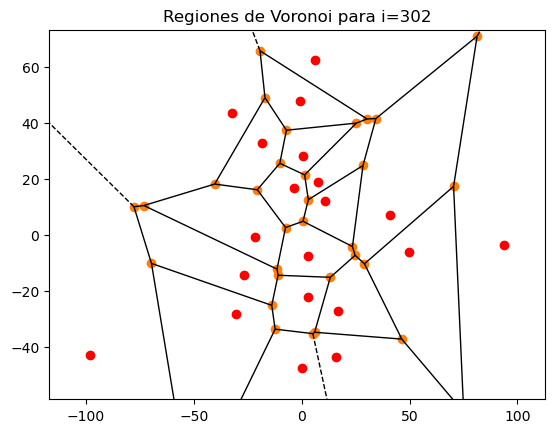

0.9999999257263635 301
62152.99660870073 71


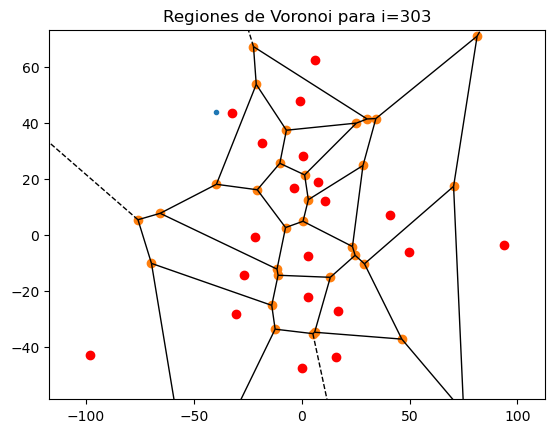

1 302
65356.47957704364 72


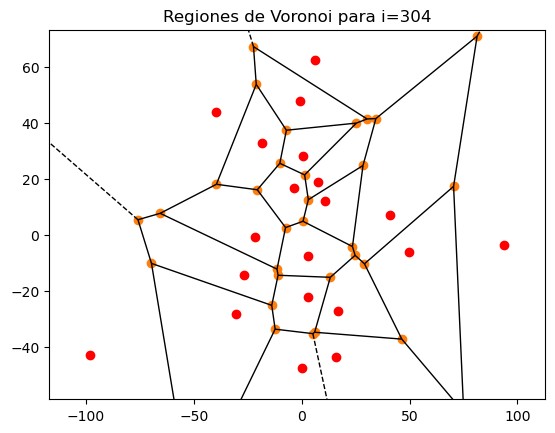

0.9905224139901242 303
64737.057920549516 73


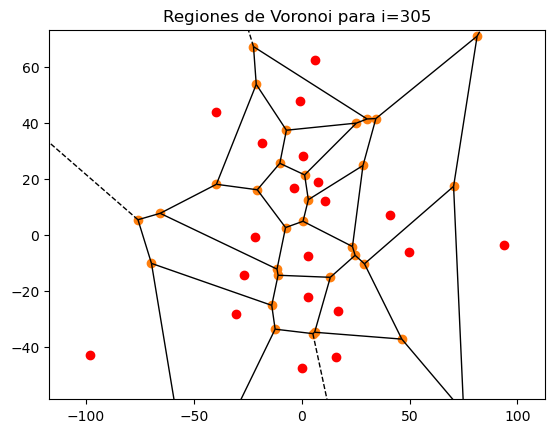

1 304
64737.057920549516 74


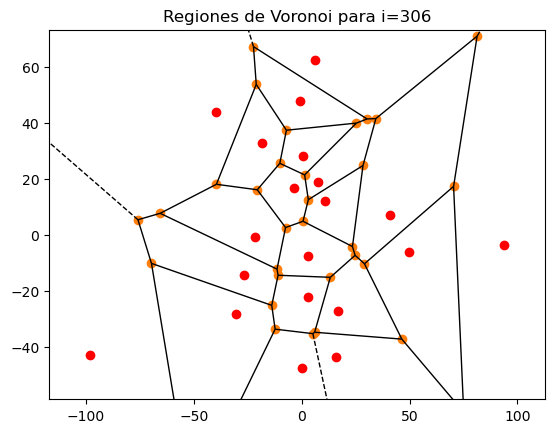

1 305
64737.057920549516 75


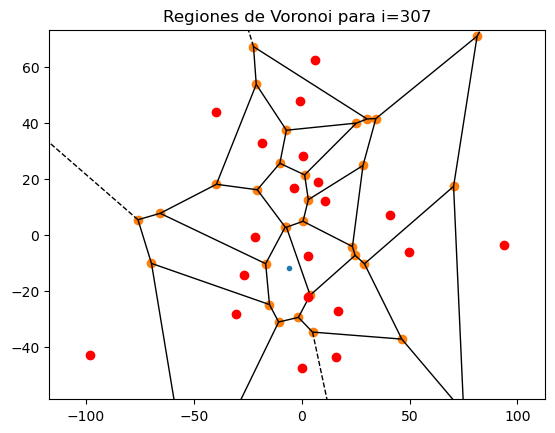

0.07330048398443816 306


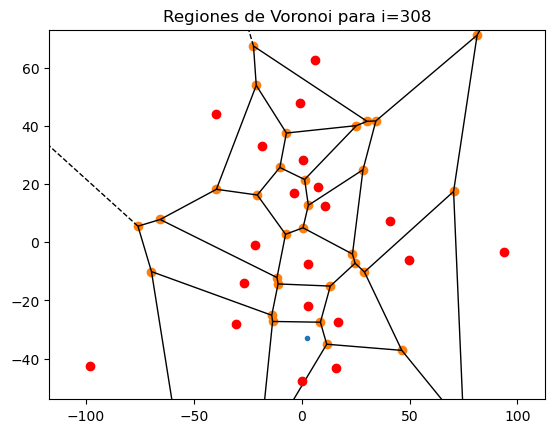

0.12163004018718779 307


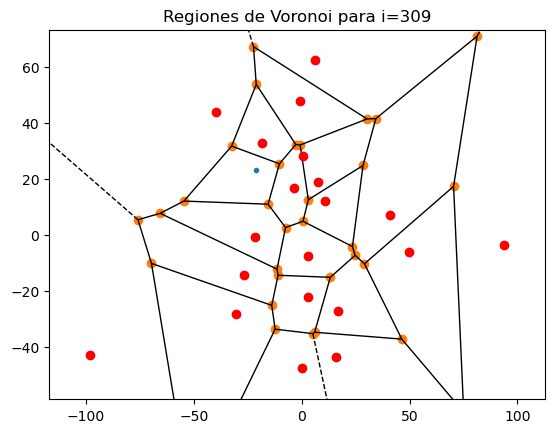

0.9594350579306795 308
62111.00291626418 76


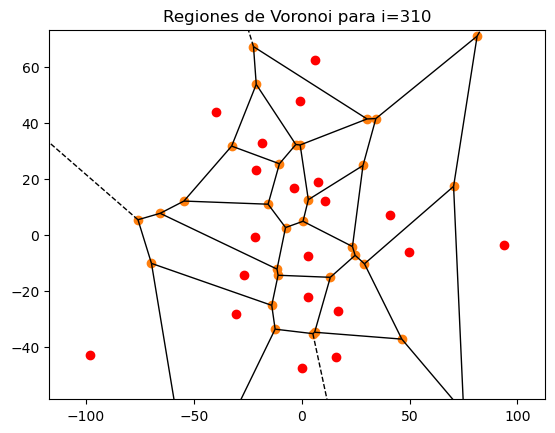

0.9999678510782043 309
62109.00611448877 77


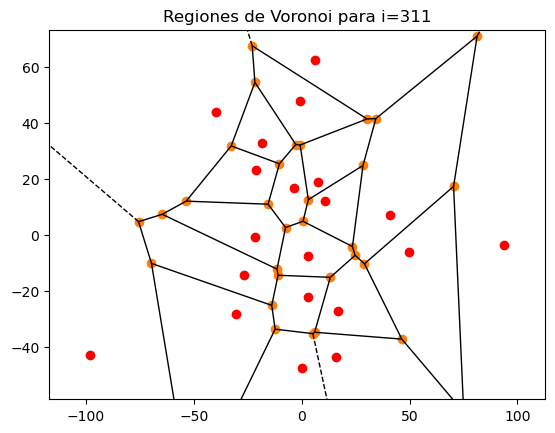

0.0015566907346428848 310


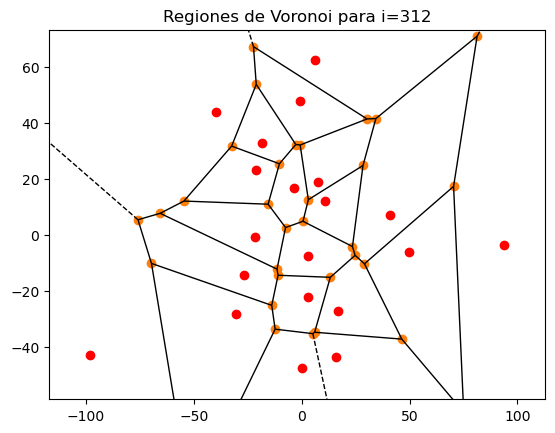

1 311
62109.00611448877 78


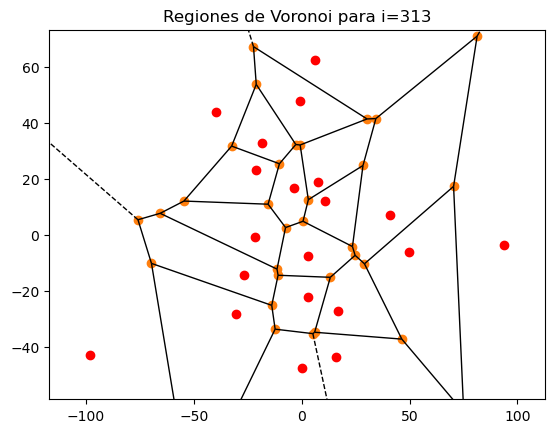

1 312
62109.00611448877 79


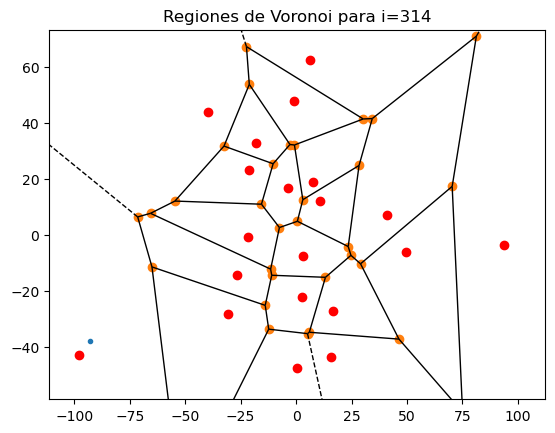

0.9999979358835175 313
62108.87791426554 80


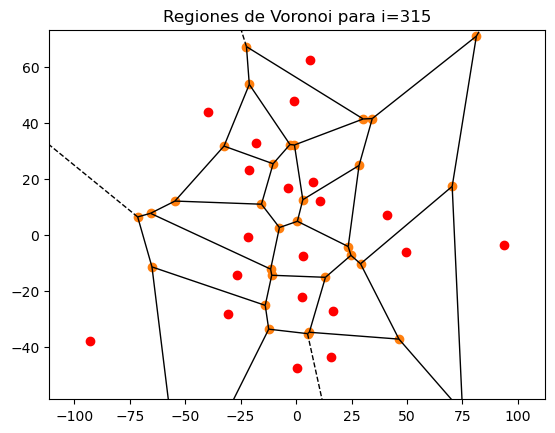

1 314
62108.885716789904 81


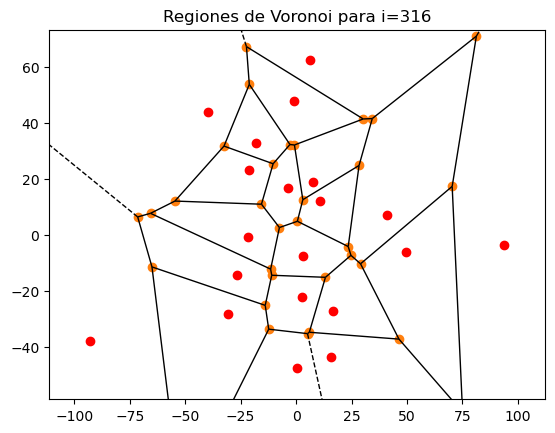

1 315
62108.885716789904 82


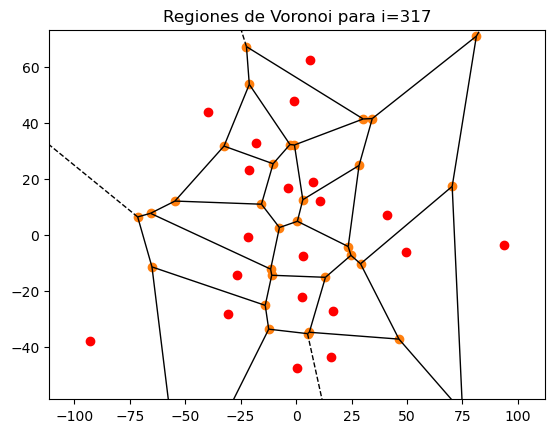

1 316
62108.885716789904 83


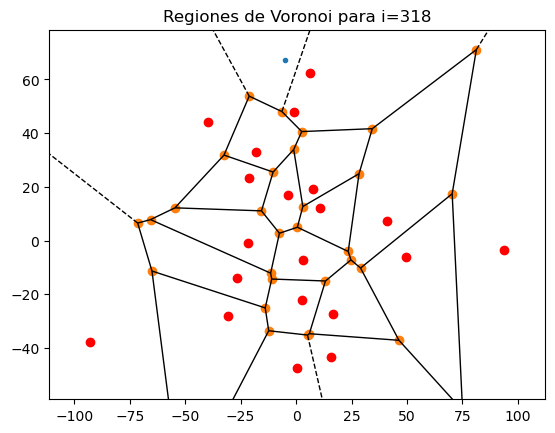

0.0003913895772841257 317


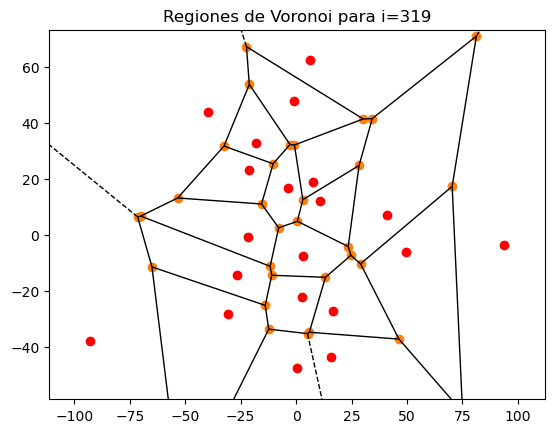

0.004881528064511342 318


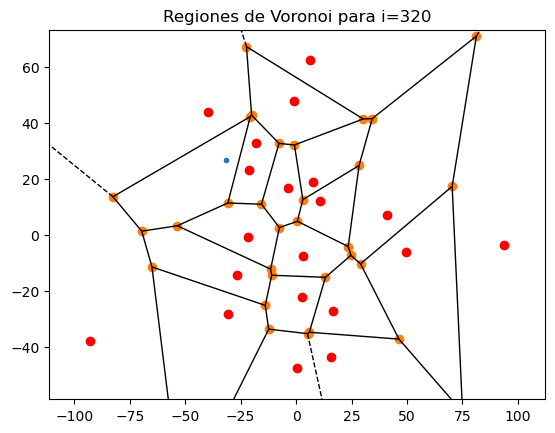

1 319
1198772.2246387932 84


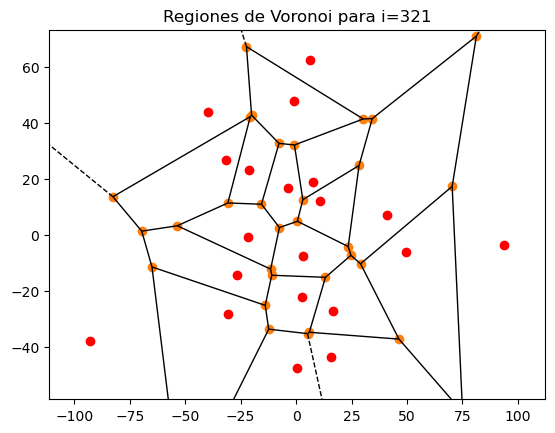

1 320
5435578.811143341 85


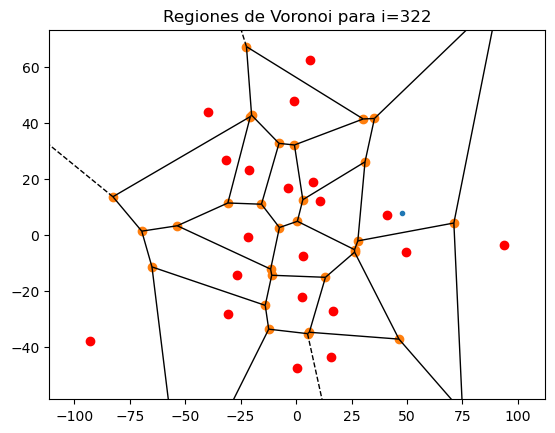

0.999997620186622 321
5435565.8754801685 86


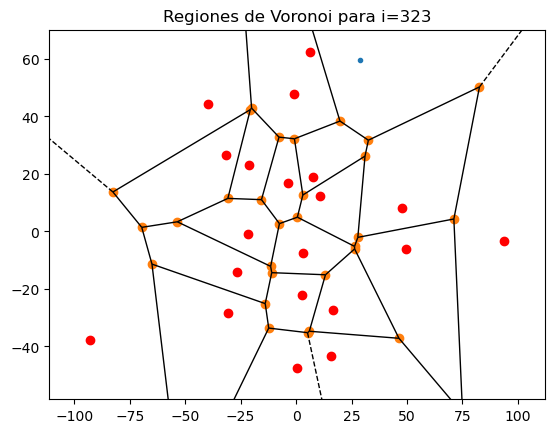

0.00012008869912561538 322


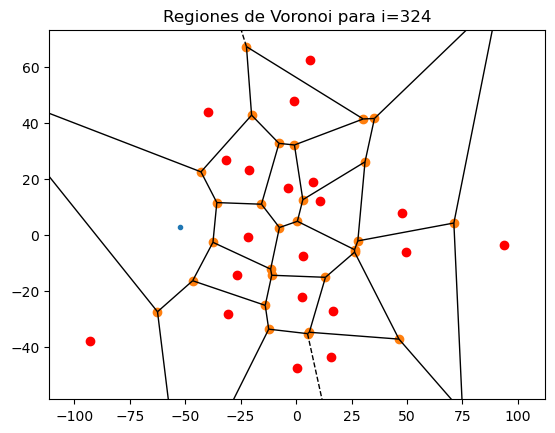

8.892047850305546e-07 323


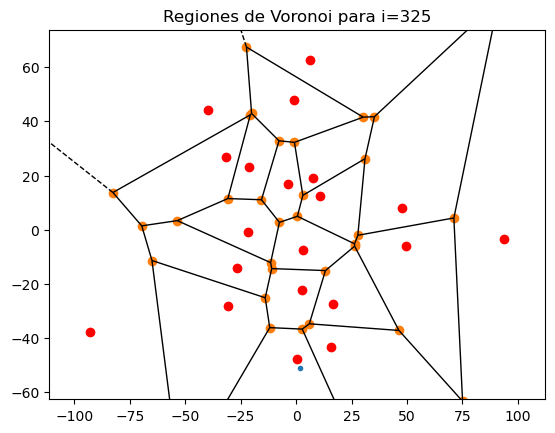

3.245752918246792e-06 324


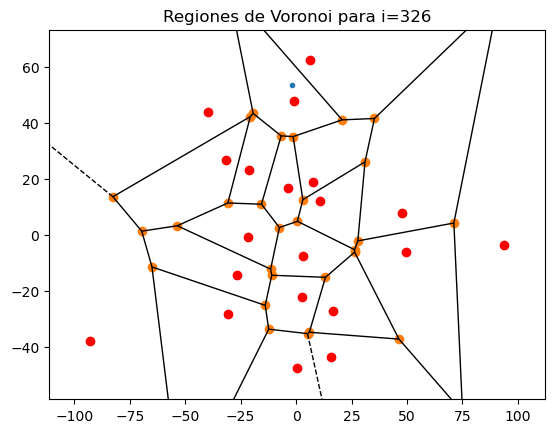

2.603939376576773e-05 325


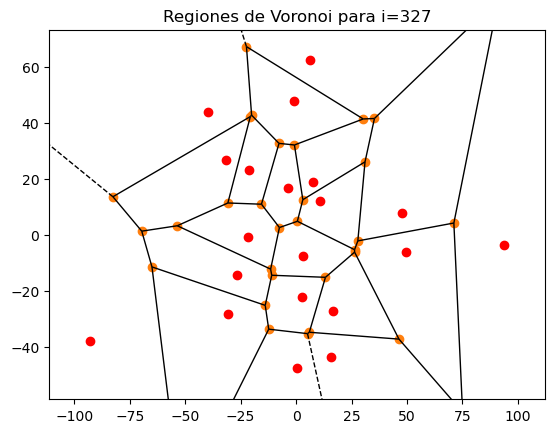

1 326
5435585.0649717245 87


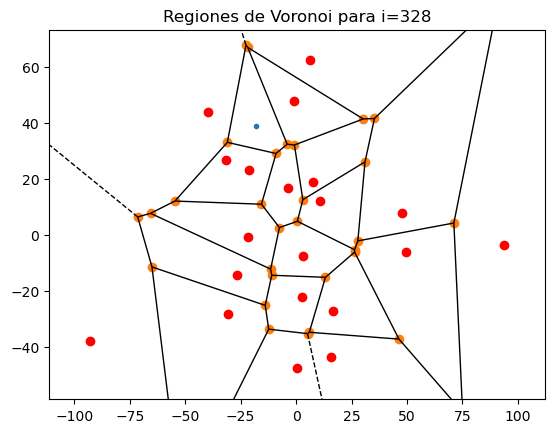

6.2562730372202235e-06 327


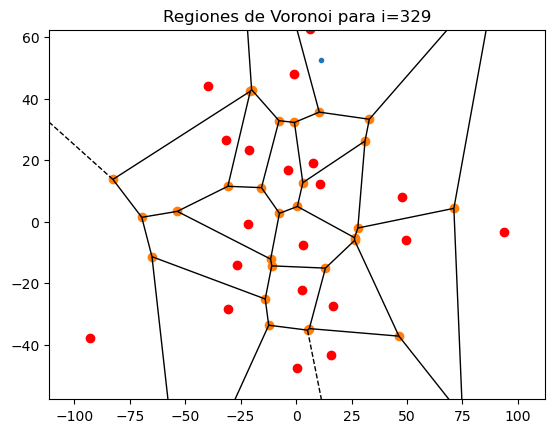

6.318998897530238e-06 328


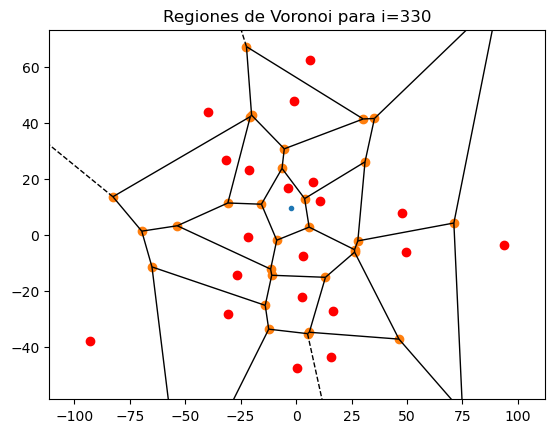

1 329
5435594.695600115 88


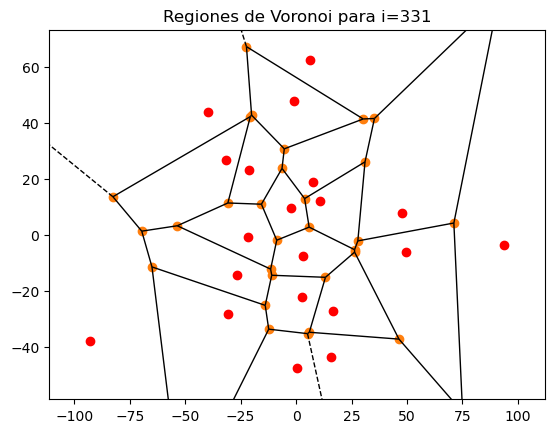

0.999999832471811 330
5435593.78498478 89


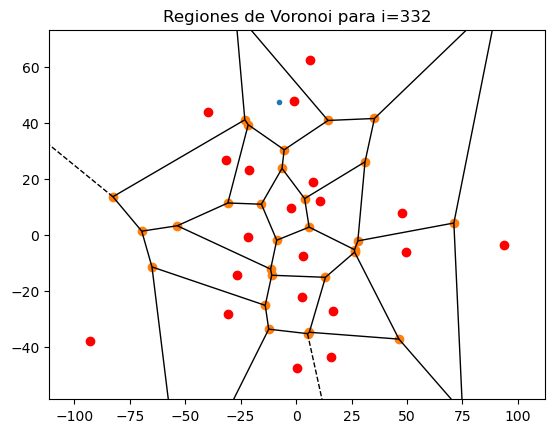

0.00010686066090672188 331


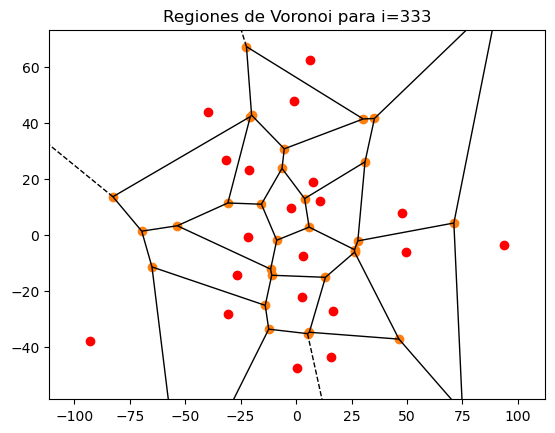

1 332
5435593.78498478 90


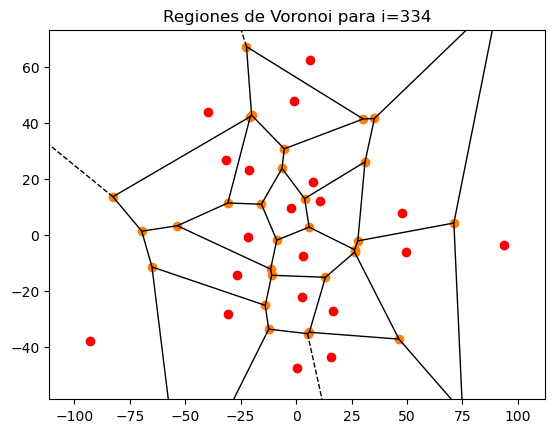

1 333
5435593.78498478 91


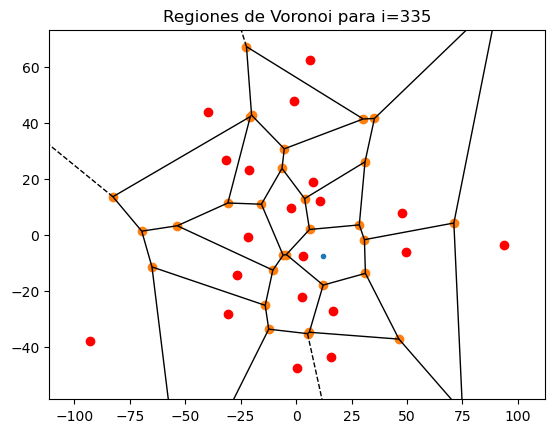

7.833083018961074e-07 334


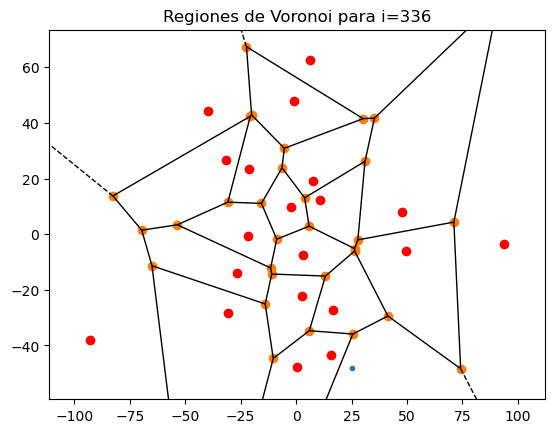

2.4844012387783813e-06 335


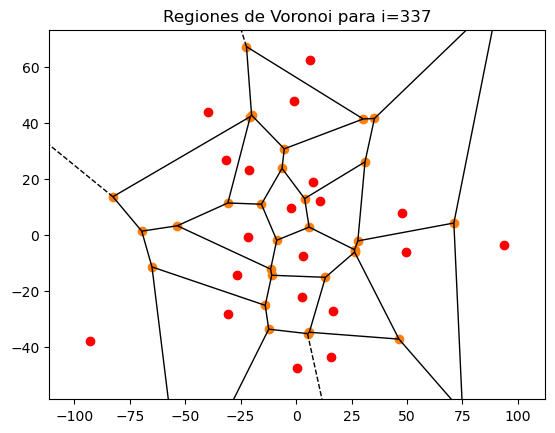

1 336
5435593.78498478 92


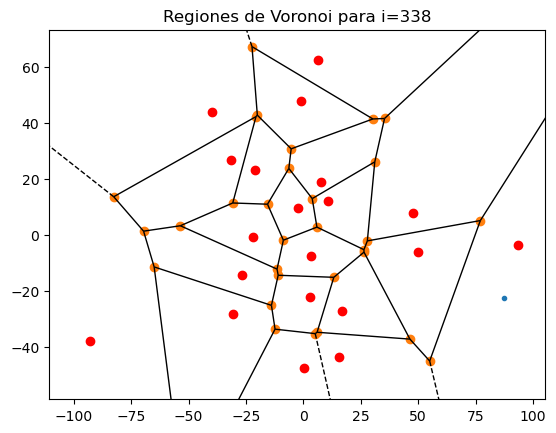

1 337
5436050.977554979 93


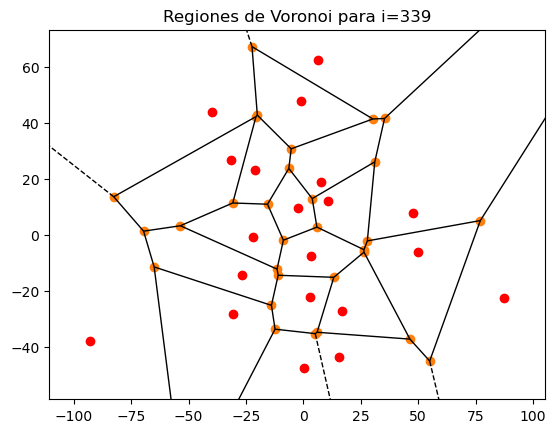

0.9999996105693123 338
5436048.860589908 94


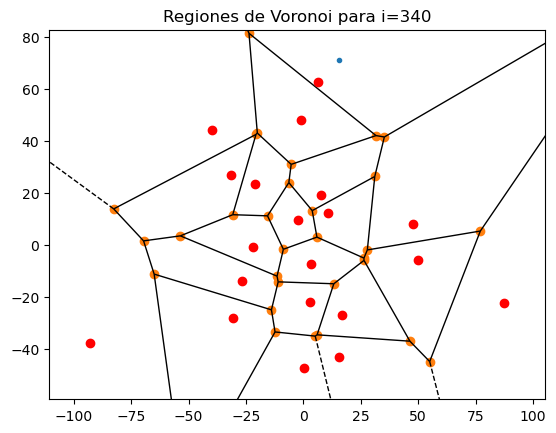

8.578249207133723e-06 339


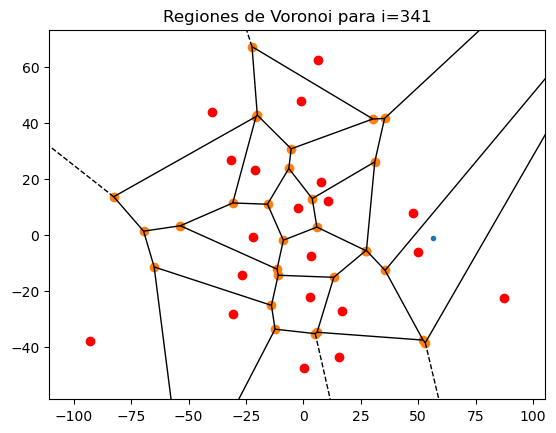

1 340
5470656.561497519 95


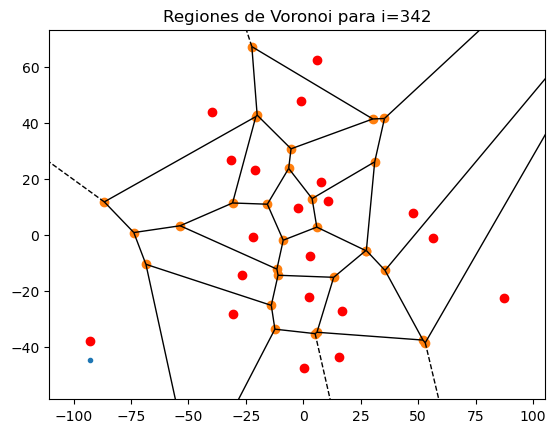

0.020228747754273867 341


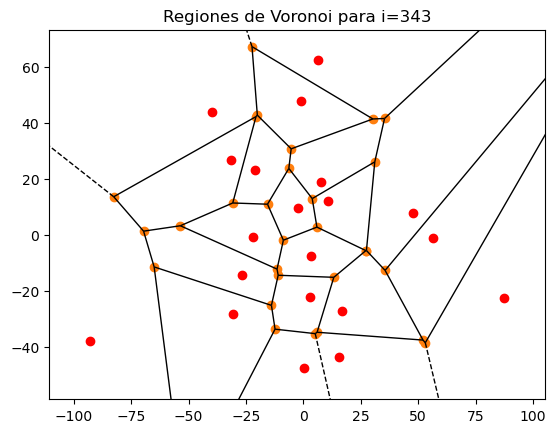

1 342
5470681.343172421 96


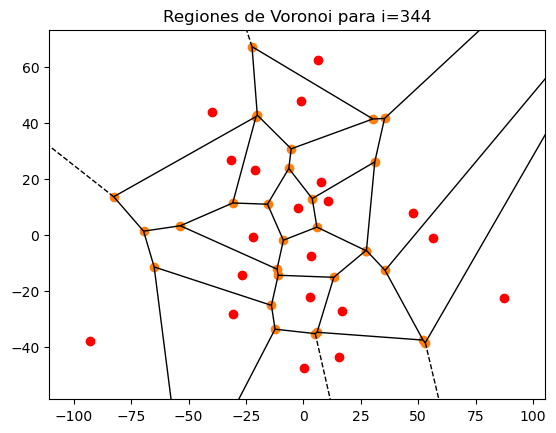

1 343
5470681.343172421 97


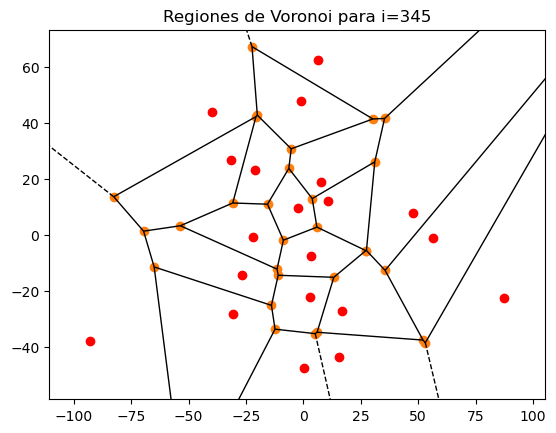

1 344
5470681.343172421 98


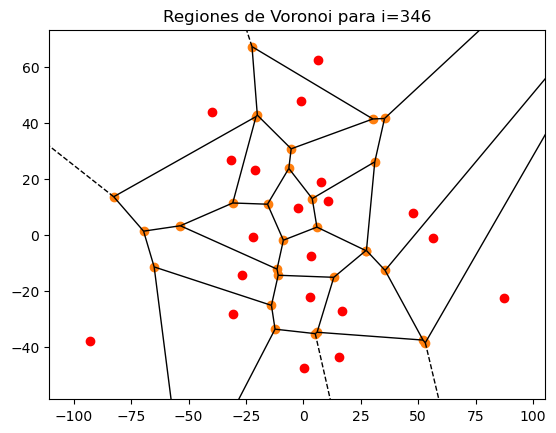

1 345
5470681.343172421 99


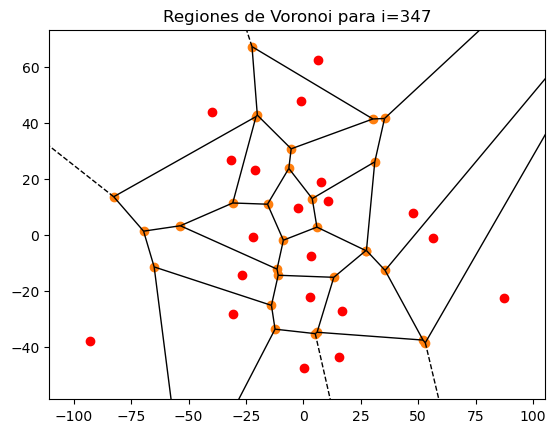

1 346
5470681.343172421 100


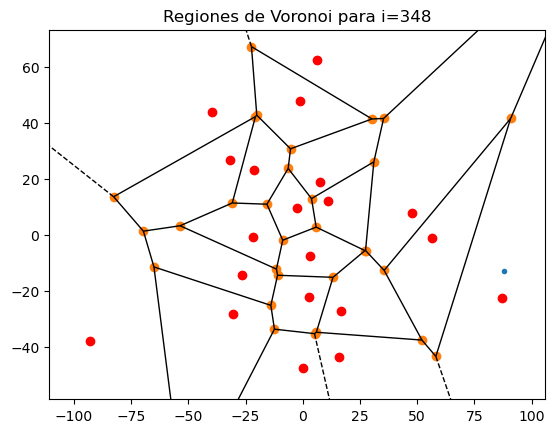

0.9937500508986468 347
5436489.86322787 101


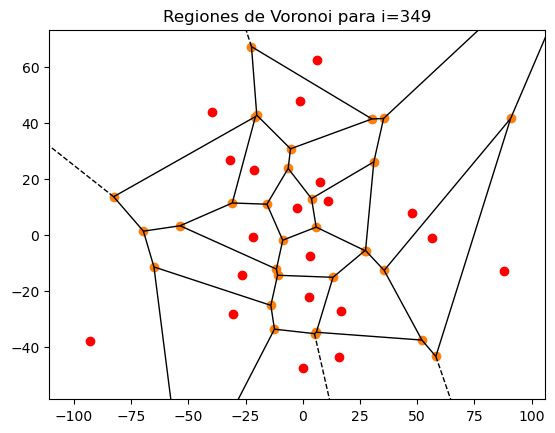

1 348
5436493.179971717 102


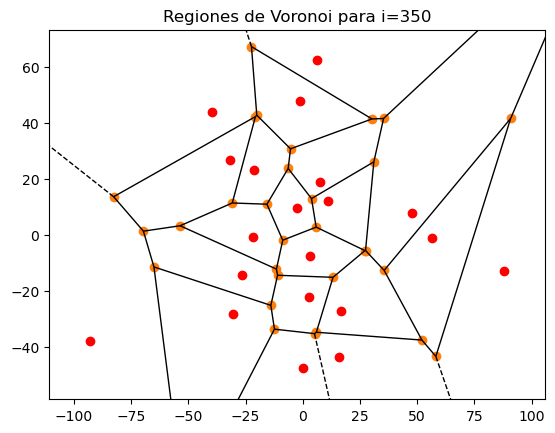

1 349
5436493.179971717 103


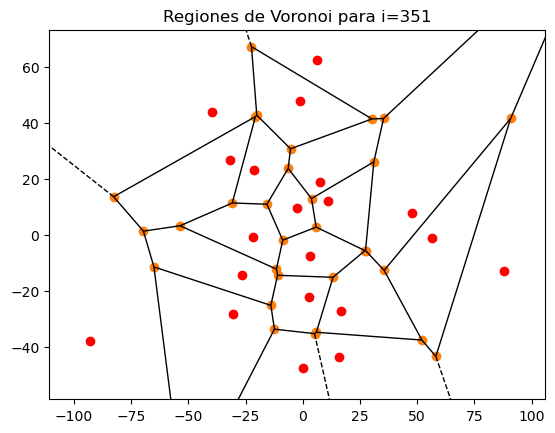

1 350
5436493.179971717 104


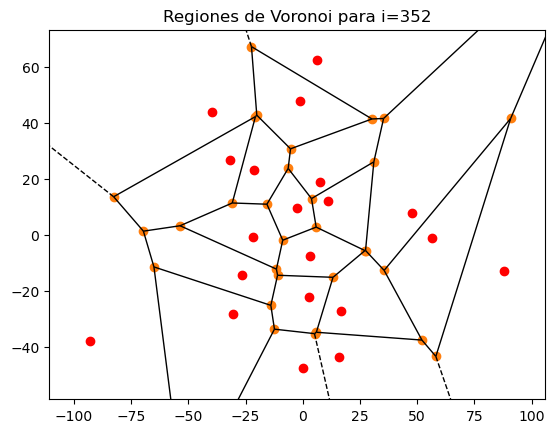

1 351
5436493.179971717 105


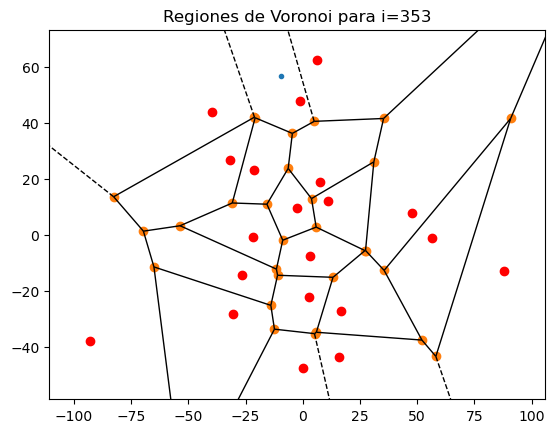

3.1086815465219224e-06 352


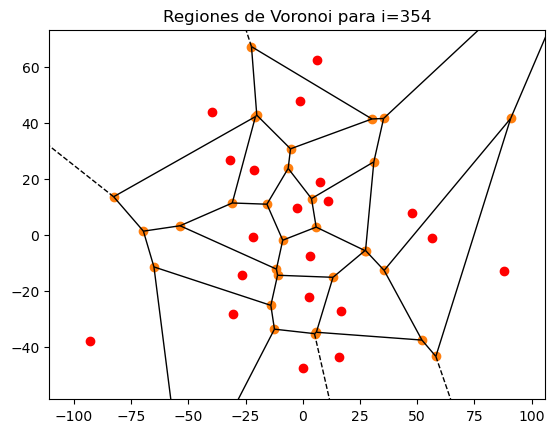

1 353
5436493.179971717 106


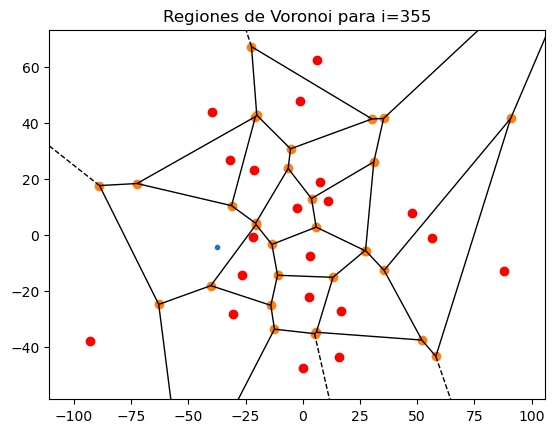

1.4316404358074642e-05 354


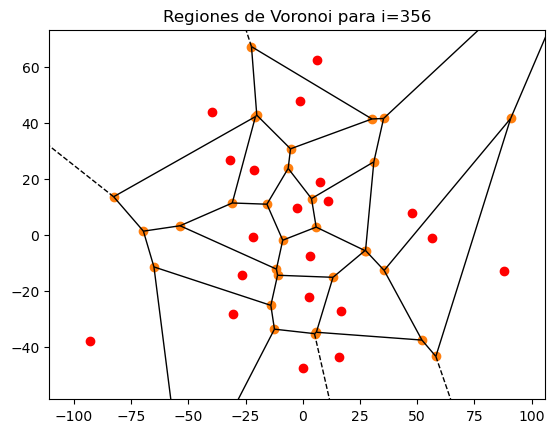

1 355
5436493.179971717 107


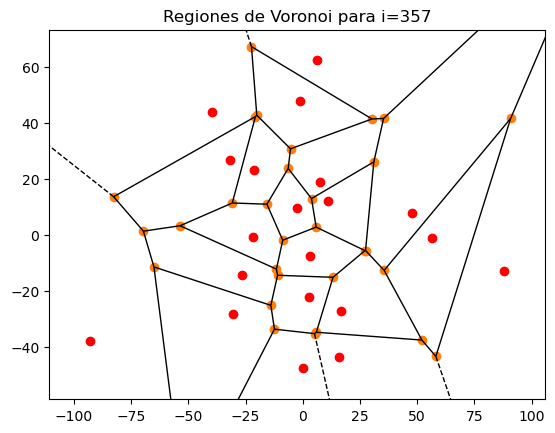

1 356
5436493.179971717 108


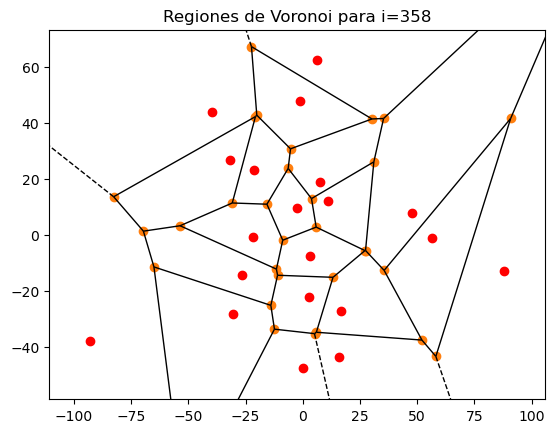

1 357
5436493.179971717 109


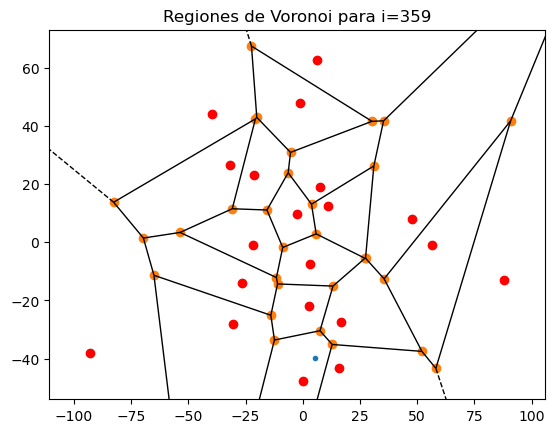

1.8773200017977384e-06 358


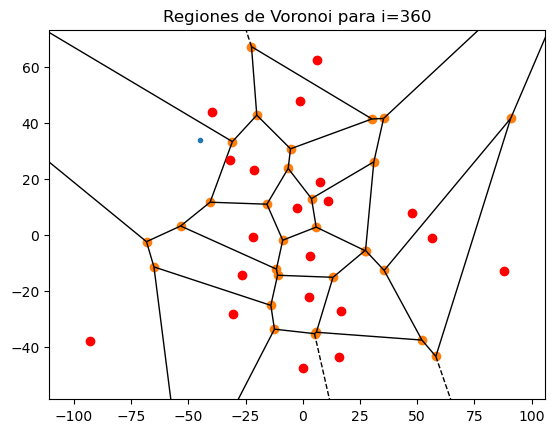

2.8751770371527136e-07 359


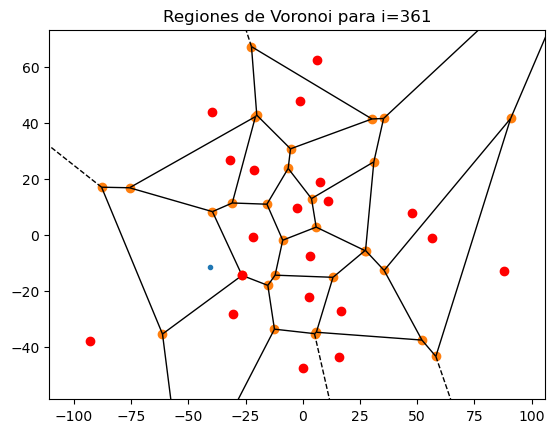

1.1007124124589696e-05 360


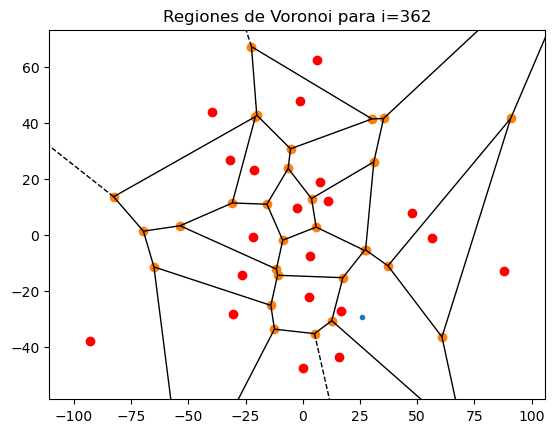

2.9518662380644285e-06 361


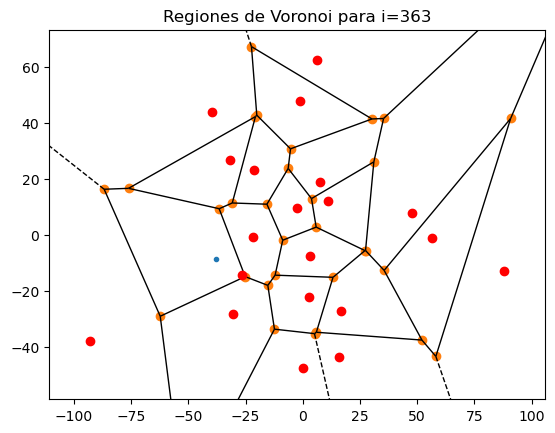

1.2993361613016148e-05 362


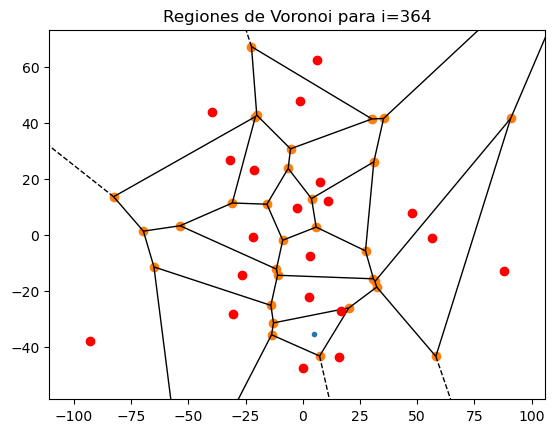

4.099512779748946e-06 363


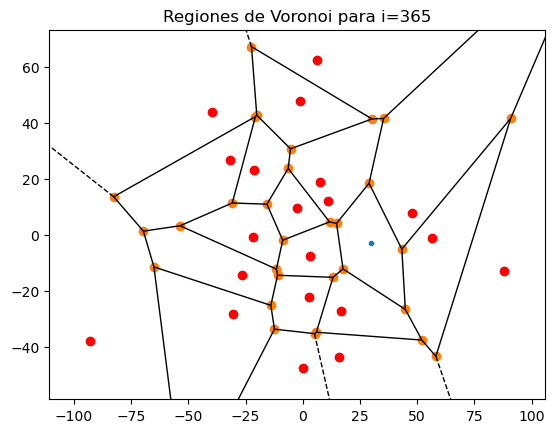

5.528916015797523e-07 364


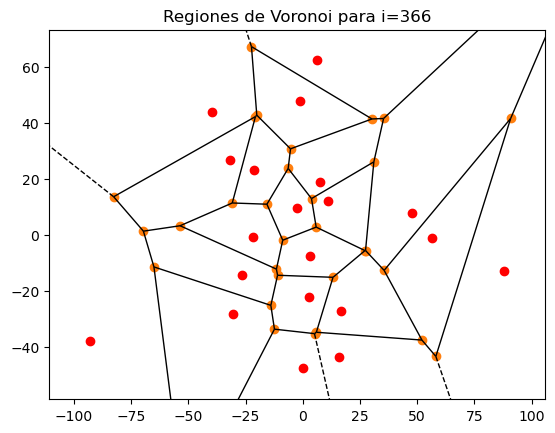

1 365
5436493.179971717 110


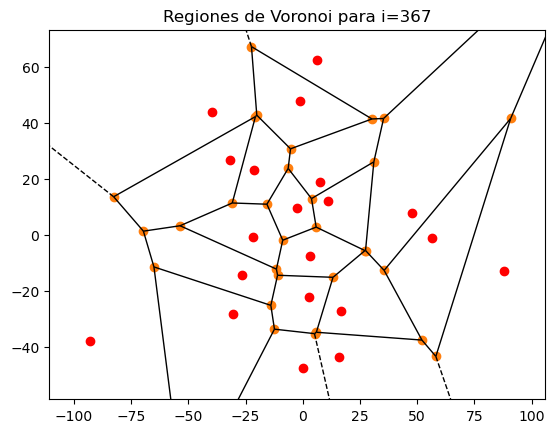

1 366
5436493.179971717 111


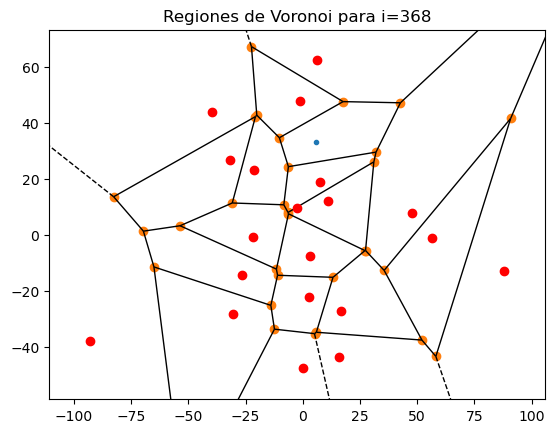

0.9999973596124763 367
5436478.825522952 112


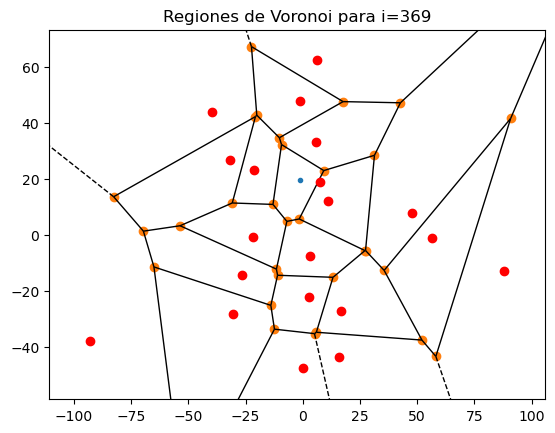

1 368
5436764.407107403 113


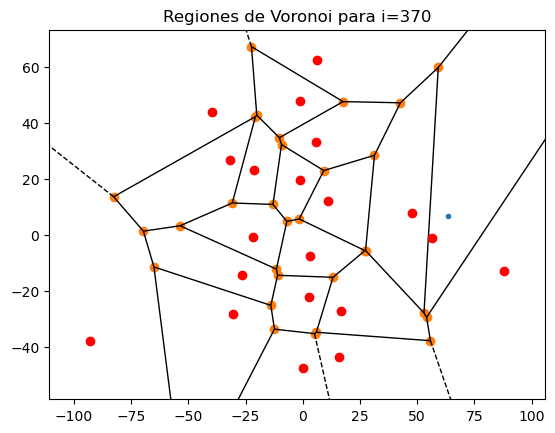

0.04767280070035182 369


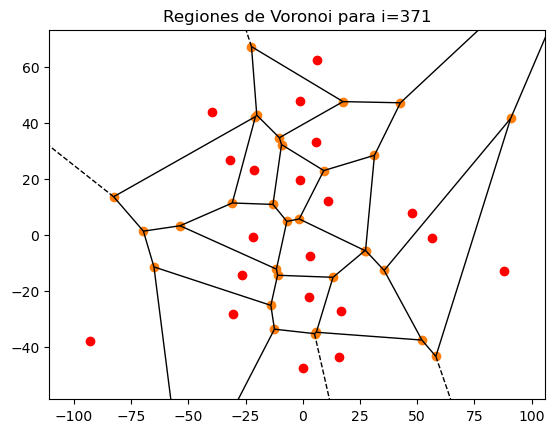

0.9999786858539221 370
5436648.527116639 114


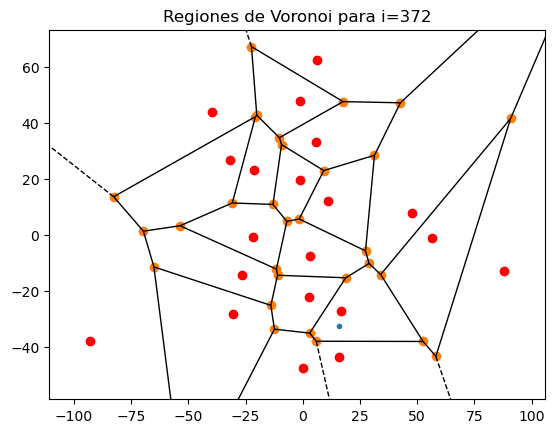

3.208467400039424e-05 371


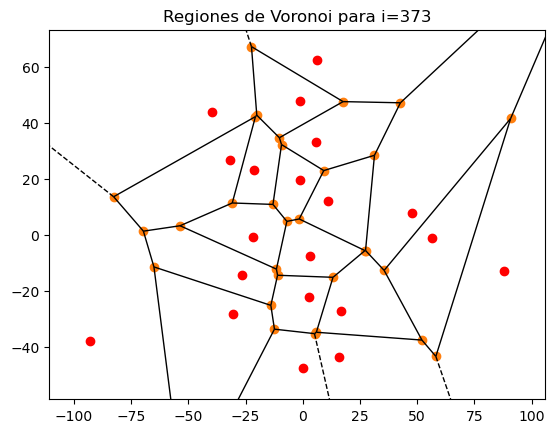

1 372
5436648.527116639 115


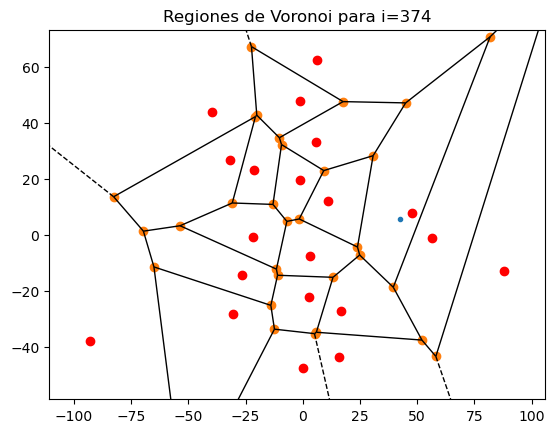

0.00012668036070483658 373


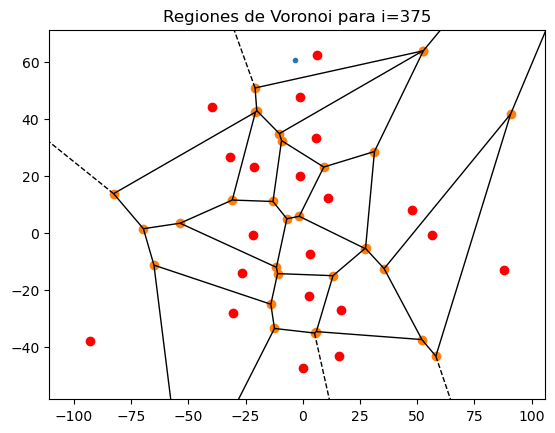

3.5624623396414964e-05 374


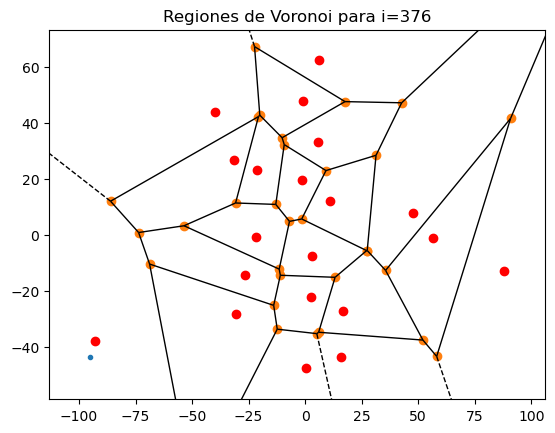

0.019204520222335632 375


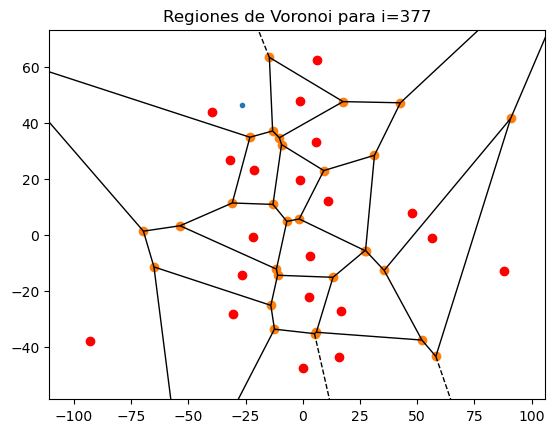

0.0003041838318581574 376


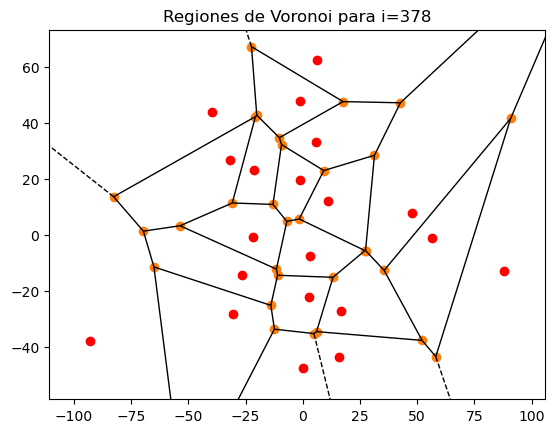

0.9999153426206021 377
5436188.274699626 116


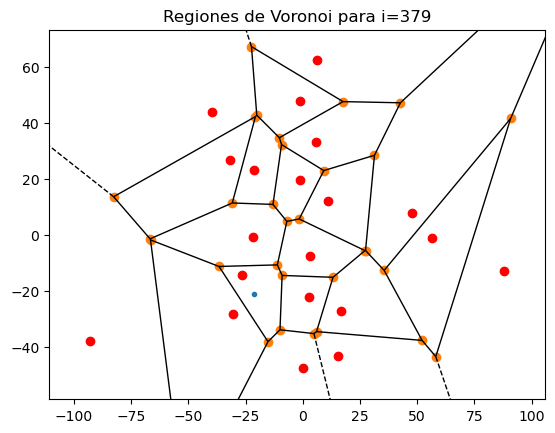

0.00012106134559576988 378


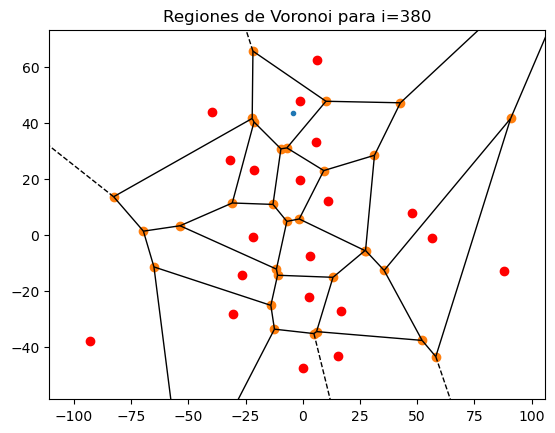

0.00018970536730135567 379


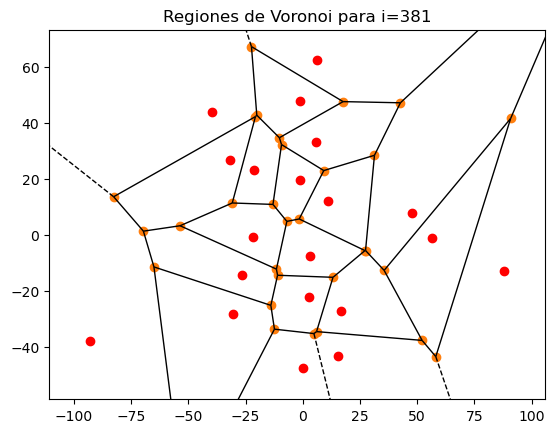

1 380
5436189.635030916 117


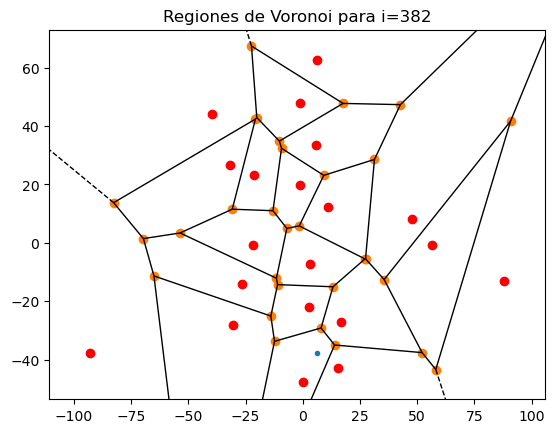

2.6469643985906404e-06 381


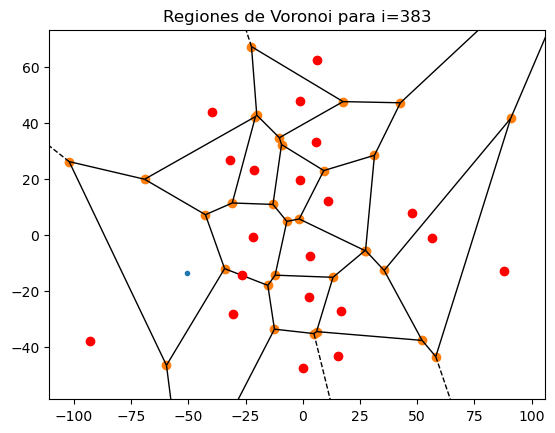

4.84531830129912e-06 382


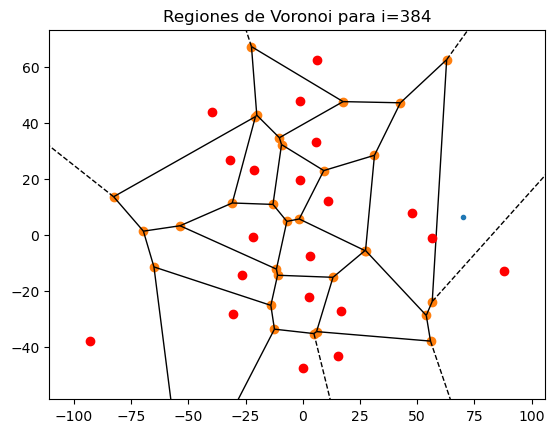

0.9998228079336643 383
5435226.385356492 118


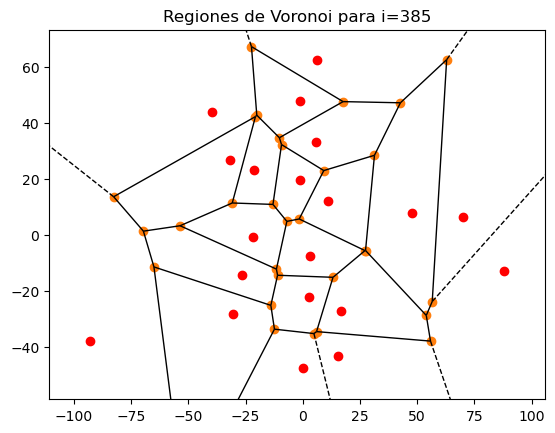

0.9999993634881599 384
5435222.925770544 119


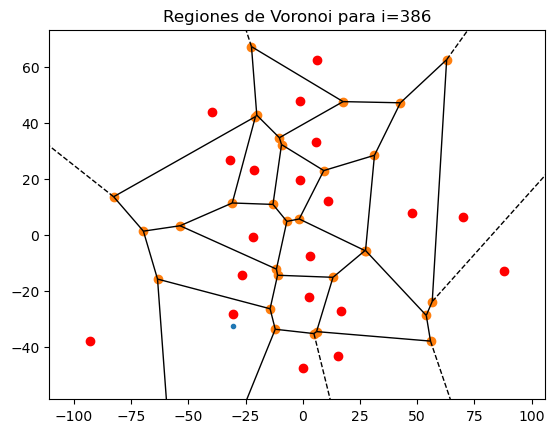

0.9999999983286144 385
5435222.916686191 120


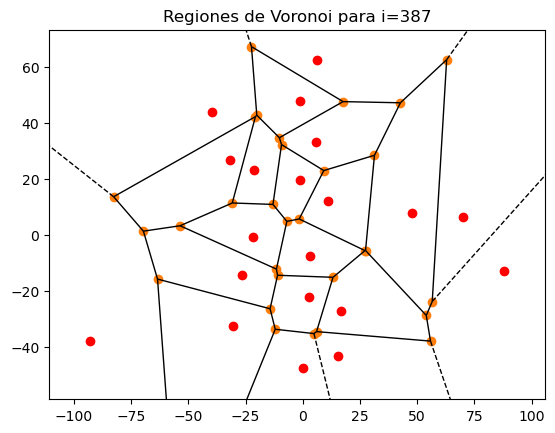

1 386
5435222.918559927 121


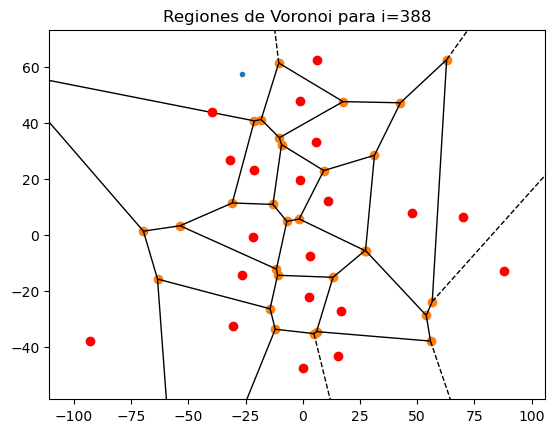

4.395626685708406e-05 387


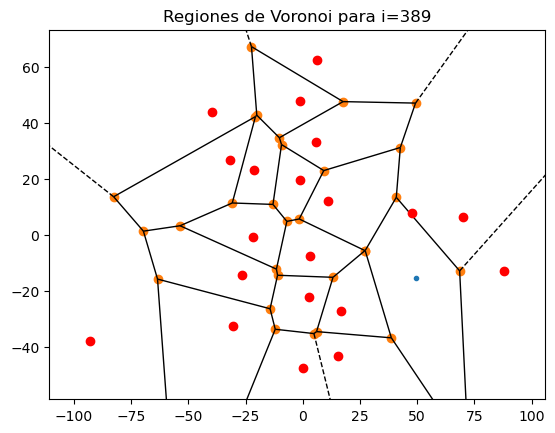

8.327653714291114e-06 388


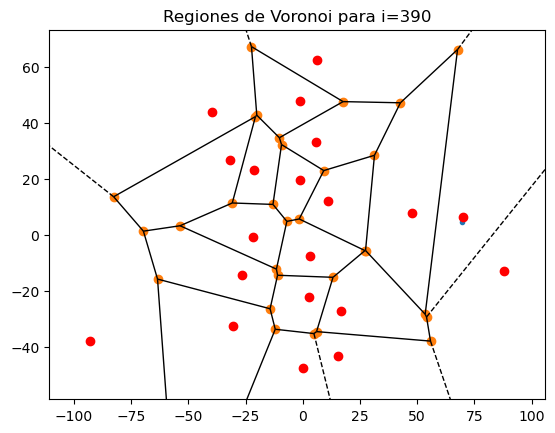

3.2558056059779386e-05 389


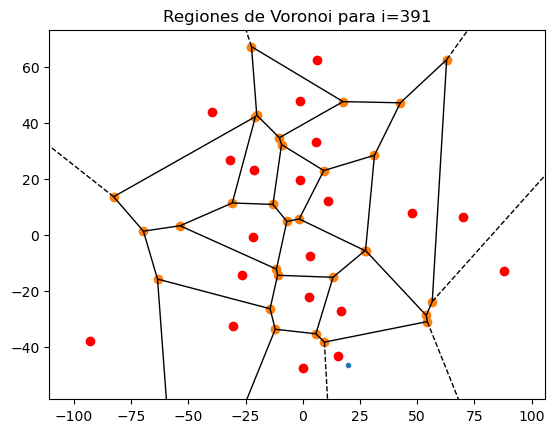

0.00017185583012084942 390


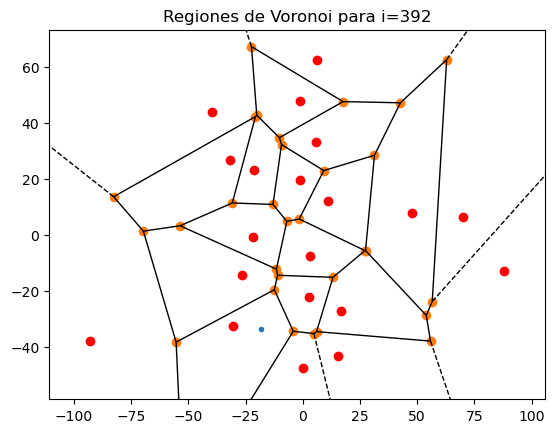

1.6320529241356431e-06 391


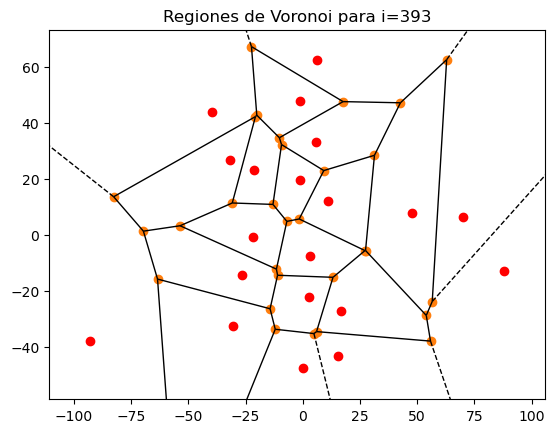

1 392
5435222.918559927 122


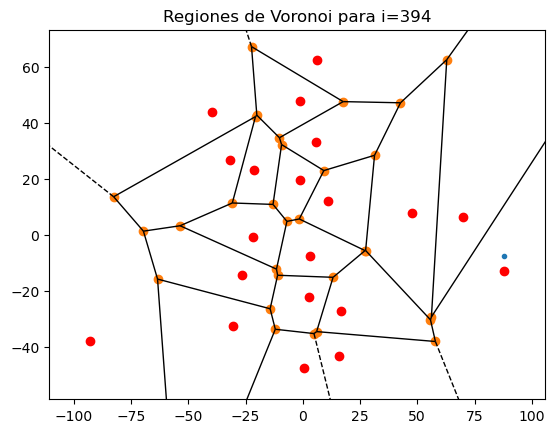

3.9298662771910794e-05 393


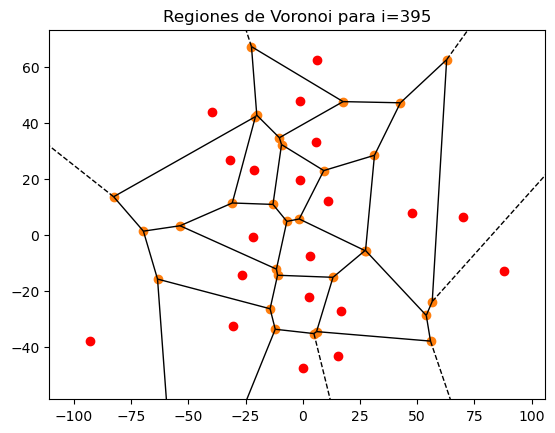

1 394
5435222.918559927 123


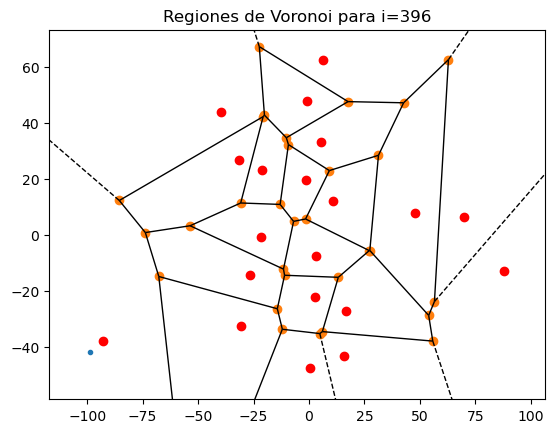

0.02860939095688413 395


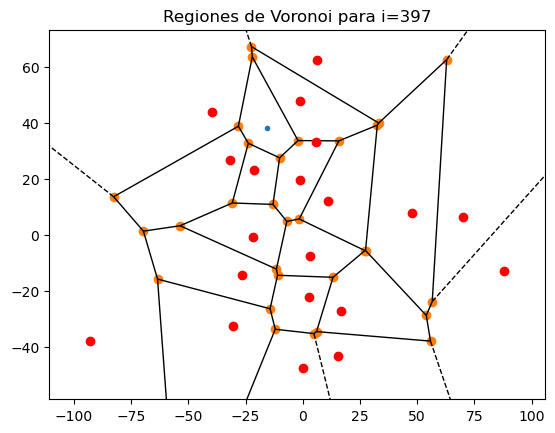

1.7404694125749898e-05 396


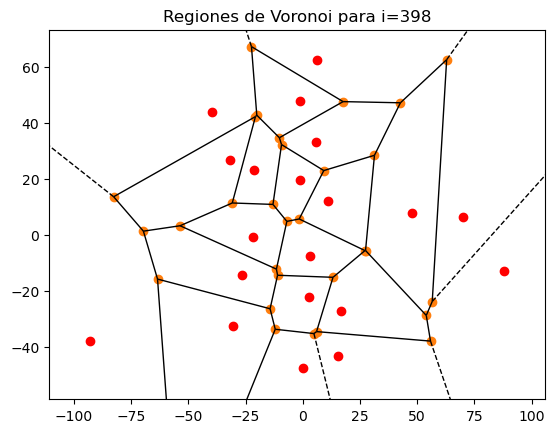

1 397
5435222.918559927 124


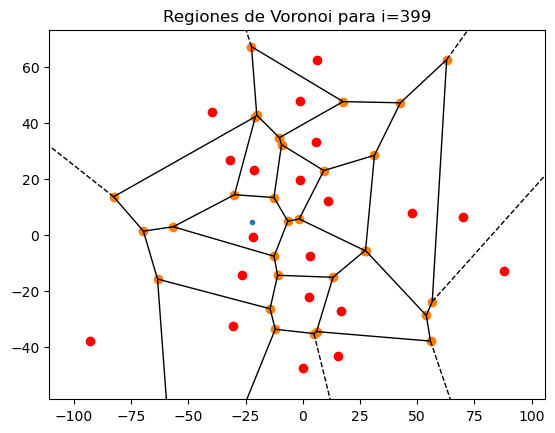

1.5437853795804156e-05 398


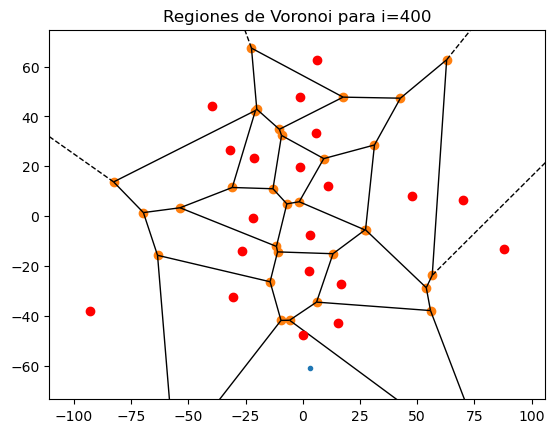

3.675279534432724e-05 399


In [76]:
def random_perturbation(point,idx,todoslospoints, scale=10,xlim=100,ylim=100,epsilon=10,delta=80): #La función de perturbación
    
    perturbation = point + np.random.normal(0, scale, point.shape) #El punto perturbado.
    puntossinpoint = todoslospoints.copy()
    puntossinpoint = np.delete(puntossinpoint,idx,axis = 0)
    dist = np.min([np.linalg.norm(perturbation-point2) for point2 in puntossinpoint]) #Para verificar que no está 
    #demasiado cerca de otra estación.
    
    if np.abs(perturbation[0])>xlim or np.abs(perturbation[1])>ylim: #Si es que se escapa del cuadrado inicial
      return point
    elif dist < epsilon: #Si dos estaciones quedan muy cerca.
      return point
    else:
      return perturbation

def plot_voronoi(vor): #Para graficar las regiones de voronoi
    voronoi_plot_2d(vor)
    plt.plot(points[:, 0], points[:, 1], 'ro')  #Pintamos los puntos de origen
    plt.title(f"Regiones de Voronoi para i={i+1}")
    plt.show()
    

points = inicializar_estaciones(N) #Distribución inicial de regiones.
vor = Voronoi(points)
inicial = vor #Se deja una copia de la distribución inicial para luego graficar y comparar.
num_iterations = 400 #Número de iteraciones.

j=0 #Un contador.
objs = [] #Para realizar programación dinámica, contendrá los valores de la función objetivo.
for i in range(num_iterations): #No ocuparemos directamente una matriz que represente la cadena de Markov, sin embargo
    #en cada paso se iría generando la fila i de dicha matriz y el procedimiento sigue funcionando.
    if i == 0: #El caso base
      obj = objetivo(vor,ciud_tot,puntos_de_interes) #Calculamos la función objetivo de la dist. inicial y lo agregamos
      objs.append(obj) #a la lista.

    idx = np.random.randint(len(points)) #seleccionamos un punto aleatorio.
    selected_point = points[idx]
    proposal_point = random_perturbation(selected_point,idx,points) #lo perturbamos
    proposal_points = np.copy(points) #La distribución nueva.
    proposal_points[idx] = proposal_point
    vor_proposal = Voronoi(proposal_points) #Determinamos las regiones de voronoi nuevas.
    obj = objs[-1] #Extraemos el último elemento agregado a la lista con las funciones objetivo.
    obj_proposal = objetivo(vor_proposal,ciud_tot,puntos_de_interes) #Calculamos el valor objetivo de la nueva distribución
    acceptance_prob = min(1, obj_proposal / obj) #el mínimo entre 1 y la fn objetivo de la nueva dist. partido la anterior.
    plot_voronoi(vor_proposal) #Se grafica antes de ver si se acepta la distribución para ver más que nada cuando
    #lo está rechazando.
    print(acceptance_prob,i) #Se printea la aceptación y el índice.

    if np.random.rand() < acceptance_prob: #Metropolis-Hastings.
        
        objs.append(obj_proposal) #Se agrega a la lista si cumple la condición
        print(obj_proposal,j) #Se printea la fn objetivo nueva y el índice.
        points = proposal_points #Se actualiza la distribución a la nueva distribución encontrada.
        vor = vor_proposal #Se actualiza la distribución a la nueva distribución encontrada.
        j+=1



Se grafican la distribución inicial y final para ver el cambio.

inicial es el primer gráfico, final, el segundo
Las funciones objetivos de ambos son:  826.4325168836345 5435222.918559927 respectivamente


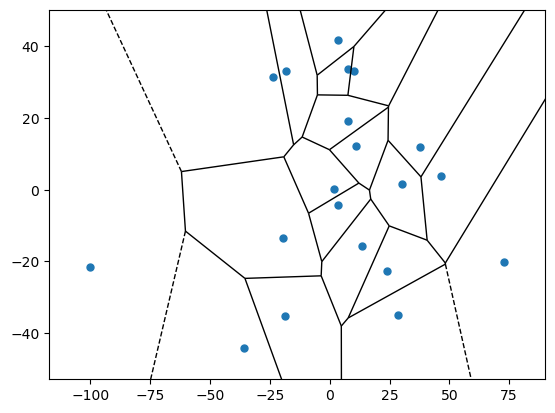

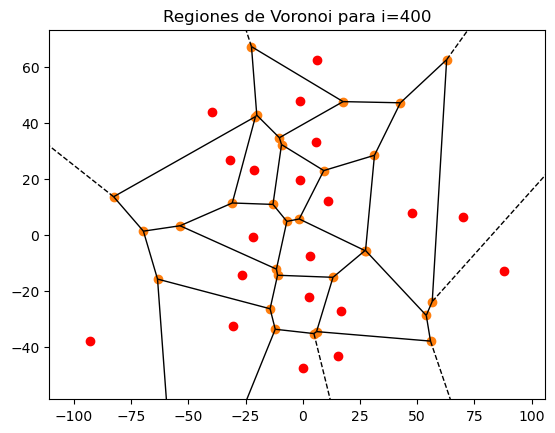

In [77]:
print("inicial es el primer gráfico, final, el segundo")
print("Las funciones objetivos de ambos son: ",objs[0],objs[-1],"respectivamente")
fig = voronoi_plot_2d(inicial,show_vertices=False,point_size=10)
plot_voronoi(vor)


Tras esto se grafican ambos considerando la distribución de casas y puntos de interés de la ciudad.

inicial


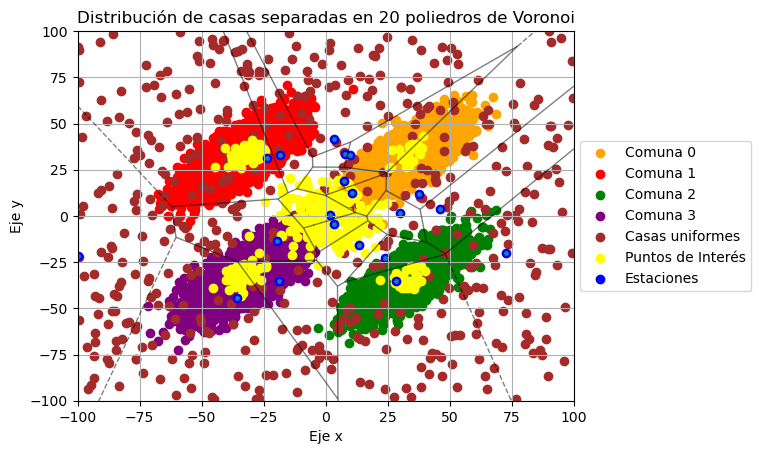

In [78]:
print("inicial")
graficar_todo(inicial,ciud_tot,puntos_de_interes)

final


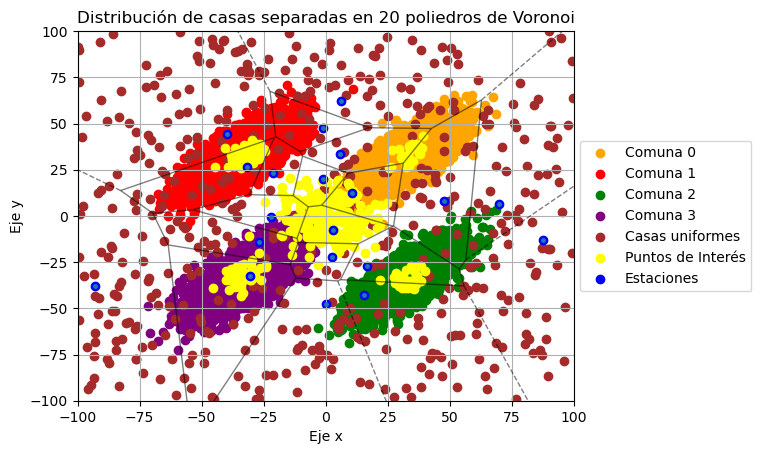

In [79]:
print("final")
graficar_todo(vor,ciud_tot,puntos_de_interes)

Finalmente, para obtener la ruta óptima, se utilizan las funciones del laboratorio 3.

In [80]:

def distancia_ciudades(ciudades): #Calcula la distancia entre ciudades.
    D = np.zeros((N,N),dtype=float)
    for i in range(N):
        for j in range(N):
            D[i,j] = np.linalg.norm(ciudades[i]-ciudades[j])
    return D



In [81]:
from matplotlib.patches import FancyArrowPatch

def arrow(x,y,ax,n): #Una herramienta para visualizar mejor la ruta generada.
    d = len(x)//(n+1)
    ind = np.arange(d,len(x),d)
    for i in ind:
        ar = FancyArrowPatch ((x[i-1],y[i-1]),(x[i],y[i]),
                              arrowstyle='->', mutation_scale=20)
        ax.add_patch(ar)


def recorre(ciudades,sigma): #Dada una permutación de las estaciones indica el camino respectivo a dicha permutación
    N = len(ciudades)
    M = len(sigma)
    assert N == M+1
    X,Y = np.matrix.transpose(ciudades)
    W = np.zeros(N+1)
    Z = np.zeros(N+1)
    W[0] = X[0]
    Z[0] = Y[0]
    for i in range(1,N):
        W[i] = X[sigma[i-1]]
        Z[i] = Y[sigma[i-1]]
    W[N] = W[0]
    Z[N] = Z[0]
    fig, ax = plt.subplots(figsize=(10,7))
    #ciudad inicial
    ax.plot(W[0],Z[0],"X",markersize=15,linestyle = '-', label = "estación " + str(1))
    for i in range(1,N):
        ax.plot(W[i],Z[i],"o",linestyle = '-', label = "estación " + str(i+1))
    #completar el ciclo

    ax.grid()
    ax.set_xlim(-100,100)
    ax.set_ylim(-100,100)
    ax.title.set_text("Trayectoria seleccionada para " + str(N) +" estaciones")
    ax.legend(bbox_to_anchor=(1.1,1.001))
    arrow(W,Z,ax, N-1)


[[-26.70378655 -14.09713913]
 [-30.63477649 -32.31602985]
 [ 70.06712598   6.44058251]
 [-92.7533888  -37.9006358 ]
 [  6.13360449  62.44023056]
 [ 87.82516956 -12.98051884]
 [ 47.60026205   8.07814002]
 [  5.64856619  33.41788833]
 [ 10.86126735  12.28396394]
 [  2.65592514 -22.09181442]
 [-21.11215098  23.24702941]
 [-39.70260791  44.17773827]
 [ -1.21878637  19.77286072]
 [ -1.03805911  47.83868414]
 [-31.61873452  26.69358472]
 [ 15.60136342 -43.06085624]
 [-21.80431977  -0.79188545]
 [ 16.67628347 -27.2832778 ]
 [  0.32082319 -47.66608751]
 [  3.09939526  -7.4285519 ]]


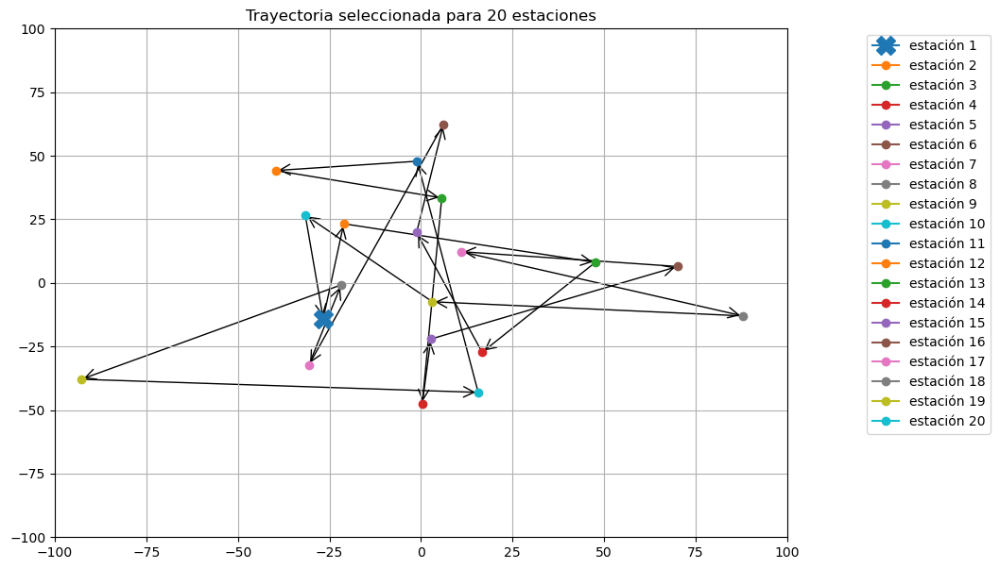

In [82]:
estaciones = vor.points
print(estaciones)
largo = len(estaciones)
sigma = np.random.permutation([i for i in range(1,largo)])
recorre(estaciones,sigma) #Para probar como se ve una ruta dada por alguna permutación.

Tras esto, se ocupa Simulated Annealing para obtener la ruta óptima.

In [83]:

N_markov = 600 #pasos de la cadena de markov
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

sigma_inicial = np.random.default_rng(seed=semilla).permutation([i for i in range(1,N)])
#osc_K(w) <= N*raiz(2), cota
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

def distancia_rec(ciudades,sigma):
    n = len(sigma)
    ciudades_ordenadas_sigma = np.zeros((n,2))
    for j in range(n):
        ciudades_ordenadas_sigma[j] = ciudades[int(sigma[j])]

    distancia =  sum(np.linalg.norm( ciudades_ordenadas_sigma[i] - ciudades_ordenadas_sigma[i+1]) for i in range(0,n-1))
    return distancia


def escoge(n,ciudades,tau,sigma, beta_n):
    osc_tau_sigma = (distancia_rec(ciudades,tau) - distancia_rec(ciudades,sigma))
    Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)
    if Cte_final == 1:
        return tau
    elif Cte_final<1:
        return sigma

def genera_beta_n_enunciado(n):
    return [np.log(i+np.e)/C for i in range(n)]

def generar_tau(sigma):
    n = len(sigma)
    a = np.random.randint(n)
    b = np.random.randint(n)
    tau = sigma.copy()
    (tau[a],tau[b]) = (tau[b],tau[a])
    return tau

def simular_cadena(N_limite, ciudades, estado_inic,beta_n):
    n = len(estado_inic)
    Cadenota = np.zeros((N_limite,n),dtype=int)
    Cadenota[0] = estado_inic
    for i in range(1,N_limite):
        beta_actual = beta_n[i]
        tau = generar_tau(Cadenota[i-1])
        Cadenota[i] = escoge(i, ciudades, tau, Cadenota[i-1],beta_actual)
    return Cadenota



matriz = simular_cadena(N_markov,estaciones,sigma_inicial,beta_n_test)


Graficamos la ruta óptima obtenida para las estaciones:

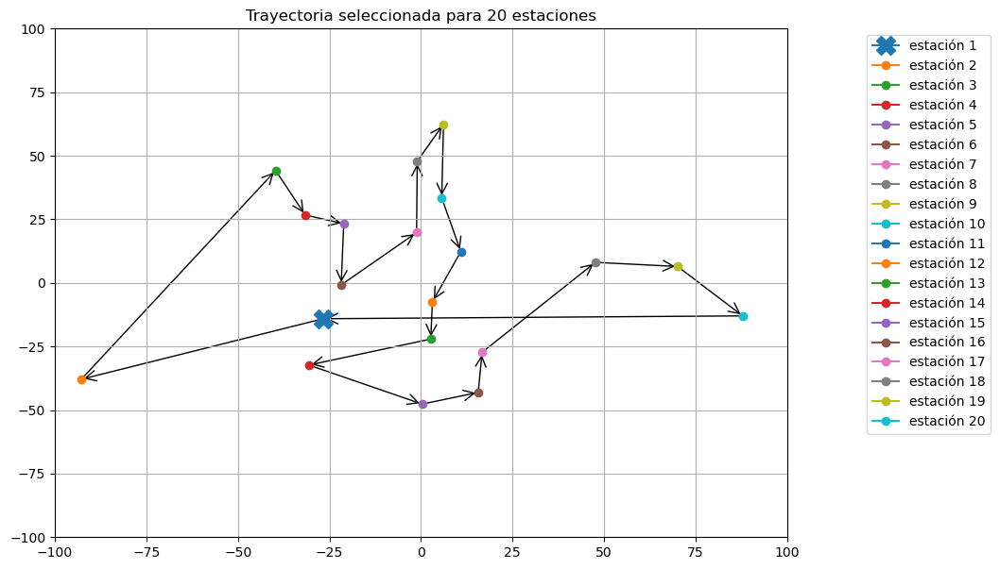

In [84]:
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Y ahora verificamos como evoluciona la cadena con un beta lineal (el ya utilizado), cuadrático y exponencial.

C:\Users\marti\AppData\Local\Temp\ipykernel_21200\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


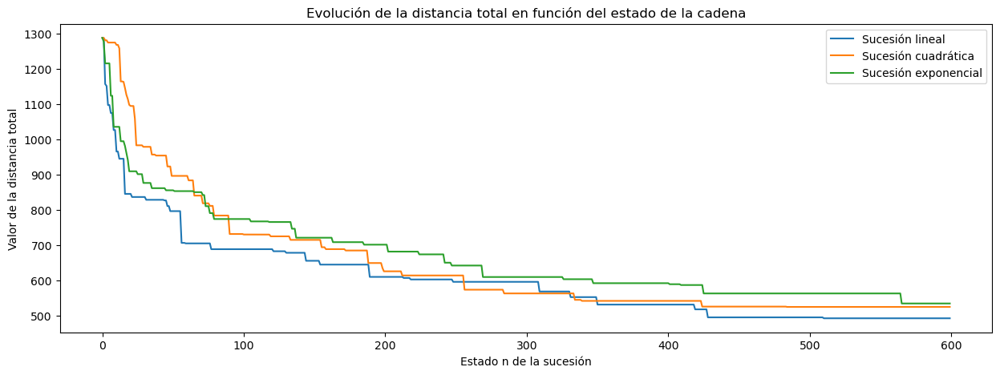

In [85]:
indices = range(N_markov)
#beta_n distintos, desde 1 hasta N (0:N-1)
betas_lineal = [i for i in indices]
betas_quadra = [i**2 for i in indices]
betas_expnen = [np.exp(i) for i in indices]


#genero las cadenas y me kedo con la última para cada beta
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_lineal)
#guardo la distancia
w_lineal = [distancia_rec(estaciones,perm) for perm in Cadena_lineal]
plt.figure(figsize=(15, 5))
plt.plot(indices,w_lineal, label="Sucesión lineal")



Cadena_quadra = simular_cadena(N_markov,estaciones,sigma_inicial,betas_quadra)
w_quadra = [distancia_rec(estaciones,perm) for perm in Cadena_quadra]
plt.plot(indices,w_quadra,label="Sucesión cuadrática")


Cadena_expnen = simular_cadena(N_markov,estaciones,sigma_inicial,betas_expnen)
w_expnen = [distancia_rec(estaciones,perm) for perm in Cadena_expnen]
plt.plot(indices,w_expnen,label="Sucesión exponencial")


plt.title("Evolución de la distancia total en función del estado de la cadena")
plt.ylabel("Valor de la distancia total")
plt.xlabel("Estado n de la sucesión")
plt.legend()
plt.show()

Escogemos el beta cuadrado

C:\Users\marti\AppData\Local\Temp\ipykernel_21200\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


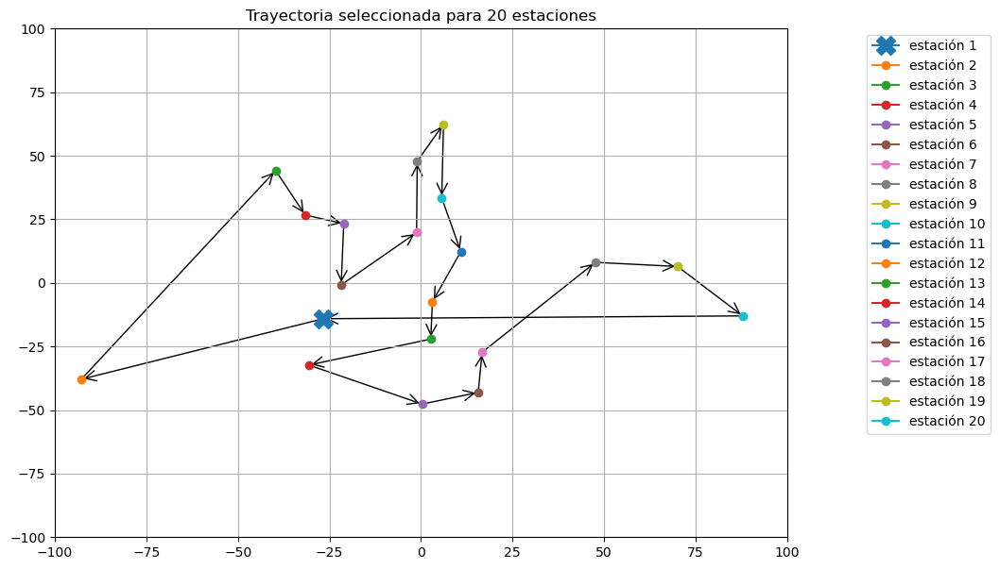

In [86]:
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_quadra)
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Obteniéndose así la ruta óptima de las estaciones encontradas, mediante un beta cuadrático.

Finalmente, se pudo generar una ruta de metro socialmente eficiente, cubriendo las casas y puntos de interés y conectándolas de forma de obtener la ruta cerrada mas corta. Además, el modelo genera algunos problemas, como la distancia entre las estaciones, acumulación de estaciones y viajes que demorarían mas tiempo. Y, por último, la tendencia de las estaciones brinda certeza de la eficiencia del modelo bajos marcos teóricos y redes reales con rutas concéntricas 